In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from collections import deque
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import xml.etree.ElementTree as ET
from torch.utils.data import Dataset, DataLoader, ConcatDataset
from sklearn.metrics import mean_squared_error

In [ ]:
# import glucose_transformer

# from glucose_transformer import (
#     TimeSeriesDataset,
#     TransformerEncoder_version2,
#     TransformerEncoder,
#     load_ohio_series_train,
#     create_population_splits,
#     create_loocv_splits,
#     create_4fold_splits,
#     split_into_continuous_series,
#     create_train_val_datasets,
#     train_model,
#     evaluate_model,
#     evaluate_and_save_metrics_population,
#     evaluate_and_save_metrics,
#     save_model,
#     load_model
# )
%run /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py

# Train on T1DEXI dataset

## population

### data preprocess

In [ ]:
def convert_to_datetime(date_str):
  try:
    return pd.to_datetime(date_str)
  except ValueError:
    return pd.to_datetime(date_str + ' 00:00:00')

In [ ]:
data_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_Dataset/T1DEXI_processed/'

train_df = pd.DataFrame()
test_df = pd.DataFrame()

for file in os.listdir(data_dir):
  if file.endswith('.csv'):
    df = pd.read_csv(os.path.join(data_dir, file))
    # df.drop(columns=['USUBJID'], inplace=True)
    df = df.rename(columns={"LBORRES": "mg/dl", "LBDTC": "timestamp"})
    df['timestamp'] = df['timestamp'].apply(convert_to_datetime)
    df = df.loc[:, ['USUBJID', 'timestamp', 'mg/dl']] # reorder to keep the same format as Diatrend for future training
    num_train = int(len(df) * 0.8)
    cur_train_df = df.iloc[:num_train]
    cur_test_df = df.iloc[num_train:]
    train_df = pd.concat([train_df, cur_train_df])
    test_df = pd.concat([test_df, cur_test_df])
    # break

population_data_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_Dataset/T1DEXI_population/'
train_df.to_csv(os.path.join(population_data_dir, 'T1DEXI_train.csv'), index=False)
test_df.to_csv(os.path.join(population_data_dir, 'T1DEXI_test.csv'), index=False)

In [ ]:
print(train_df.shape, test_df.shape)
train_df.head(3)

(389805, 3) (97482, 3)


,USUBJID,timestamp,mg/dl
0,1,2020-05-11 00:01:17,115.0
1,1,2020-05-11 00:06:17,109.0
2,1,2020-05-11 00:11:17,105.0


### model train

In [ ]:
%run /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py

In [ ]:
population_data_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_Dataset/T1DEXI_population/'

df = pd.read_csv(population_data_dir + 'T1DEXI_train.csv')
df['timestamp'] = pd.to_datetime(df['timestamp'])

In [ ]:
# Move model to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# 4. Set hyperparameters
past_sequence_length = 12
future_offset = 6
batch_size = 64
max_interval_minutes = 30

# 5. Train model
model = TransformerEncoder_version2(
    past_seq_len=past_sequence_length,
    num_layers=1,
    d_model=512,
    nhead=4,
    input_dim=1,
    dropout=0.2
)
model = model.to(device)

# Create datasets
train_series_list = []
for uid in df['USUBJID'].unique():
    cur_df = df[df['USUBJID'] == uid]
    cur_df.drop(columns=['USUBJID'], inplace=True)
    series_list = split_into_continuous_series(cur_df, past_sequence_length, future_offset, max_interval_minutes)
    train_series_list.extend(series_list)

train_dataset, val_dataset = create_train_val_datasets(
    train_series_list,
    train_ratio=0.8,
    past_seq_len=past_sequence_length,
    future_offset=future_offset
)

<ipython-input-40-e894bfc90ef7>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-40-e894bfc90ef7>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-40-e894bfc90ef7>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-40-e894bfc90ef7>:25: SettingWithCopyW

In [ ]:
# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)

# Train model
train_losses, val_losses = train_model(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=200,
    learning_rate=1e-3
)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch [1/200], Train Loss: 3589.247316, Val Loss: 3346.417579
Epoch [6/200], Train Loss: 628.863691, Val Loss: 647.338675
Epoch [11/200], Train Loss: 595.040451, Val Loss: 489.863072
Epoch [16/200], Train Loss: 587.937913, Val Loss: 472.421794
Epoch [21/200], Train Loss: 560.559097, Val Loss: 446.859094
Epoch [26/200], Train Loss: 571.230729, Val Loss: 679.241394
Epoch [31/200], Train Loss: 510.732147, Val Loss: 460.213050
Epoch [36/200], Train Loss: 518.027410, Val Loss: 458.858691
Epoch [41/200], Train Loss: 487.220175, Val Loss: 449.525968
Early stopping triggered


In [ ]:
model_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/'
sh = 'sh'+str(past_sequence_length)

# Save the trained model
save_model(model, 'population_'+sh, save_dir=os.path.join(model_dir, 'saved_models_T1DEXI/'))

Model saved to /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/saved_models_T1DEXI/model_population_sh12.pth


### individaul evaluation

In [ ]:
def evaluate_and_save_metrics_T1DEXI(model, test_df, save_dir="metrics",
                            past_sequence_length=7, future_offset=6,
                            batch_size=32, max_interval_minutes=30):
    """
    Evaluate model performance on test data and save metrics to file.

    Args:
        model: The trained model
        save_dir: Directory to save metrics
        past_sequence_length: Length of input sequence
        future_offset: Prediction horizon
        batch_size: Batch size for testing
        max_interval_minutes: Maximum interval between readings to consider continuous
    """
    # Create save directory if it doesn't exist
    os.makedirs(save_dir, exist_ok=True)

    # Split into continuous series
    test_series_list = split_into_continuous_series(test_df, past_sequence_length, future_offset,max_interval_minutes)

    # Create dataset and dataloader
    test_dataset, _ = create_train_val_datasets(
        test_series_list,
        train_ratio=0.99,
        past_seq_len=past_sequence_length,
        future_offset=future_offset
    )
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

    # Evaluate model
    model.eval()
    predictions = []
    ground_truths = []

    with torch.no_grad():
        for inputs, targets in test_loader:
            inputs = inputs.to('cuda') if torch.cuda.is_available() else inputs
            targets = targets.to('cuda') if torch.cuda.is_available() else targets

            outputs = model(inputs)
            predictions.extend(outputs.cpu().numpy())
            ground_truths.extend(targets.cpu().numpy())

    # Convert to numpy arrays
    predictions = np.array(predictions).flatten()
    ground_truths = np.array(ground_truths).flatten()

    # Calculate metrics
    rmse = np.sqrt(mean_squared_error(ground_truths, predictions))
    mae = np.mean(np.abs(predictions - ground_truths))
    mape = np.mean(np.abs((ground_truths - predictions) / ground_truths)) * 100

    # Print metrics
    print(f'Test file: {uid}')
    print(f'Root Mean Square Error (RMSE): {rmse:.2f}')
    print(f'Mean Absolute Error (MAE): {mae:.2f}')
    print(f'Mean Absolute Percentage Error (MAPE): {mape:.2f}%')

    # Save metrics to file
    metrics_filename = f"metrics_{uid}.txt"
    metrics_path = os.path.join(save_dir, metrics_filename)

    with open(metrics_path, 'w') as f:
        f.write(f"Test File: {uid}\n")
        f.write(f"RMSE: {rmse:.2f}\n")
        f.write(f"MAE: {mae:.2f}\n")
        f.write(f"MAPE: {mape:.2f}%\n")

    # Create plots
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.plot(predictions[:200], label='Predictions', color='r')
    plt.plot(ground_truths[:200], label='Ground Truth', color='b')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title('Predictions vs Ground Truth')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.scatter(ground_truths, predictions, alpha=0.5)
    plt.plot([min(ground_truths), max(ground_truths)],
             [min(ground_truths), max(ground_truths)],
             'r--', label='Perfect Prediction')
    plt.xlabel('Ground Truth')
    plt.ylabel('Predictions')
    plt.title(f'Scatter Plot (RMSE: {rmse:.2f})')
    plt.legend()

    plt.tight_layout()
    plt.show()

    return {
        'rmse': rmse,
        'mae': mae,
        'mape': mape,
        'predictions': predictions,
        'ground_truths': ground_truths
    }

/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py:762: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  mod

Model loaded from /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/saved_models_T1DEXI/model_population_sh12.pth
Test file: 1
Root Mean Square Error (RMSE): 30.93
Mean Absolute Error (MAE): 21.56
Mean Absolute Percentage Error (MAPE): 17.17%


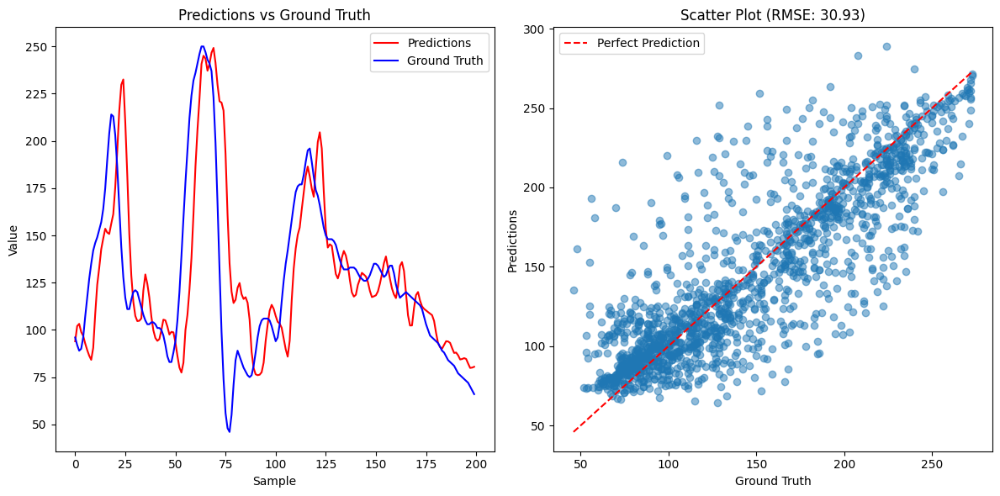

RMSE: 30.93
MAE: 21.56
MAPE: 17.17%
Test file: 1010
Root Mean Square Error (RMSE): 25.91
Mean Absolute Error (MAE): 17.90
Mean Absolute Percentage Error (MAPE): 17.20%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


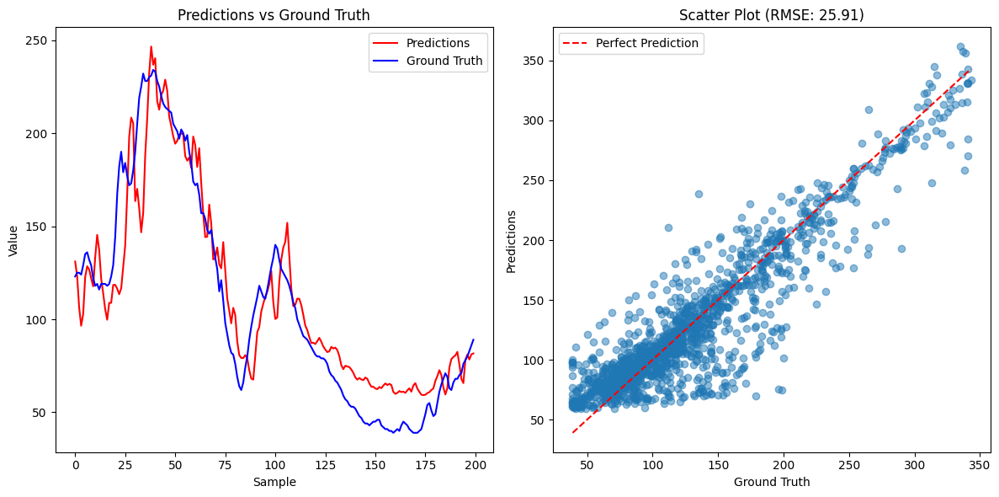

RMSE: 25.91
MAE: 17.90
MAPE: 17.20%
Test file: 1015
Root Mean Square Error (RMSE): 14.78
Mean Absolute Error (MAE): 10.97
Mean Absolute Percentage Error (MAPE): 7.28%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


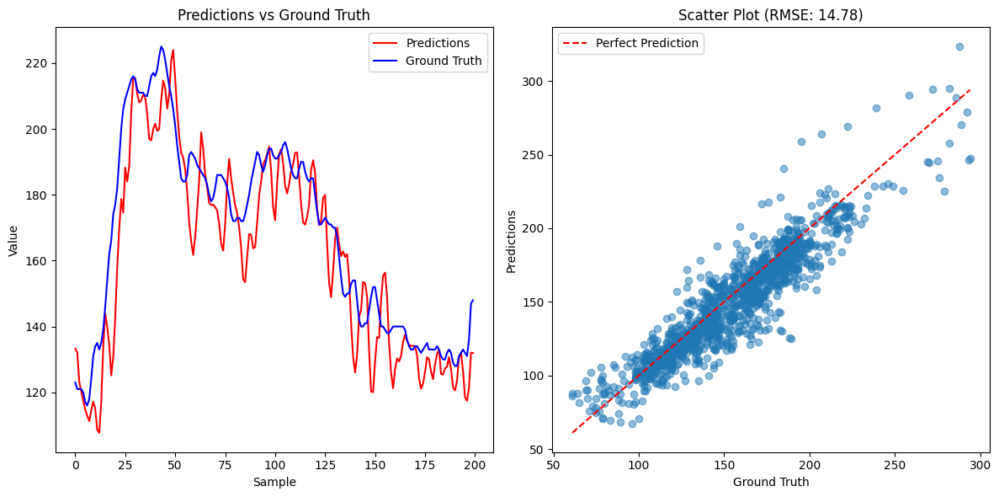

RMSE: 14.78
MAE: 10.97
MAPE: 7.28%
Test file: 103
Root Mean Square Error (RMSE): 14.82
Mean Absolute Error (MAE): 10.31
Mean Absolute Percentage Error (MAPE): 8.04%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


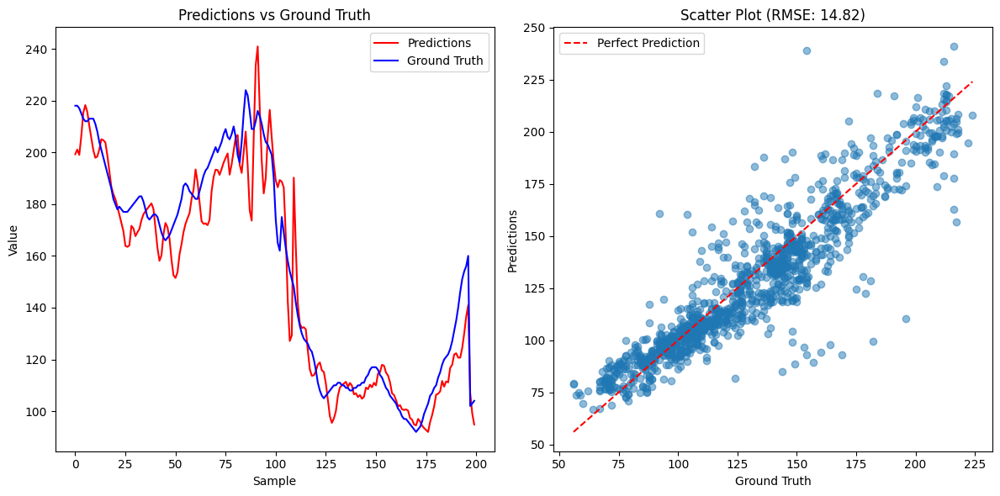

RMSE: 14.82
MAE: 10.31
MAPE: 8.04%
Test file: 1043
Root Mean Square Error (RMSE): 23.04
Mean Absolute Error (MAE): 15.57
Mean Absolute Percentage Error (MAPE): 11.70%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


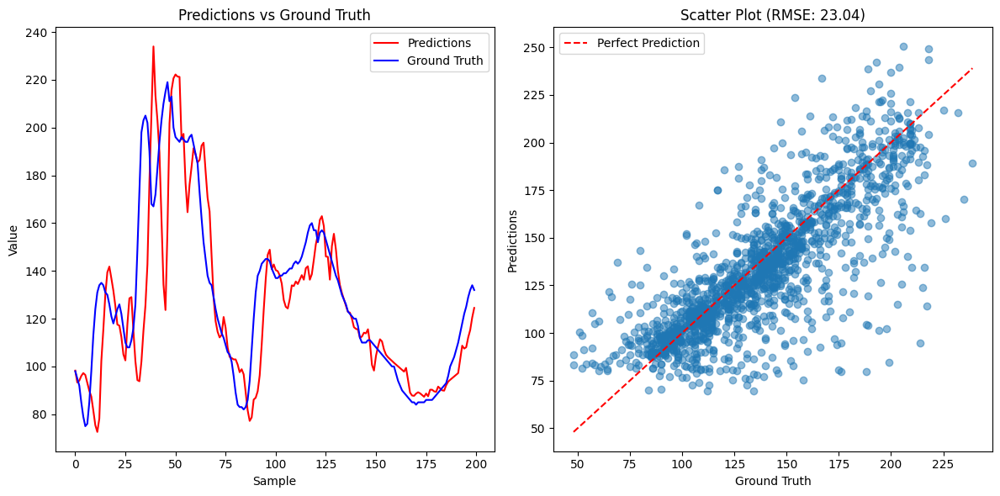

RMSE: 23.04
MAE: 15.57
MAPE: 11.70%
Test file: 1082
Root Mean Square Error (RMSE): 20.30
Mean Absolute Error (MAE): 14.34
Mean Absolute Percentage Error (MAPE): 12.54%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


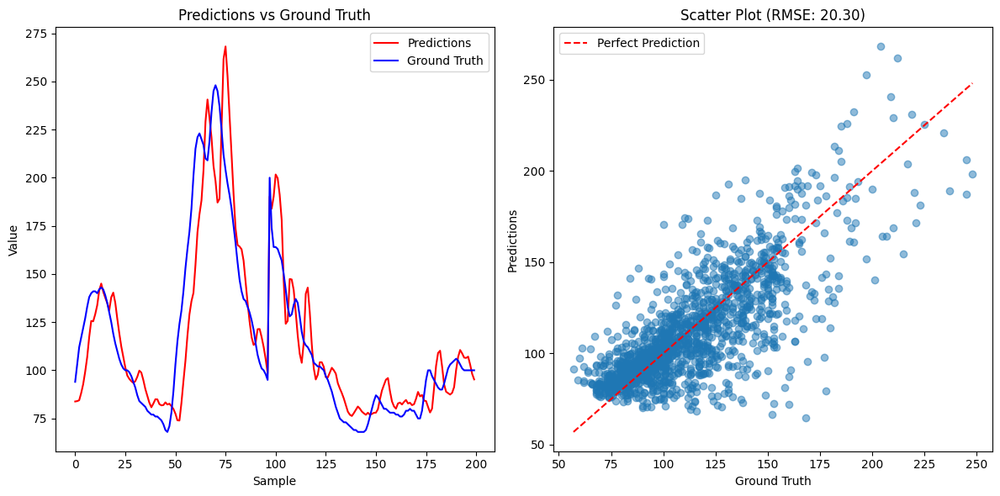

RMSE: 20.30
MAE: 14.34
MAPE: 12.54%
Test file: 11
Root Mean Square Error (RMSE): 14.74
Mean Absolute Error (MAE): 11.27
Mean Absolute Percentage Error (MAPE): 11.82%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


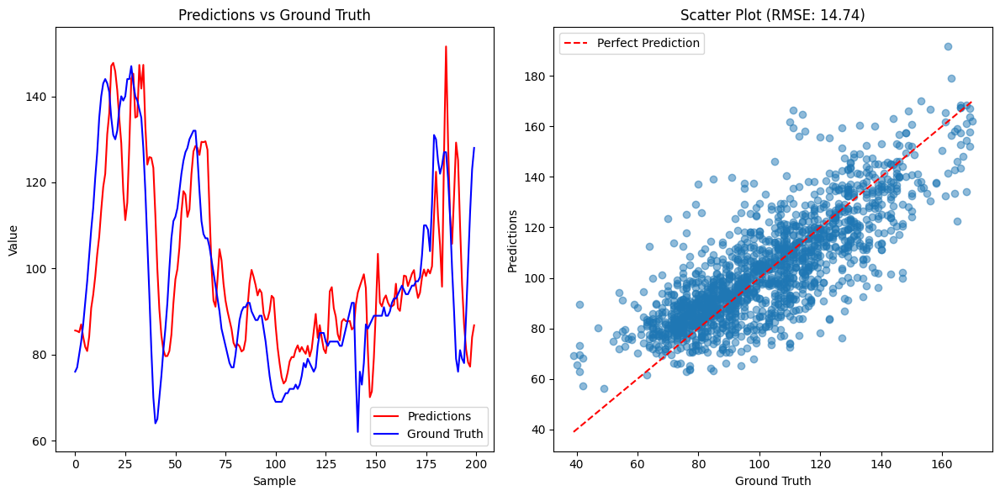

RMSE: 14.74
MAE: 11.27
MAPE: 11.82%
Test file: 1115
Root Mean Square Error (RMSE): 20.15
Mean Absolute Error (MAE): 14.61
Mean Absolute Percentage Error (MAPE): 6.43%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


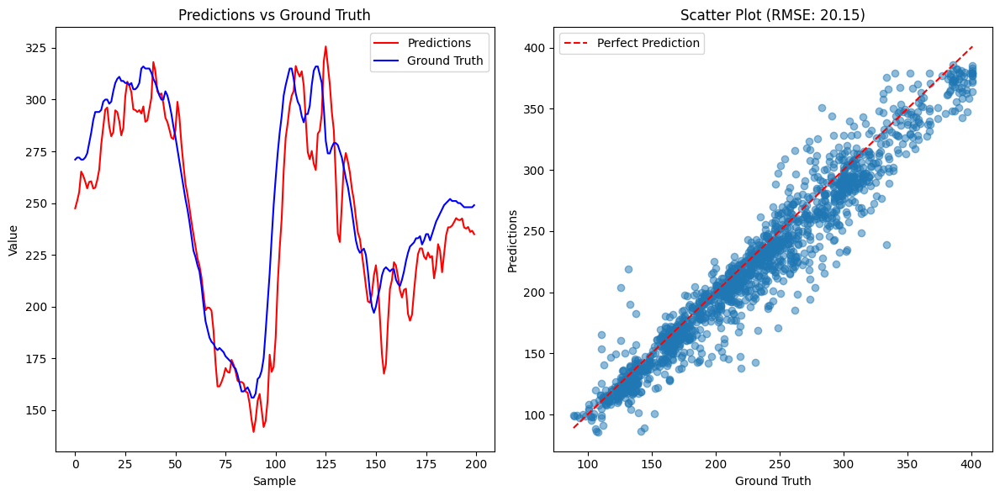

RMSE: 20.15
MAE: 14.61
MAPE: 6.43%
Test file: 1121
Root Mean Square Error (RMSE): 25.19
Mean Absolute Error (MAE): 19.23
Mean Absolute Percentage Error (MAPE): 17.49%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


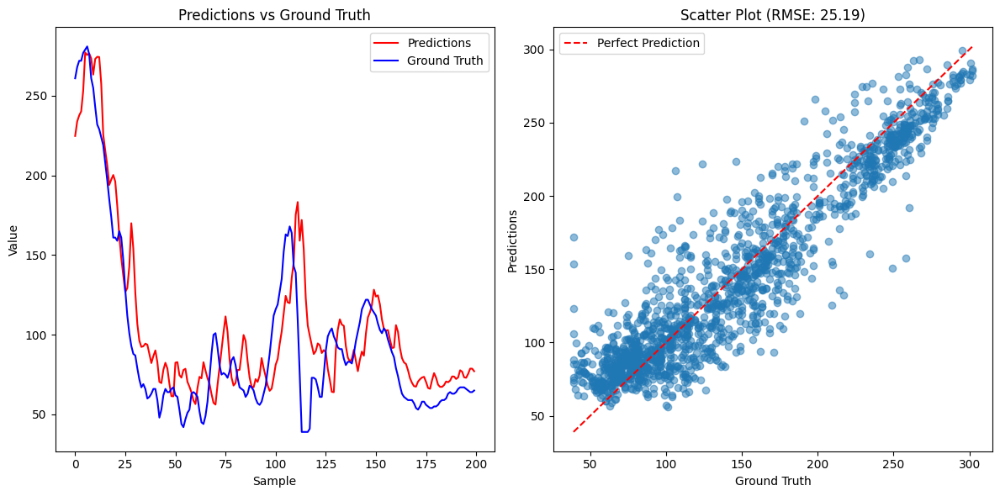

RMSE: 25.19
MAE: 19.23
MAPE: 17.49%
Test file: 1139
Root Mean Square Error (RMSE): 20.86
Mean Absolute Error (MAE): 15.12
Mean Absolute Percentage Error (MAPE): 9.78%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


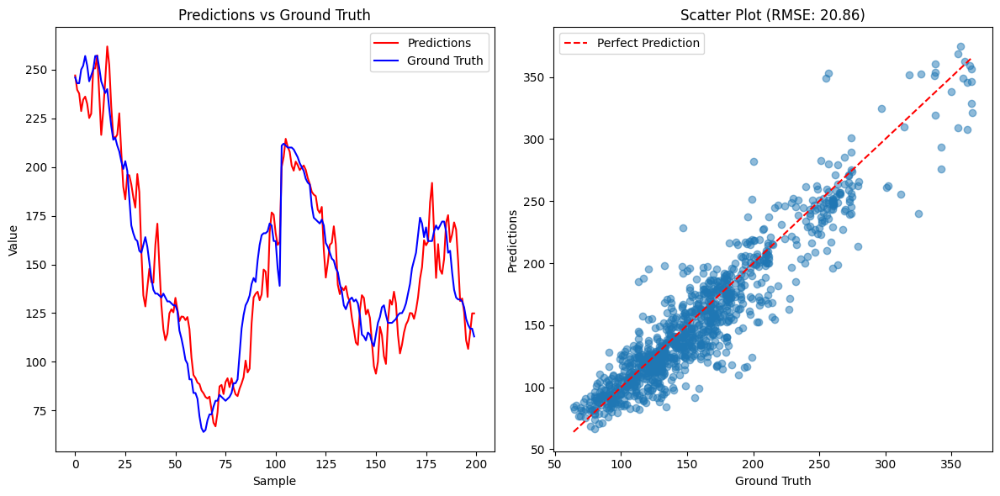

RMSE: 20.86
MAE: 15.12
MAPE: 9.78%
Test file: 114
Root Mean Square Error (RMSE): 21.12
Mean Absolute Error (MAE): 15.15
Mean Absolute Percentage Error (MAPE): 9.78%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


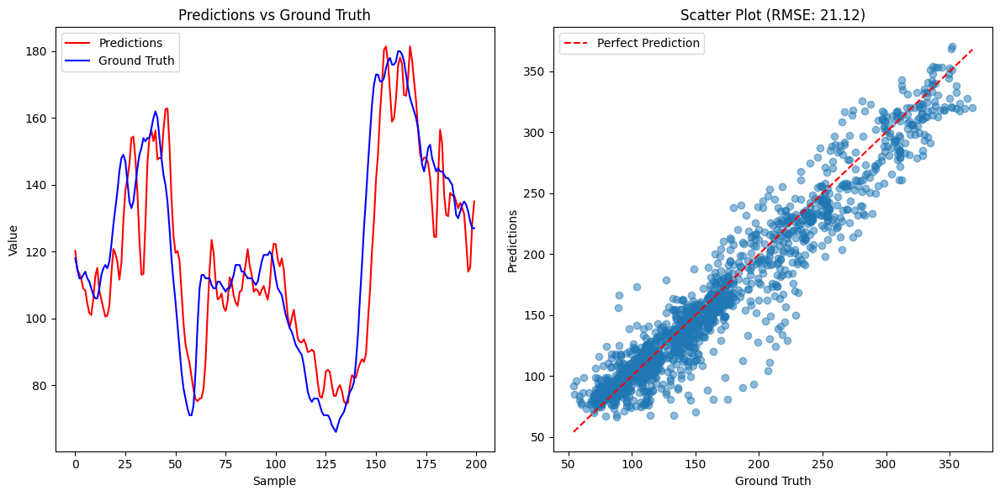

RMSE: 21.12
MAE: 15.15
MAPE: 9.78%
Test file: 1127
Root Mean Square Error (RMSE): 19.93
Mean Absolute Error (MAE): 14.64
Mean Absolute Percentage Error (MAPE): 11.92%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


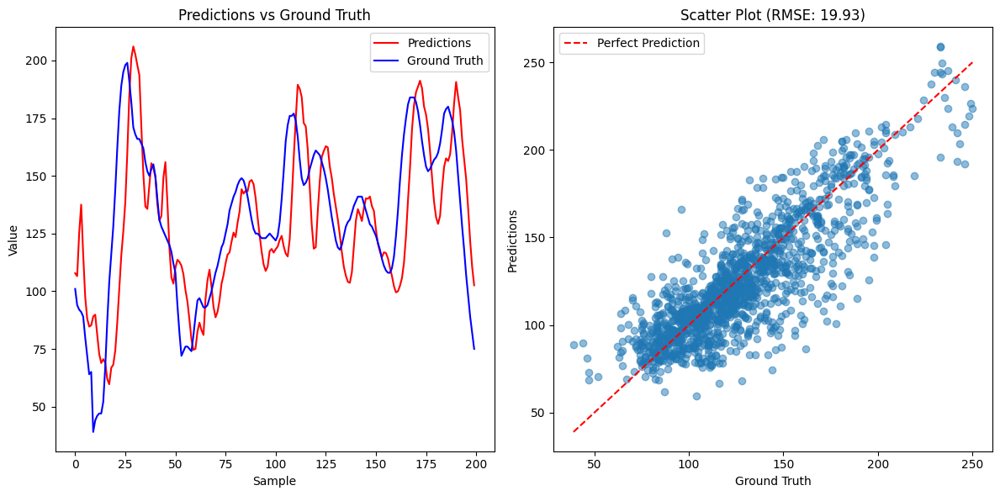

RMSE: 19.93
MAE: 14.64
MAPE: 11.92%
Test file: 1143
Root Mean Square Error (RMSE): 20.25
Mean Absolute Error (MAE): 14.18
Mean Absolute Percentage Error (MAPE): 8.67%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


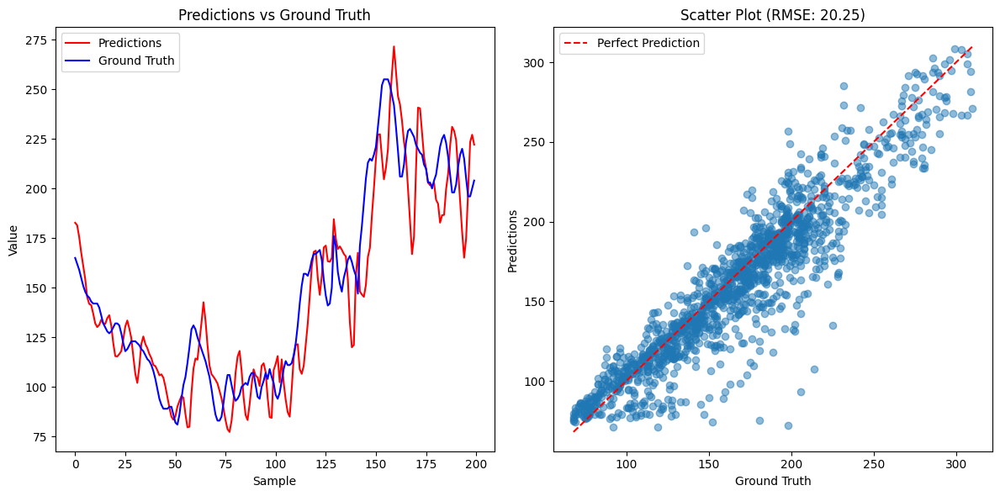

RMSE: 20.25
MAE: 14.18
MAPE: 8.67%
Test file: 115
Root Mean Square Error (RMSE): 25.25
Mean Absolute Error (MAE): 18.87
Mean Absolute Percentage Error (MAPE): 13.71%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


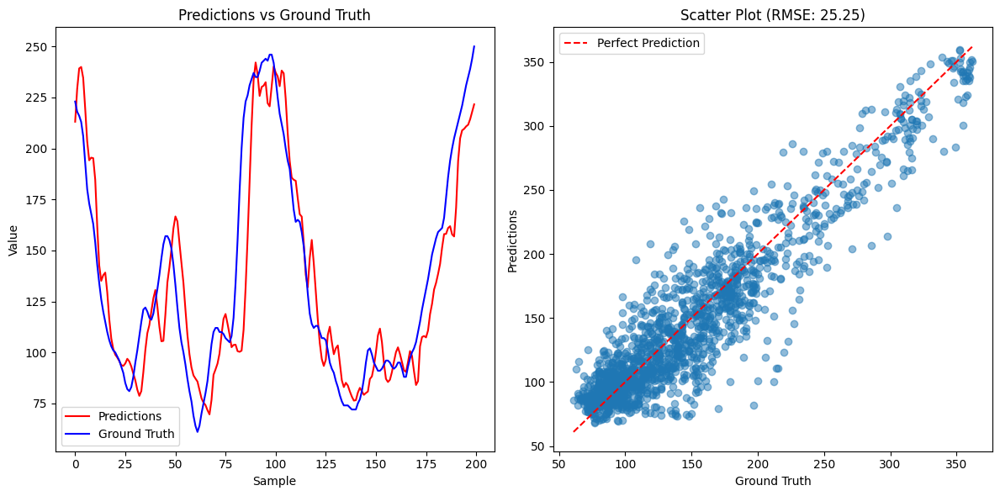

RMSE: 25.25
MAE: 18.87
MAPE: 13.71%
Test file: 1171
Root Mean Square Error (RMSE): 21.68
Mean Absolute Error (MAE): 16.20
Mean Absolute Percentage Error (MAPE): 12.82%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


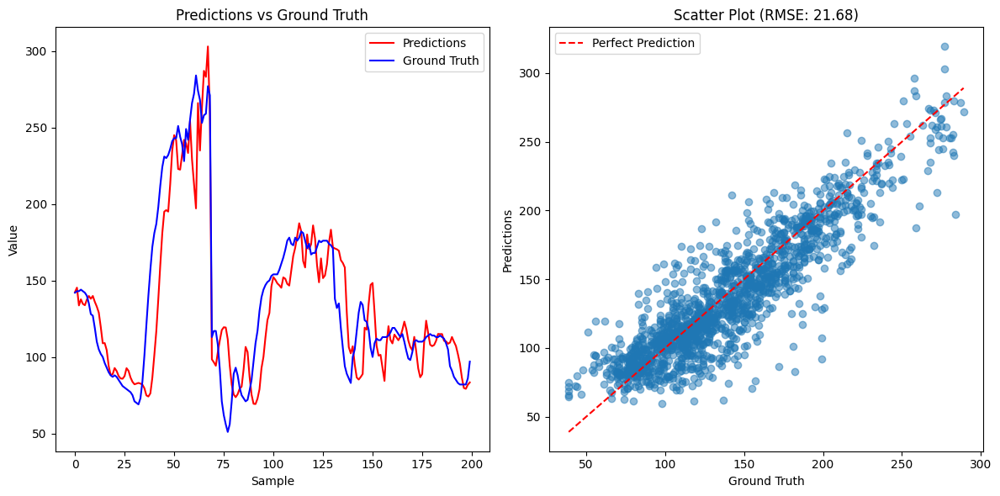

RMSE: 21.68
MAE: 16.20
MAPE: 12.82%
Test file: 1194
Root Mean Square Error (RMSE): 12.91
Mean Absolute Error (MAE): 9.37
Mean Absolute Percentage Error (MAPE): 7.06%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


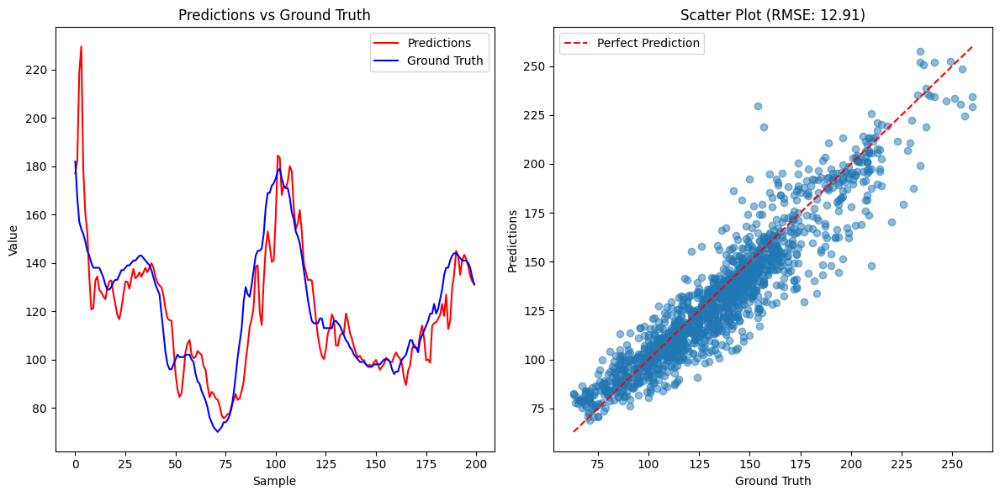

RMSE: 12.91
MAE: 9.37
MAPE: 7.06%
Test file: 1201
Root Mean Square Error (RMSE): 20.31
Mean Absolute Error (MAE): 14.35
Mean Absolute Percentage Error (MAPE): 11.81%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


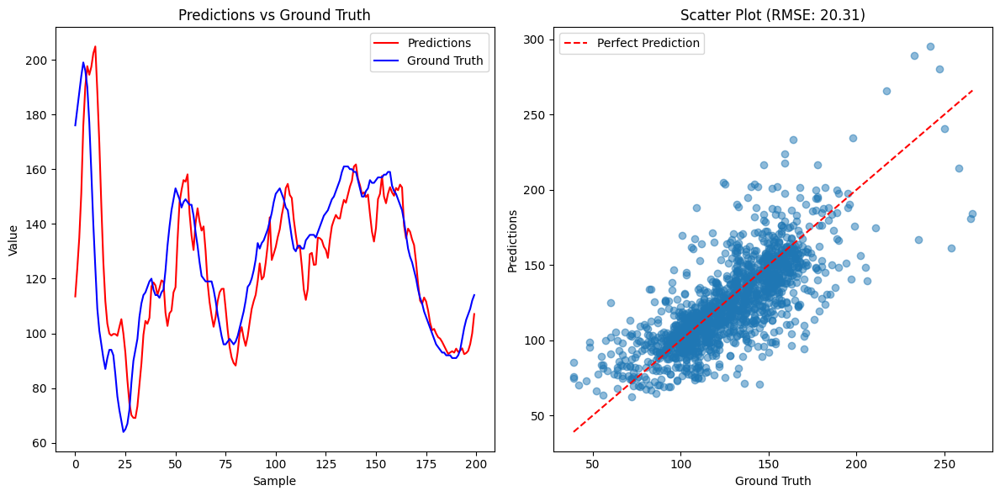

RMSE: 20.31
MAE: 14.35
MAPE: 11.81%
Test file: 1205
Root Mean Square Error (RMSE): 22.08
Mean Absolute Error (MAE): 15.90
Mean Absolute Percentage Error (MAPE): 10.82%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


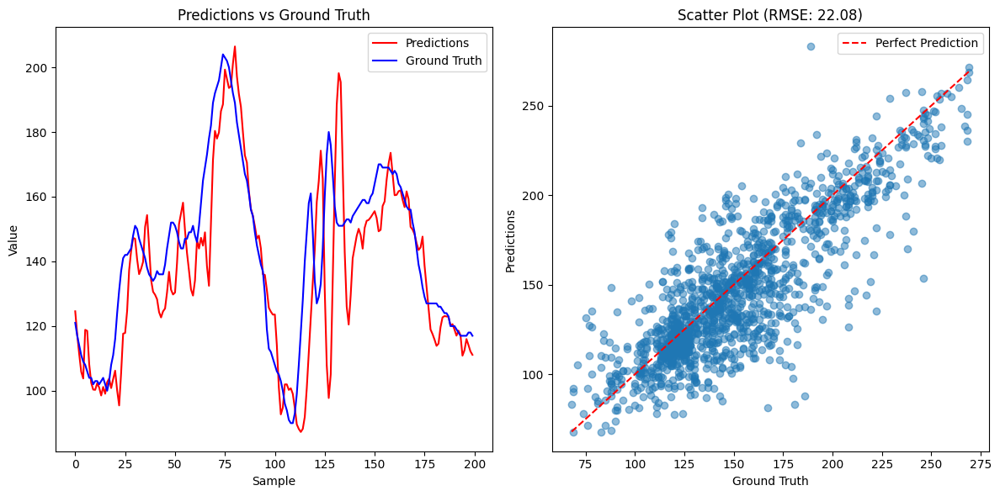

RMSE: 22.08
MAE: 15.90
MAPE: 10.82%
Test file: 1211
Root Mean Square Error (RMSE): 25.63
Mean Absolute Error (MAE): 17.40
Mean Absolute Percentage Error (MAPE): 11.93%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


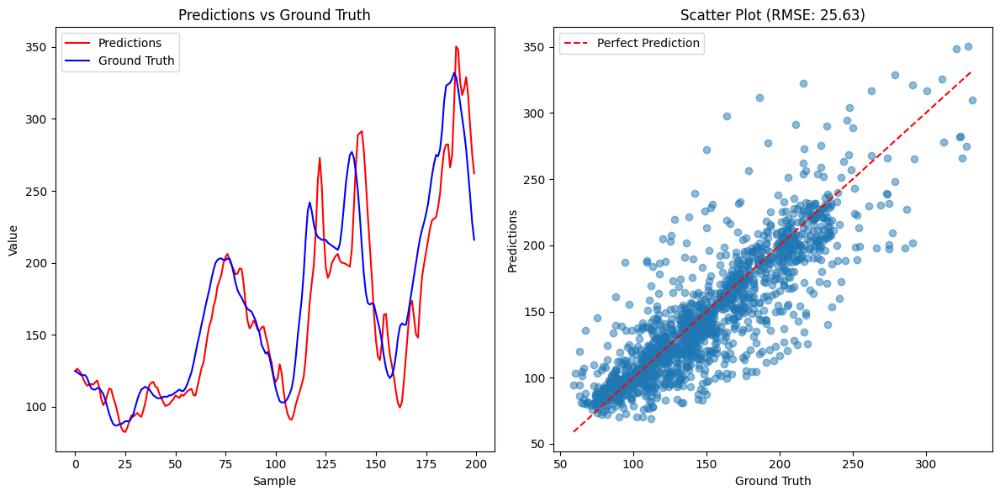

RMSE: 25.63
MAE: 17.40
MAPE: 11.93%
Test file: 1219
Root Mean Square Error (RMSE): 18.62
Mean Absolute Error (MAE): 13.06
Mean Absolute Percentage Error (MAPE): 10.48%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


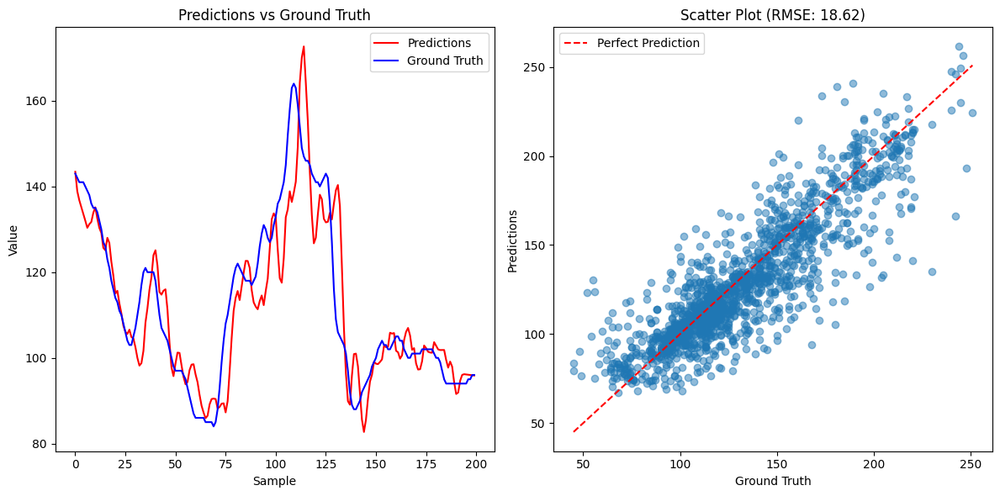

RMSE: 18.62
MAE: 13.06
MAPE: 10.48%
Test file: 1230
Root Mean Square Error (RMSE): 19.60
Mean Absolute Error (MAE): 14.37
Mean Absolute Percentage Error (MAPE): 12.33%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


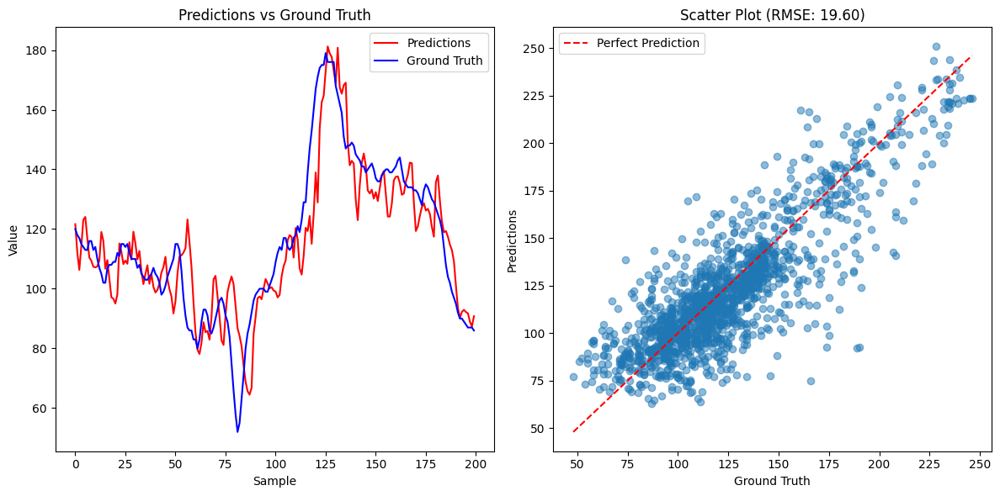

RMSE: 19.60
MAE: 14.37
MAPE: 12.33%
Test file: 1239
Root Mean Square Error (RMSE): 18.83
Mean Absolute Error (MAE): 14.04
Mean Absolute Percentage Error (MAPE): 10.18%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


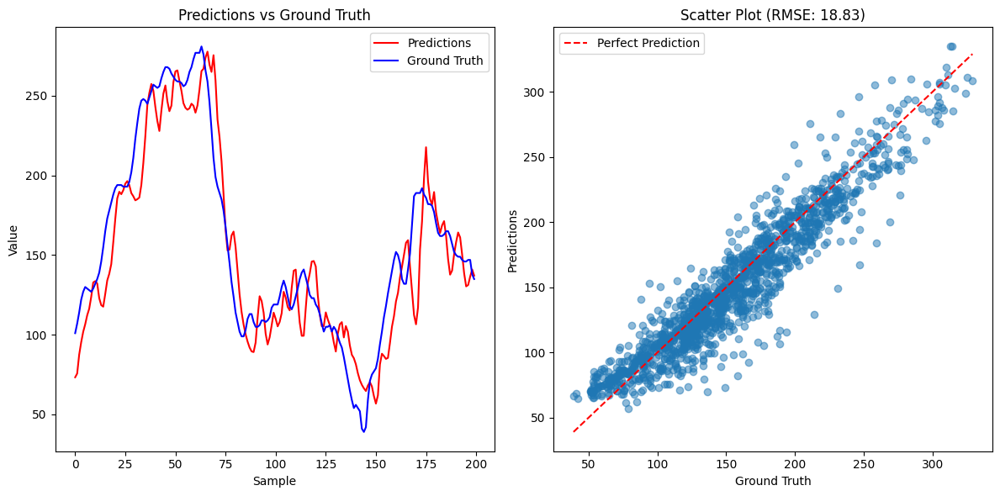

RMSE: 18.83
MAE: 14.04
MAPE: 10.18%
Test file: 1271
Root Mean Square Error (RMSE): 24.30
Mean Absolute Error (MAE): 18.40
Mean Absolute Percentage Error (MAPE): 12.36%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


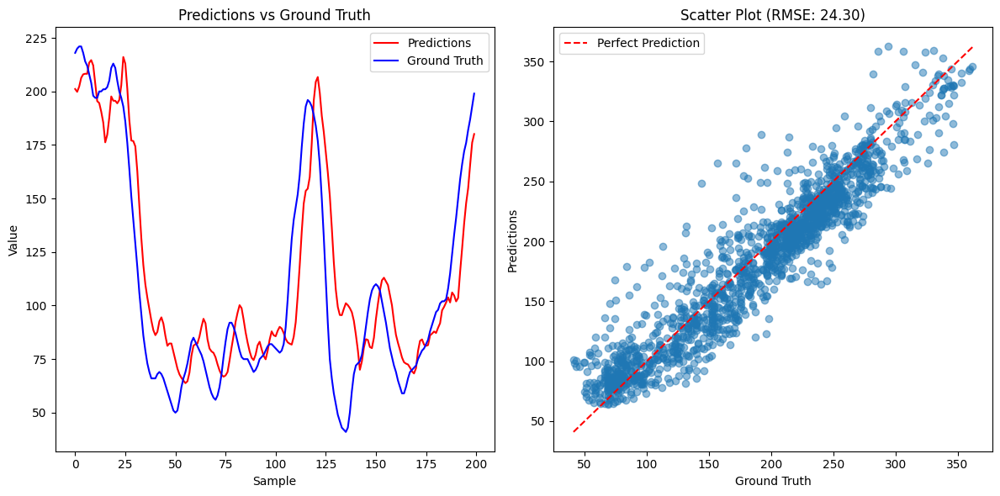

RMSE: 24.30
MAE: 18.40
MAPE: 12.36%
Test file: 1286
Root Mean Square Error (RMSE): 12.73
Mean Absolute Error (MAE): 9.07
Mean Absolute Percentage Error (MAPE): 7.11%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


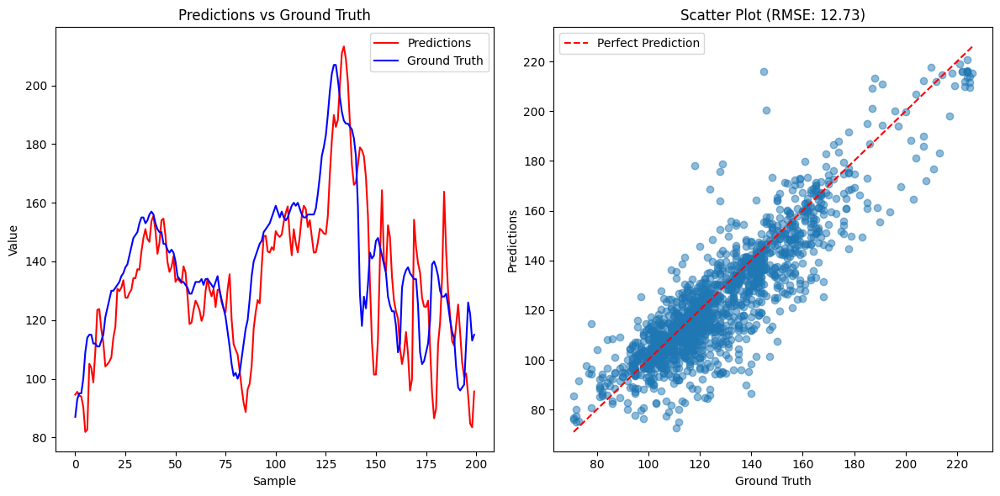

RMSE: 12.73
MAE: 9.07
MAPE: 7.11%
Test file: 1311
Root Mean Square Error (RMSE): 20.90
Mean Absolute Error (MAE): 14.53
Mean Absolute Percentage Error (MAPE): 11.69%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


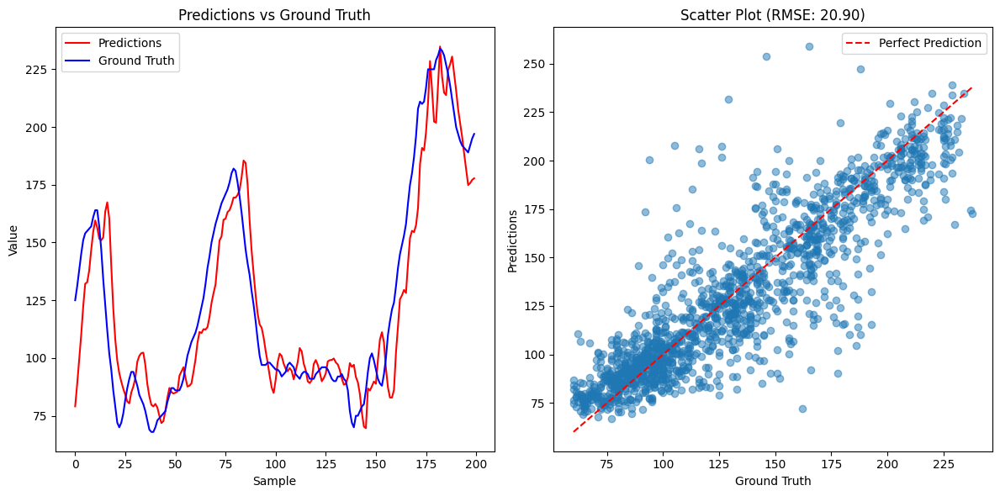

RMSE: 20.90
MAE: 14.53
MAPE: 11.69%
Test file: 1330
Root Mean Square Error (RMSE): 22.28
Mean Absolute Error (MAE): 15.77
Mean Absolute Percentage Error (MAPE): 11.57%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


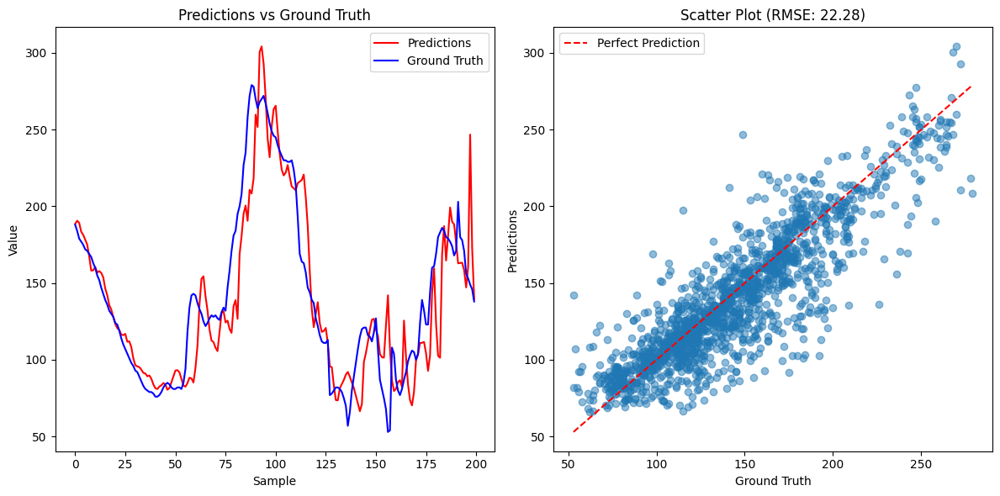

RMSE: 22.28
MAE: 15.77
MAPE: 11.57%
Test file: 1336
Root Mean Square Error (RMSE): 28.53
Mean Absolute Error (MAE): 20.46
Mean Absolute Percentage Error (MAPE): 16.16%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


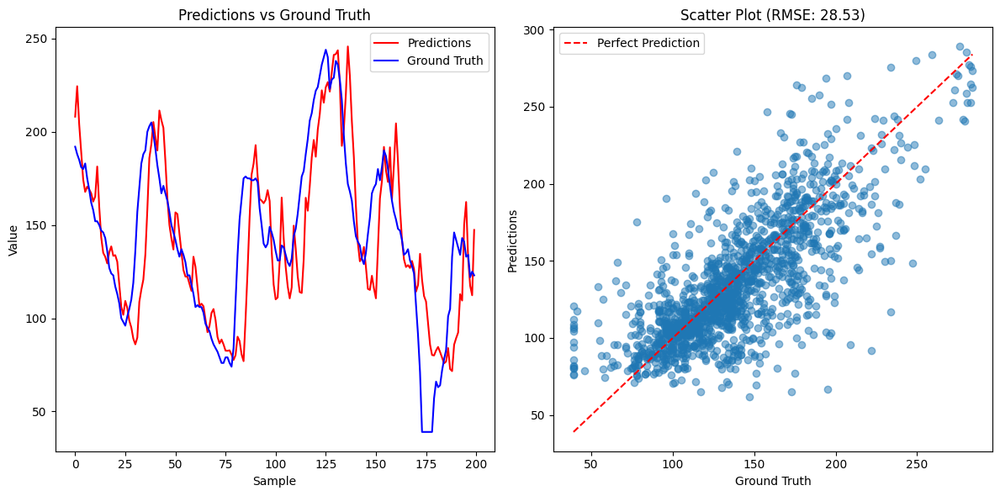

RMSE: 28.53
MAE: 20.46
MAPE: 16.16%
Test file: 1343
Root Mean Square Error (RMSE): 13.43
Mean Absolute Error (MAE): 8.65
Mean Absolute Percentage Error (MAPE): 7.96%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


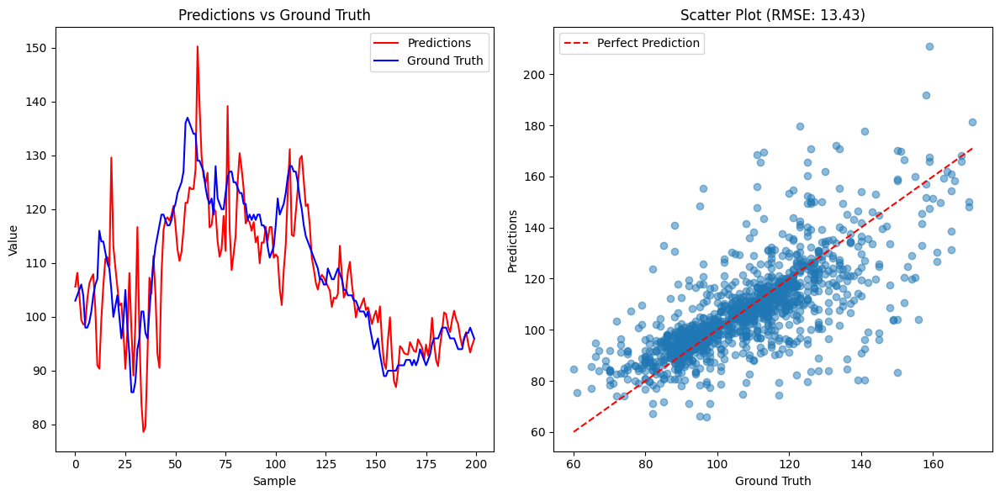

RMSE: 13.43
MAE: 8.65
MAPE: 7.96%
Test file: 1345
Root Mean Square Error (RMSE): 21.10
Mean Absolute Error (MAE): 15.72
Mean Absolute Percentage Error (MAPE): 12.54%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


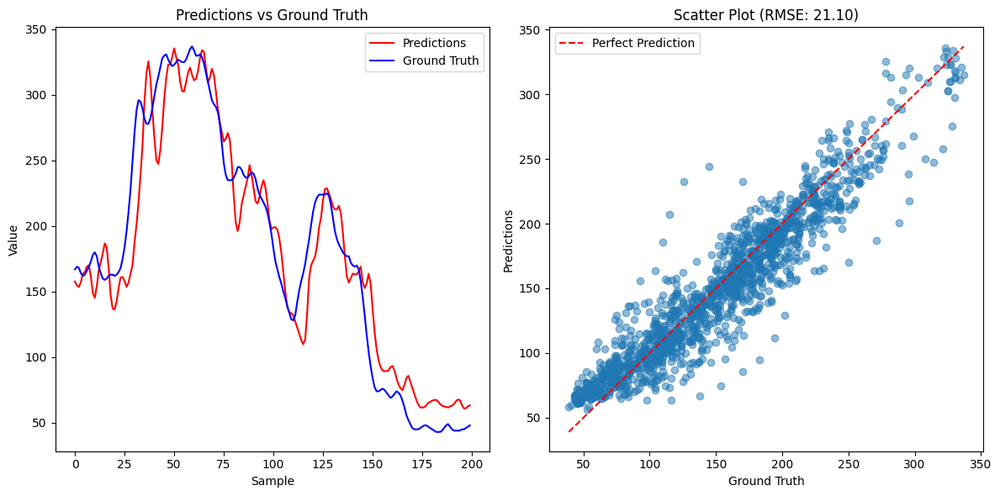

RMSE: 21.10
MAE: 15.72
MAPE: 12.54%
Test file: 1348
Root Mean Square Error (RMSE): 37.65
Mean Absolute Error (MAE): 25.72
Mean Absolute Percentage Error (MAPE): 14.73%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


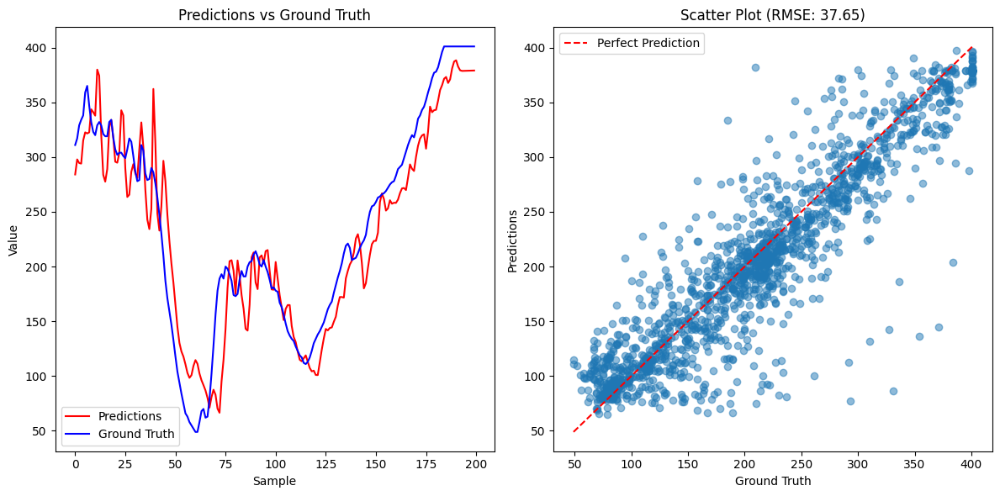

RMSE: 37.65
MAE: 25.72
MAPE: 14.73%
Test file: 1361
Root Mean Square Error (RMSE): 19.43
Mean Absolute Error (MAE): 14.53
Mean Absolute Percentage Error (MAPE): 14.94%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


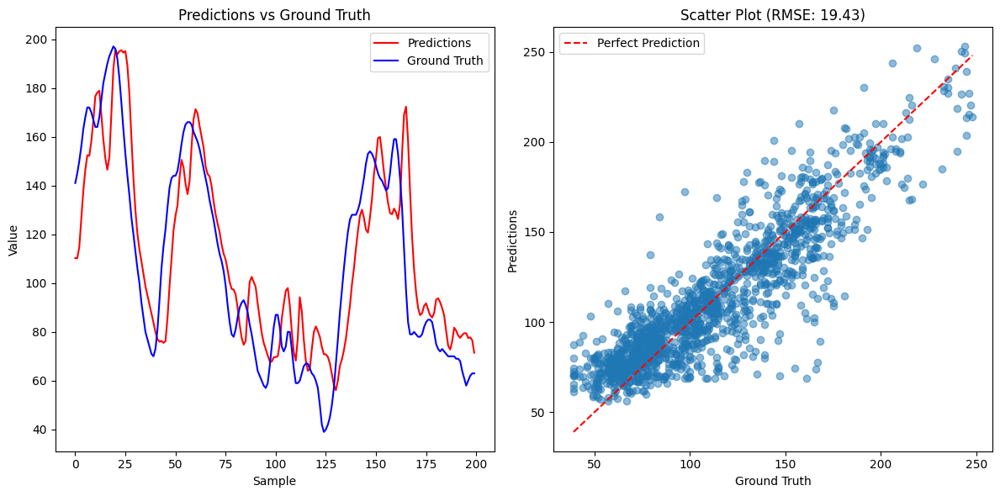

RMSE: 19.43
MAE: 14.53
MAPE: 14.94%
Test file: 1362
Root Mean Square Error (RMSE): 18.79
Mean Absolute Error (MAE): 13.49
Mean Absolute Percentage Error (MAPE): 11.70%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


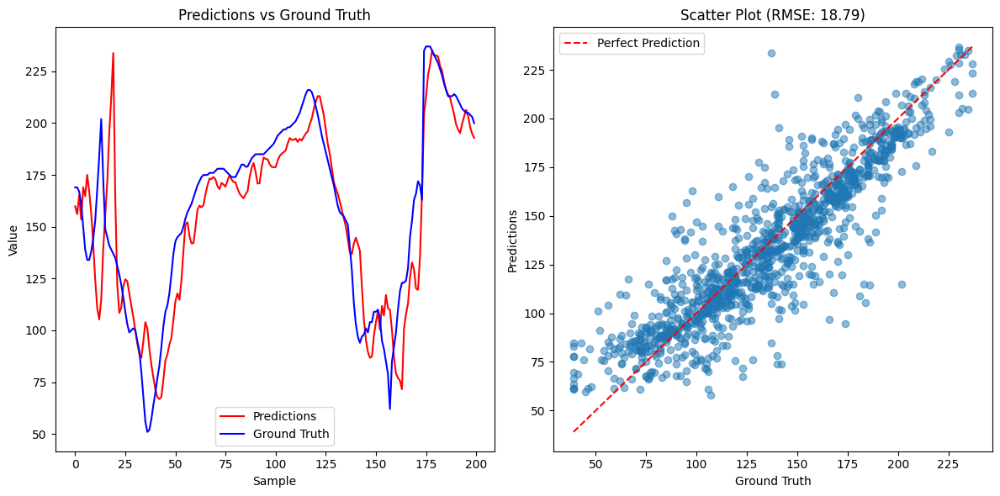

RMSE: 18.79
MAE: 13.49
MAPE: 11.70%
Test file: 1363
Root Mean Square Error (RMSE): 23.24
Mean Absolute Error (MAE): 16.40
Mean Absolute Percentage Error (MAPE): 11.09%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


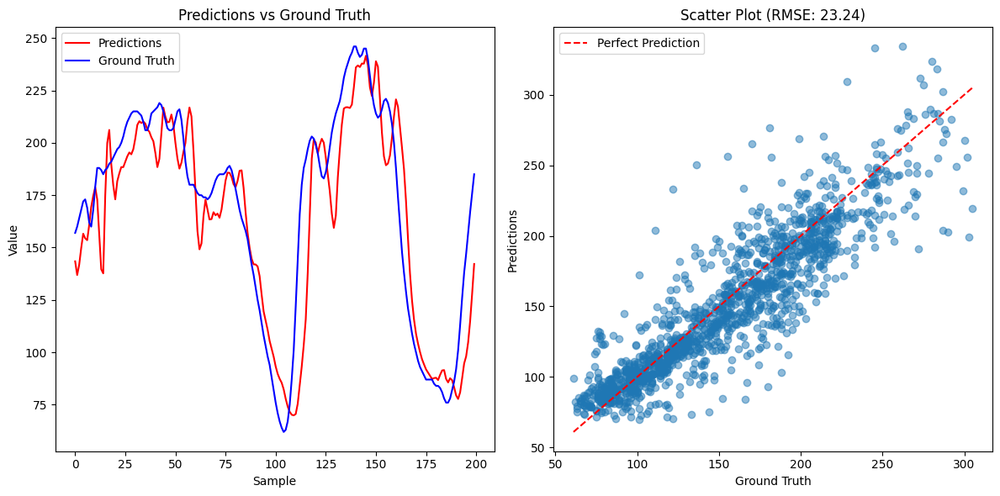

RMSE: 23.24
MAE: 16.40
MAPE: 11.09%
Test file: 1377
Root Mean Square Error (RMSE): 17.92
Mean Absolute Error (MAE): 13.23
Mean Absolute Percentage Error (MAPE): 10.29%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


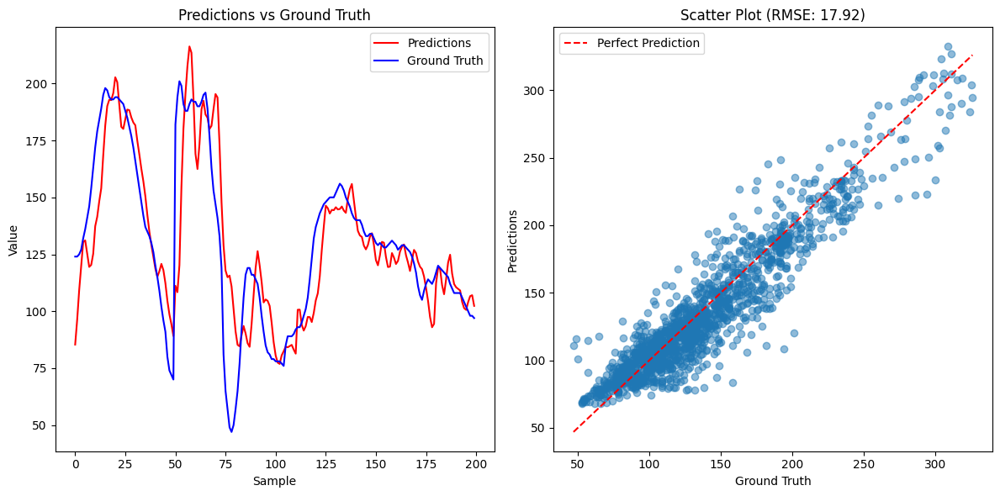

RMSE: 17.92
MAE: 13.23
MAPE: 10.29%
Test file: 1381
Root Mean Square Error (RMSE): 16.32
Mean Absolute Error (MAE): 11.71
Mean Absolute Percentage Error (MAPE): 9.09%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


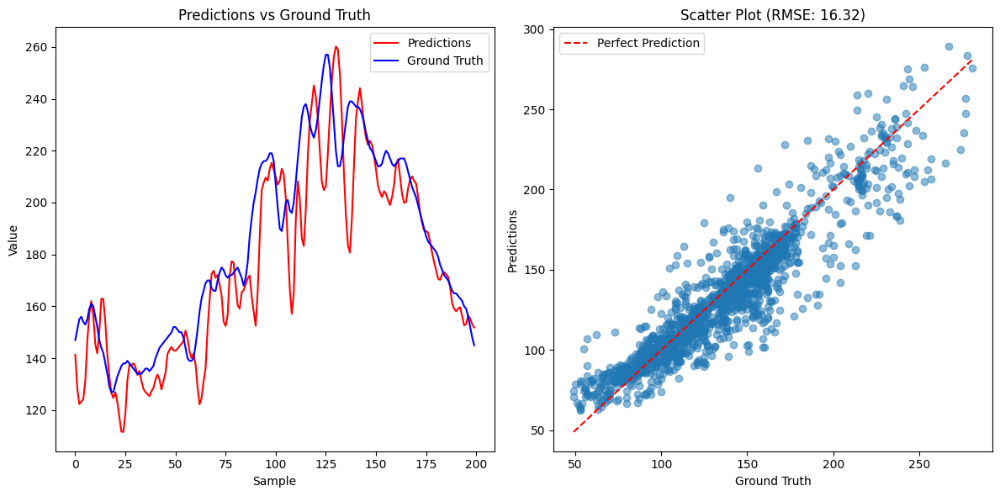

RMSE: 16.32
MAE: 11.71
MAPE: 9.09%
Test file: 1386
Root Mean Square Error (RMSE): 22.99
Mean Absolute Error (MAE): 16.30
Mean Absolute Percentage Error (MAPE): 14.26%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


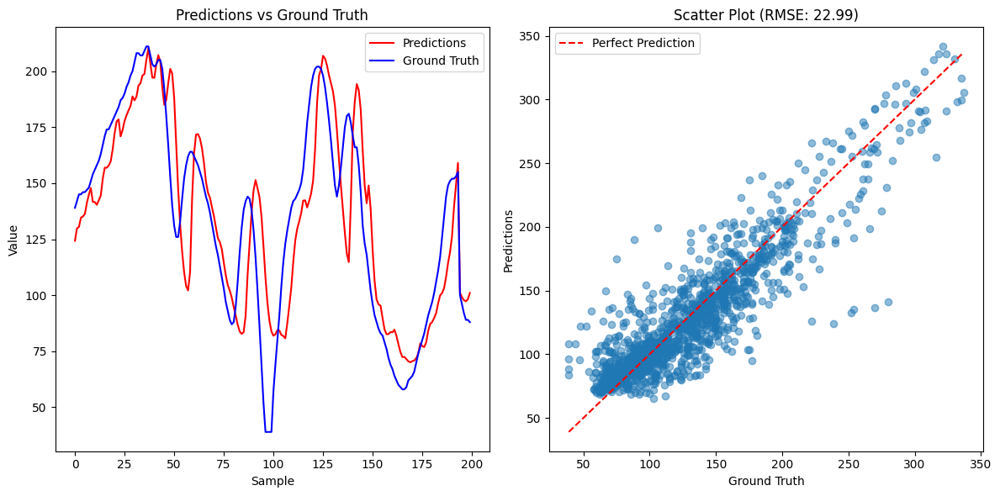

RMSE: 22.99
MAE: 16.30
MAPE: 14.26%
Test file: 1408
Root Mean Square Error (RMSE): 32.35
Mean Absolute Error (MAE): 23.15
Mean Absolute Percentage Error (MAPE): 14.35%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


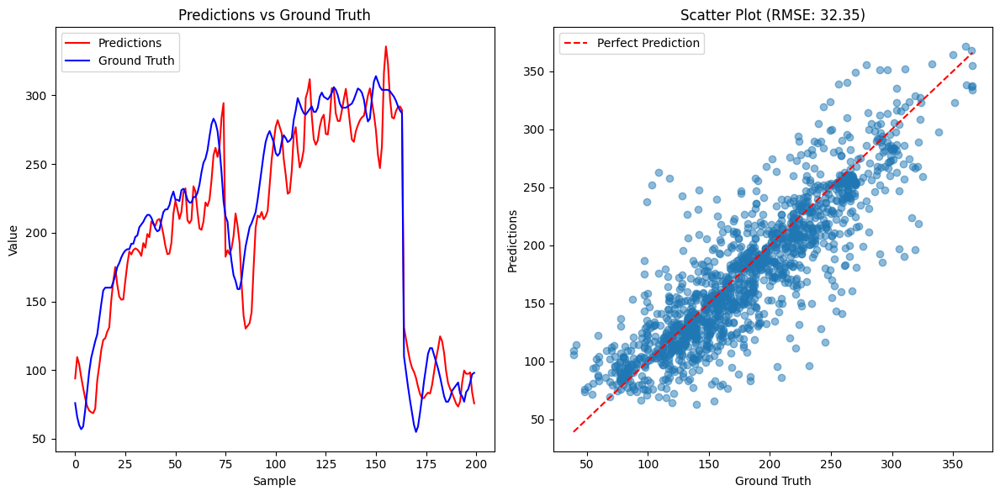

RMSE: 32.35
MAE: 23.15
MAPE: 14.35%
Test file: 1422
Root Mean Square Error (RMSE): 26.76
Mean Absolute Error (MAE): 19.22
Mean Absolute Percentage Error (MAPE): 13.45%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


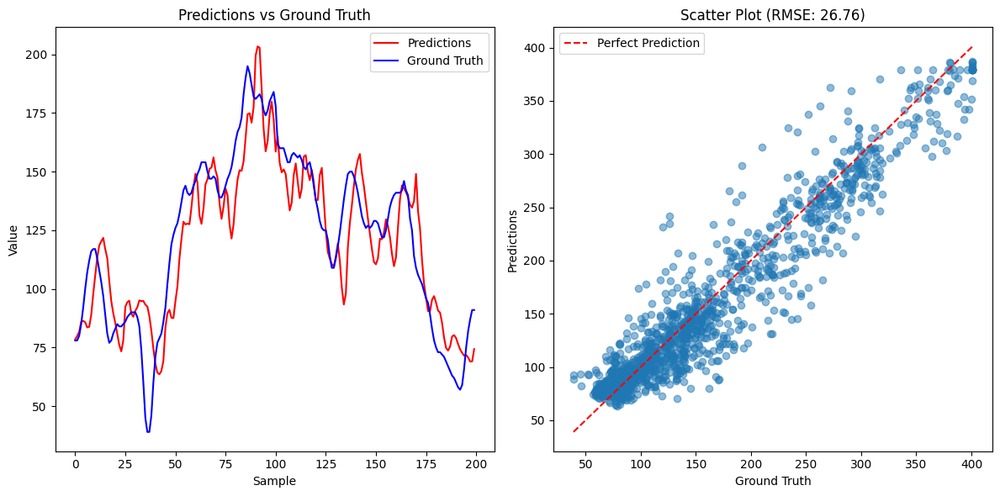

RMSE: 26.76
MAE: 19.22
MAPE: 13.45%
Test file: 1427
Root Mean Square Error (RMSE): 20.88
Mean Absolute Error (MAE): 16.10
Mean Absolute Percentage Error (MAPE): 14.73%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


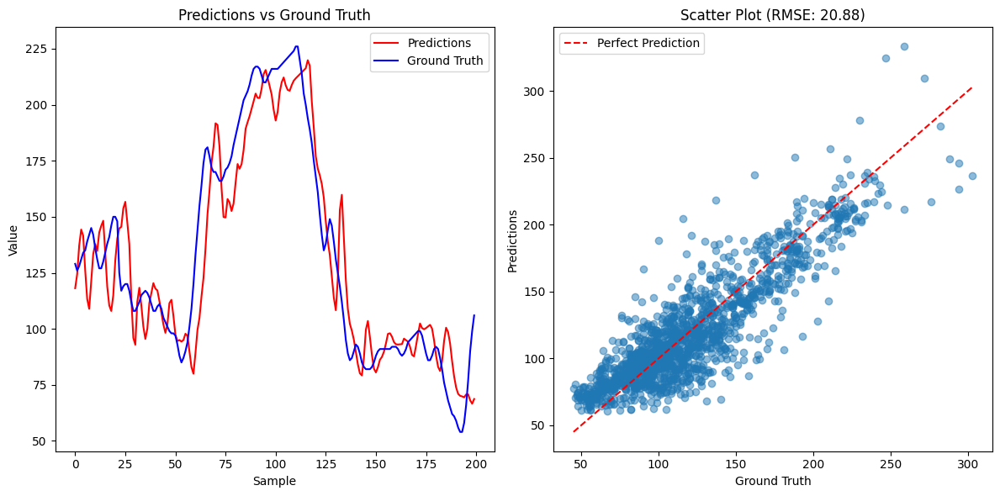

RMSE: 20.88
MAE: 16.10
MAPE: 14.73%
Test file: 1433
Root Mean Square Error (RMSE): 26.72
Mean Absolute Error (MAE): 18.36
Mean Absolute Percentage Error (MAPE): 16.71%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


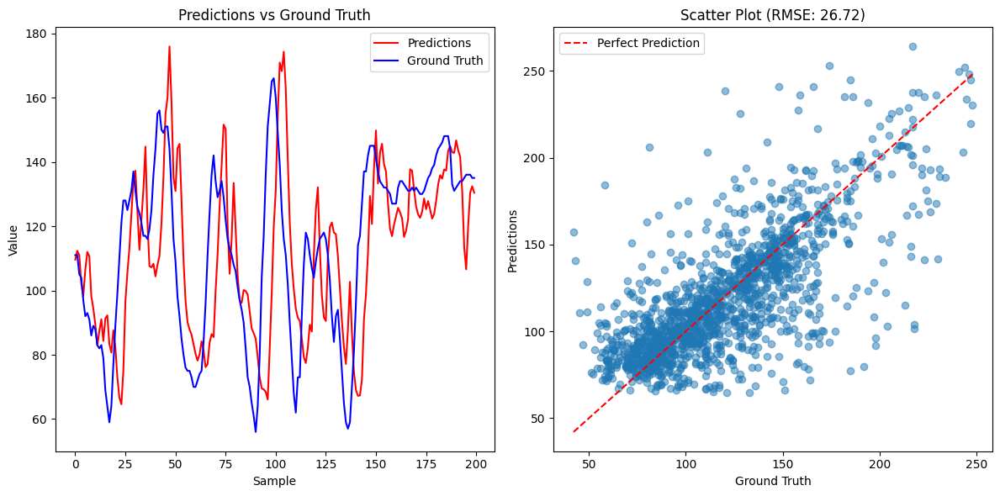

RMSE: 26.72
MAE: 18.36
MAPE: 16.71%
Test file: 1435
Root Mean Square Error (RMSE): 19.02
Mean Absolute Error (MAE): 14.04
Mean Absolute Percentage Error (MAPE): 8.56%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


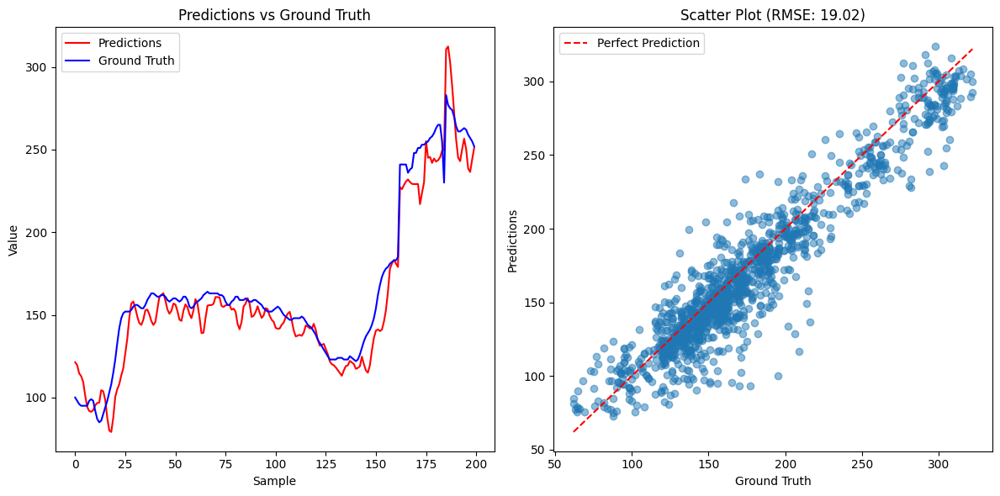

RMSE: 19.02
MAE: 14.04
MAPE: 8.56%
Test file: 144
Root Mean Square Error (RMSE): 17.99
Mean Absolute Error (MAE): 12.81
Mean Absolute Percentage Error (MAPE): 8.78%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


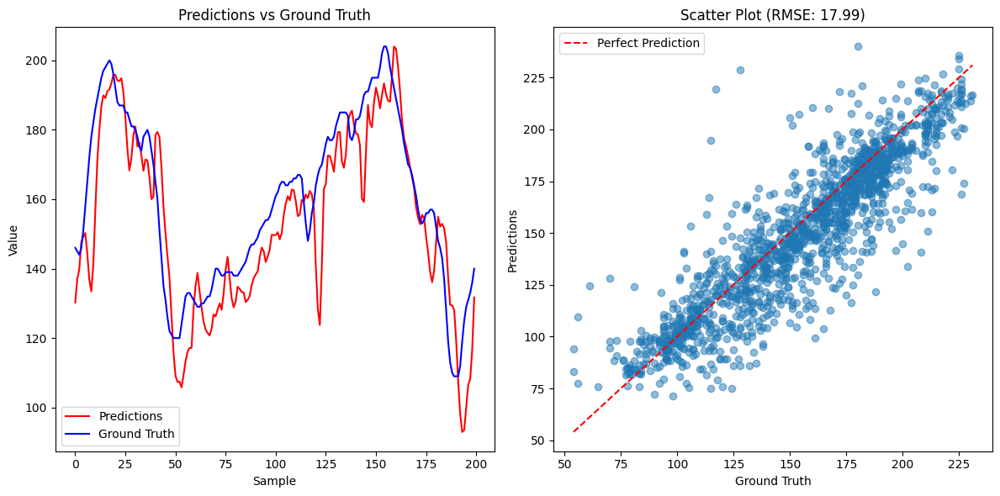

RMSE: 17.99
MAE: 12.81
MAPE: 8.78%
Test file: 1457
Root Mean Square Error (RMSE): 21.00
Mean Absolute Error (MAE): 15.21
Mean Absolute Percentage Error (MAPE): 13.01%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


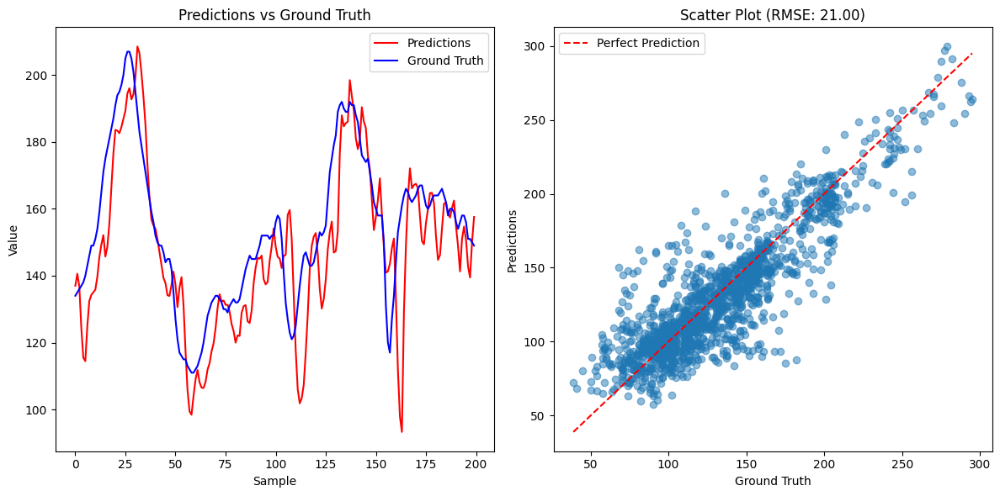

RMSE: 21.00
MAE: 15.21
MAPE: 13.01%
Test file: 1459
Root Mean Square Error (RMSE): 25.84
Mean Absolute Error (MAE): 18.93
Mean Absolute Percentage Error (MAPE): 11.65%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


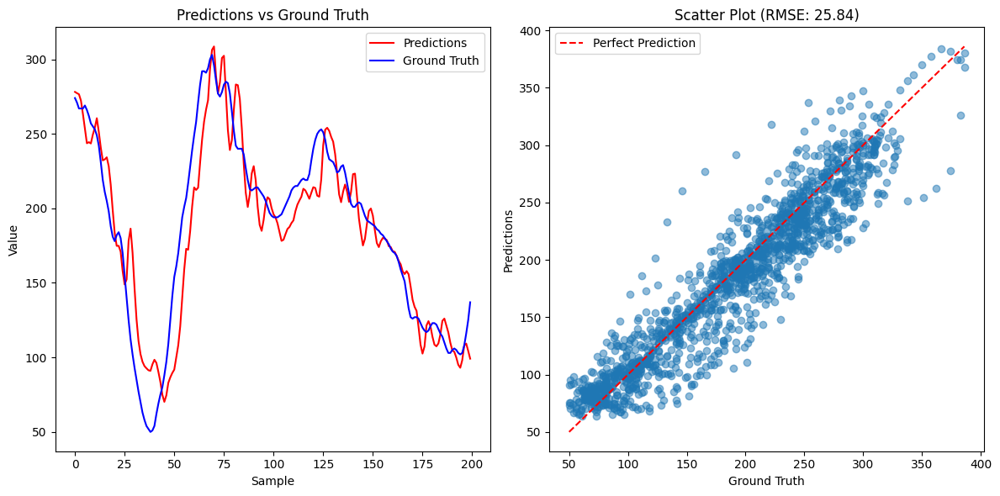

RMSE: 25.84
MAE: 18.93
MAPE: 11.65%
Test file: 1484
Root Mean Square Error (RMSE): 23.92
Mean Absolute Error (MAE): 16.36
Mean Absolute Percentage Error (MAPE): 8.83%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


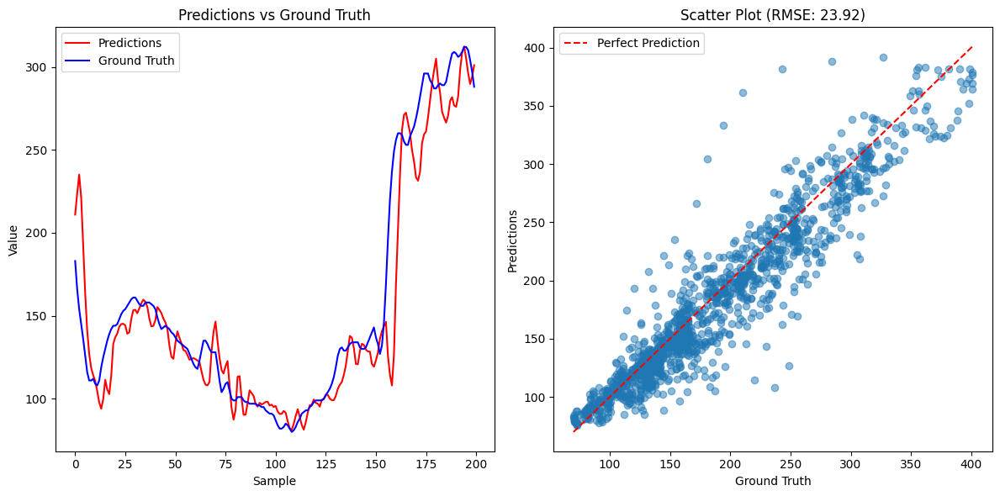

RMSE: 23.92
MAE: 16.36
MAPE: 8.83%
Test file: 1503
Root Mean Square Error (RMSE): 20.36
Mean Absolute Error (MAE): 15.08
Mean Absolute Percentage Error (MAPE): 10.35%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


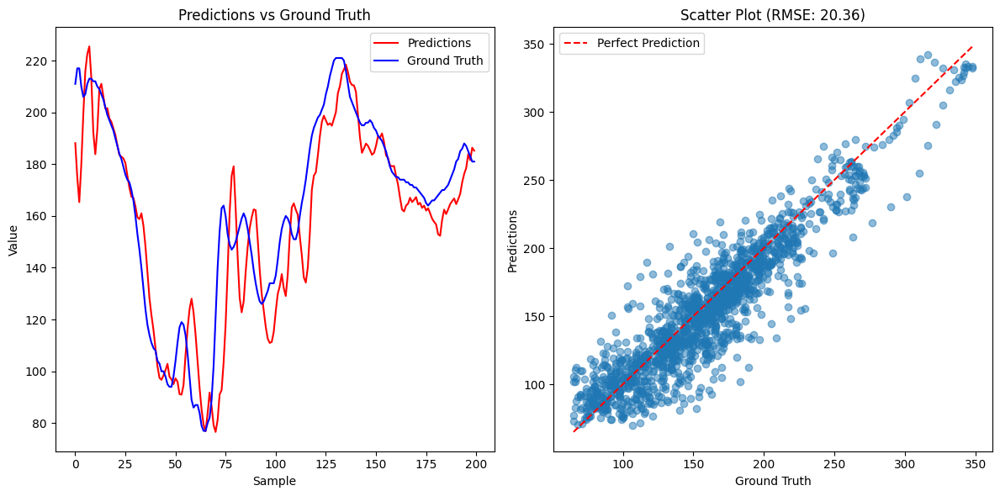

RMSE: 20.36
MAE: 15.08
MAPE: 10.35%
Test file: 152
Root Mean Square Error (RMSE): 22.31
Mean Absolute Error (MAE): 16.49
Mean Absolute Percentage Error (MAPE): 13.24%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


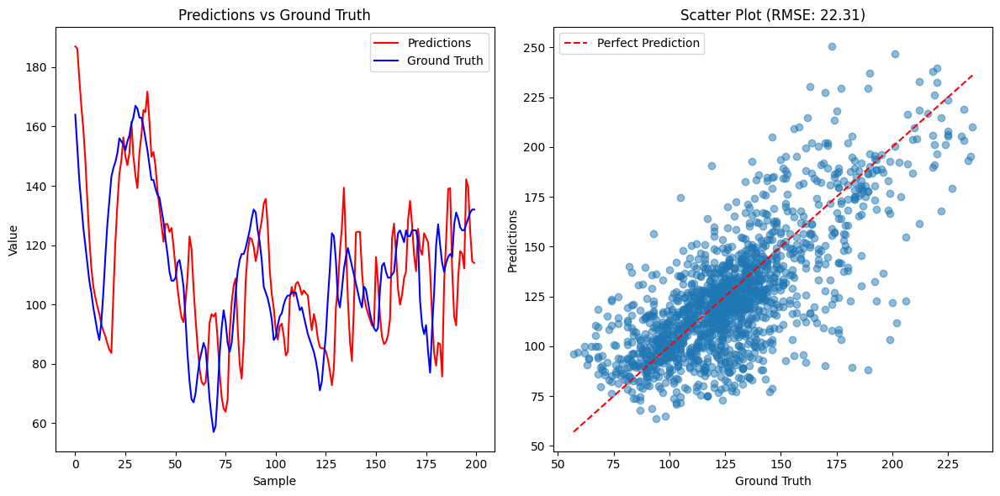

RMSE: 22.31
MAE: 16.49
MAPE: 13.24%
Test file: 1554
Root Mean Square Error (RMSE): 20.91
Mean Absolute Error (MAE): 15.05
Mean Absolute Percentage Error (MAPE): 12.01%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


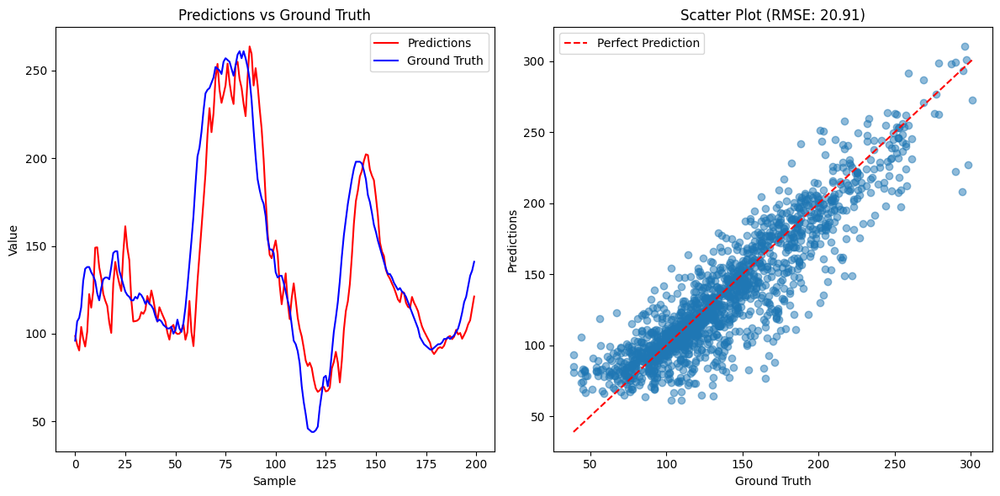

RMSE: 20.91
MAE: 15.05
MAPE: 12.01%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


Test file: 1558
Root Mean Square Error (RMSE): 30.28
Mean Absolute Error (MAE): 20.86
Mean Absolute Percentage Error (MAPE): 15.63%


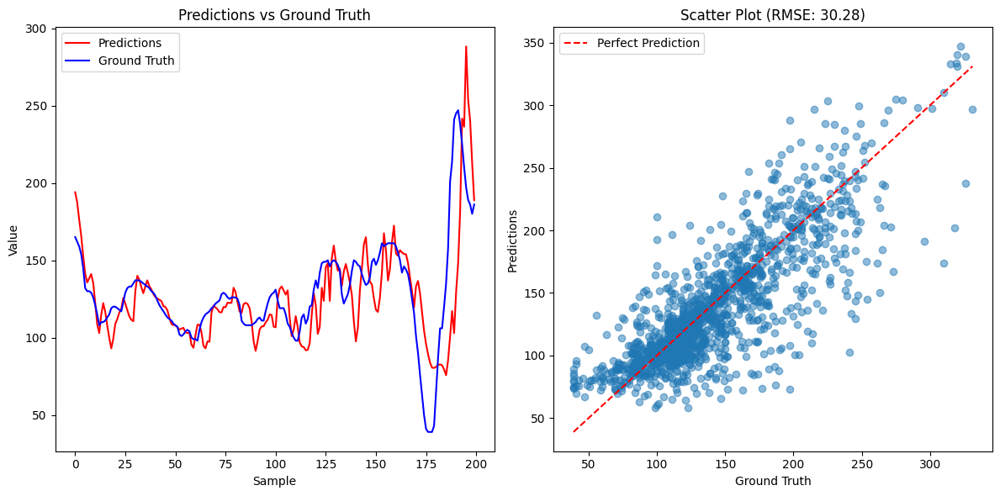

RMSE: 30.28
MAE: 20.86
MAPE: 15.63%
Test file: 1636
Root Mean Square Error (RMSE): 16.87
Mean Absolute Error (MAE): 13.05
Mean Absolute Percentage Error (MAPE): 7.69%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


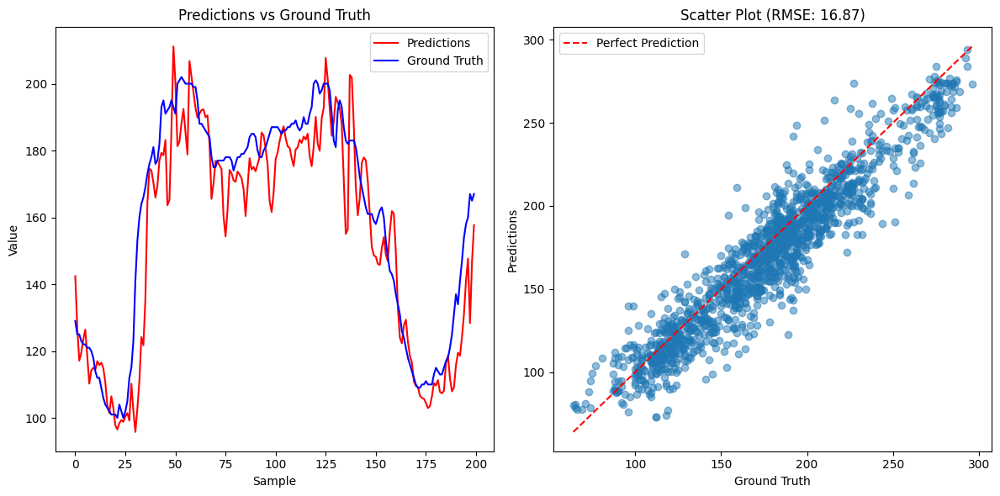

RMSE: 16.87
MAE: 13.05
MAPE: 7.69%
Test file: 1650
Root Mean Square Error (RMSE): 18.08
Mean Absolute Error (MAE): 12.14
Mean Absolute Percentage Error (MAPE): 9.73%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


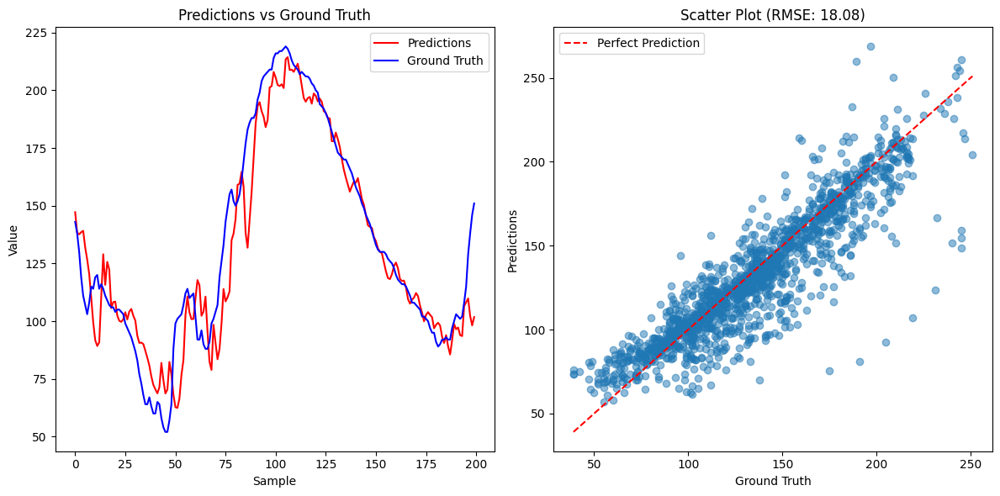

RMSE: 18.08
MAE: 12.14
MAPE: 9.73%
Test file: 1683
Root Mean Square Error (RMSE): 21.01
Mean Absolute Error (MAE): 15.30
Mean Absolute Percentage Error (MAPE): 11.61%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


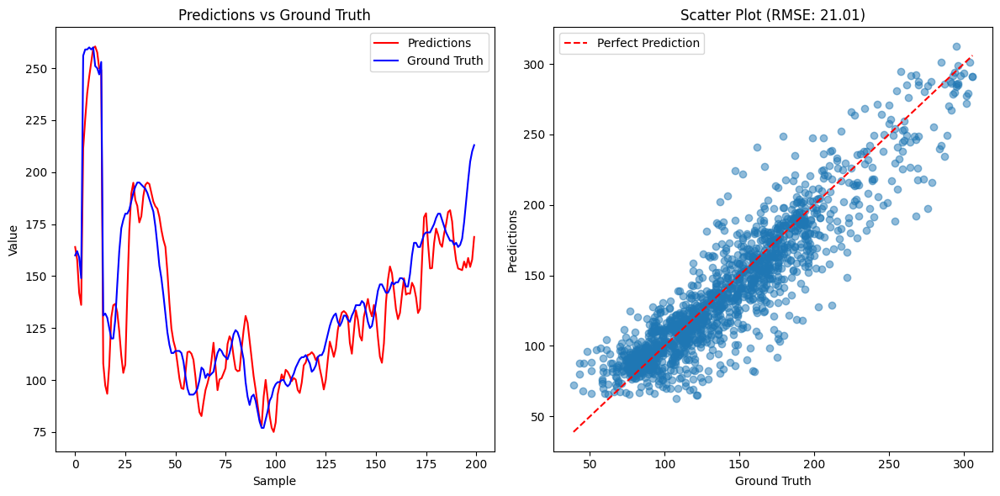

RMSE: 21.01
MAE: 15.30
MAPE: 11.61%
Test file: 1689
Root Mean Square Error (RMSE): 20.41
Mean Absolute Error (MAE): 14.90
Mean Absolute Percentage Error (MAPE): 8.71%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


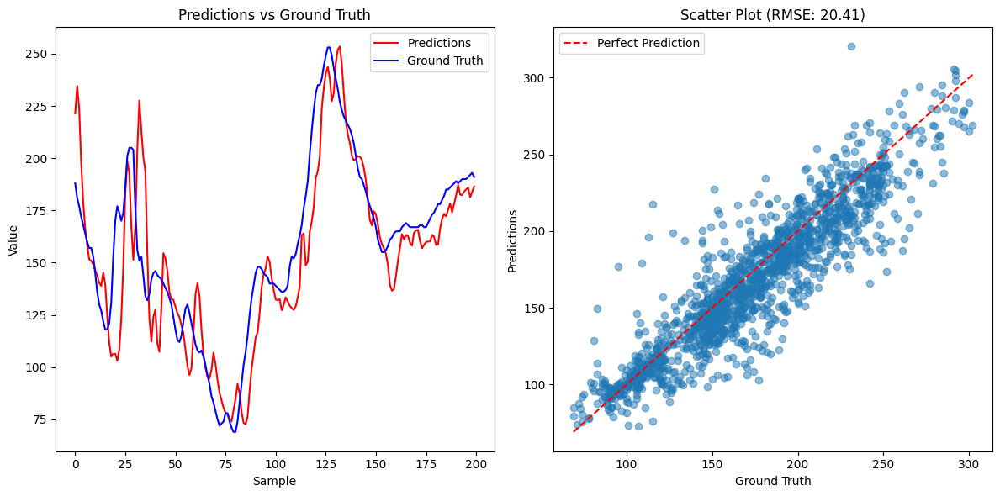

RMSE: 20.41
MAE: 14.90
MAPE: 8.71%
Test file: 1695
Root Mean Square Error (RMSE): 18.23
Mean Absolute Error (MAE): 13.36
Mean Absolute Percentage Error (MAPE): 11.40%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


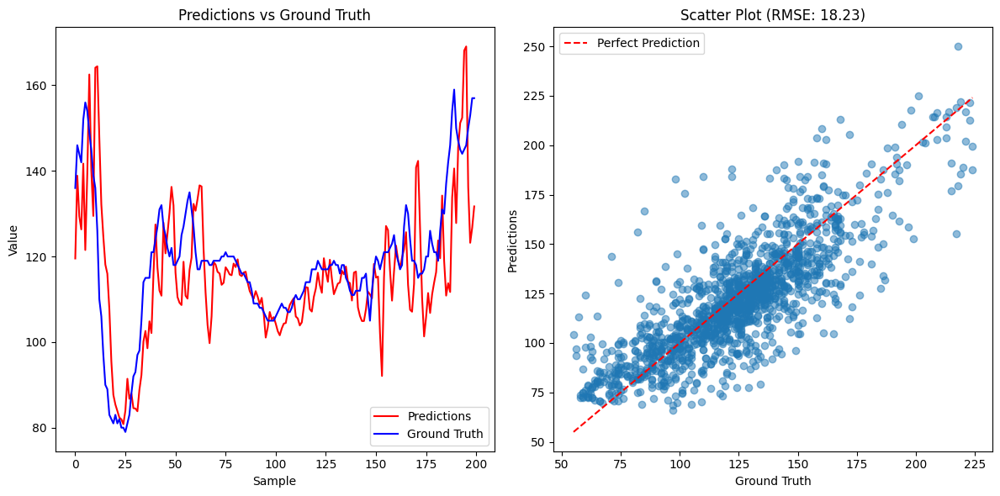

RMSE: 18.23
MAE: 13.36
MAPE: 11.40%
Test file: 1722
Root Mean Square Error (RMSE): 20.90
Mean Absolute Error (MAE): 15.12
Mean Absolute Percentage Error (MAPE): 11.04%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


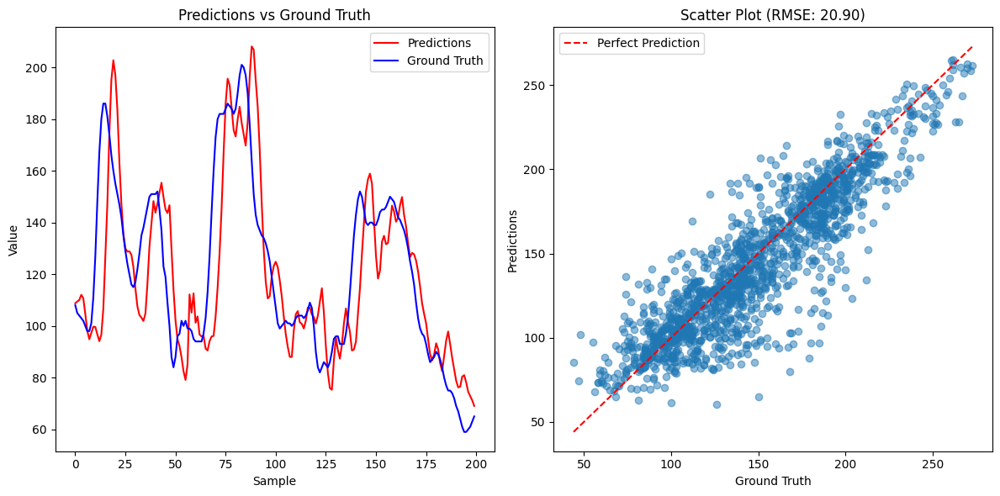

RMSE: 20.90
MAE: 15.12
MAPE: 11.04%
Test file: 1726
Root Mean Square Error (RMSE): 20.09
Mean Absolute Error (MAE): 14.70
Mean Absolute Percentage Error (MAPE): 9.03%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


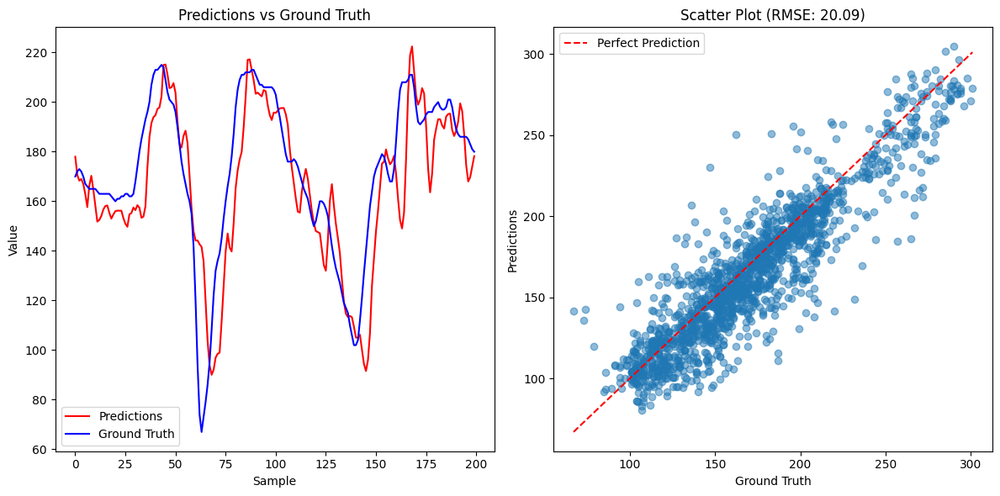

RMSE: 20.09
MAE: 14.70
MAPE: 9.03%
Test file: 173
Root Mean Square Error (RMSE): 21.08
Mean Absolute Error (MAE): 15.53
Mean Absolute Percentage Error (MAPE): 11.71%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


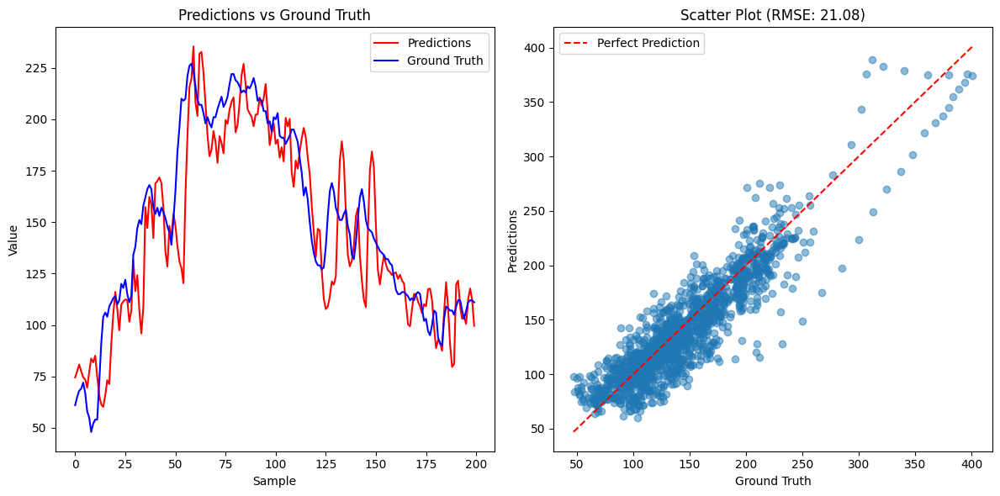

RMSE: 21.08
MAE: 15.53
MAPE: 11.71%
Test file: 18
Root Mean Square Error (RMSE): 18.81
Mean Absolute Error (MAE): 13.59
Mean Absolute Percentage Error (MAPE): 10.00%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


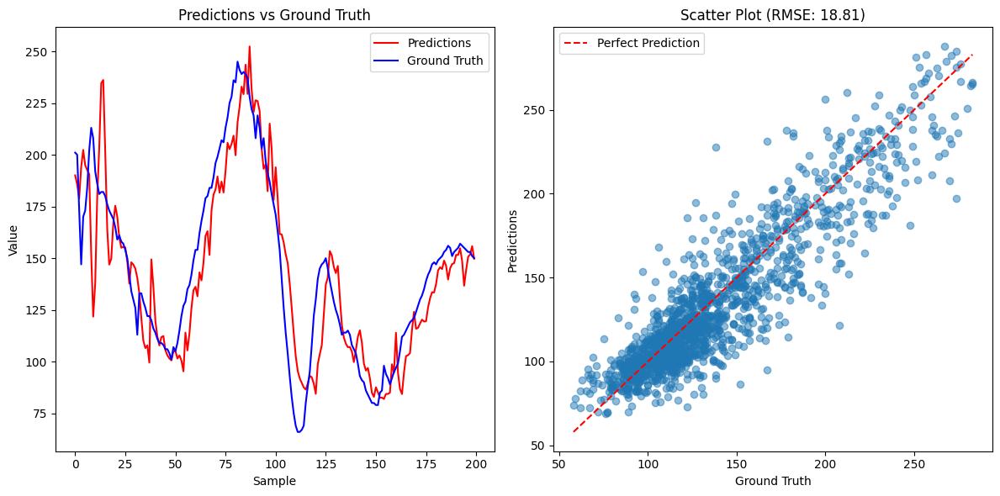

RMSE: 18.81
MAE: 13.59
MAPE: 10.00%
Test file: 187
Root Mean Square Error (RMSE): 22.89
Mean Absolute Error (MAE): 16.55
Mean Absolute Percentage Error (MAPE): 11.37%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


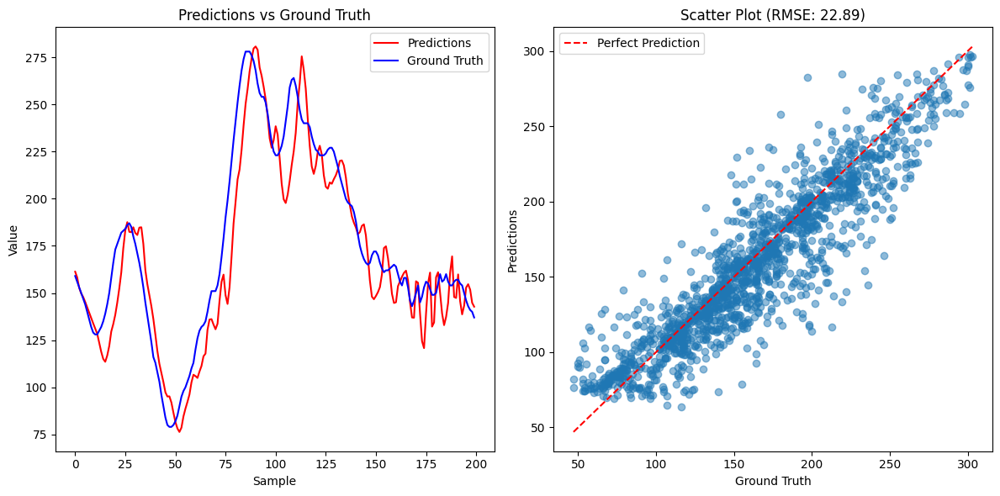

RMSE: 22.89
MAE: 16.55
MAPE: 11.37%
Test file: 24
Root Mean Square Error (RMSE): 24.27
Mean Absolute Error (MAE): 18.07
Mean Absolute Percentage Error (MAPE): 14.59%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


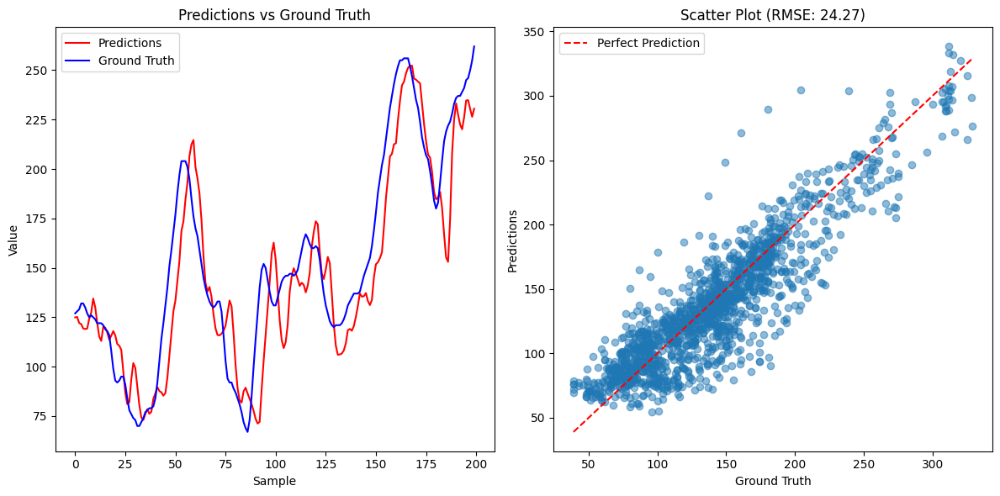

RMSE: 24.27
MAE: 18.07
MAPE: 14.59%
Test file: 248
Root Mean Square Error (RMSE): 14.56
Mean Absolute Error (MAE): 11.19
Mean Absolute Percentage Error (MAPE): 11.33%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


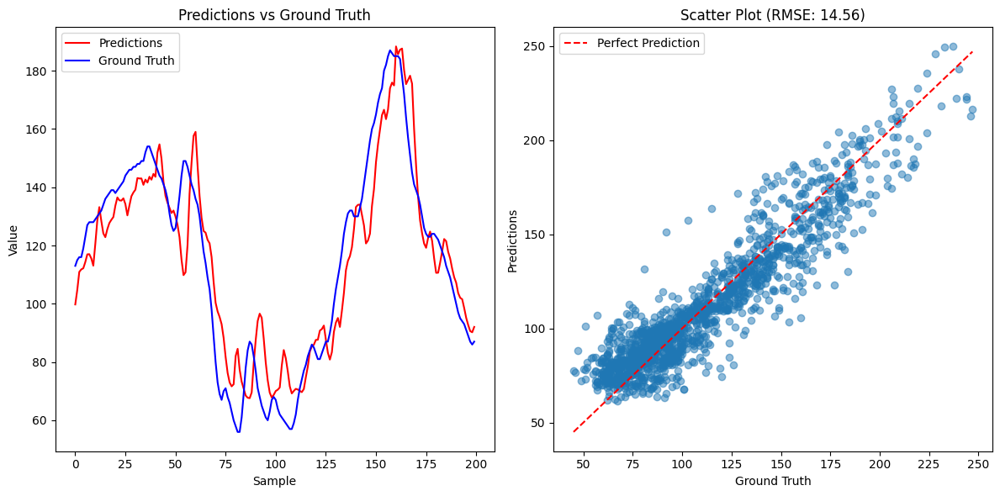

RMSE: 14.56
MAE: 11.19
MAPE: 11.33%
Test file: 25
Root Mean Square Error (RMSE): 20.71
Mean Absolute Error (MAE): 14.94
Mean Absolute Percentage Error (MAPE): 9.50%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


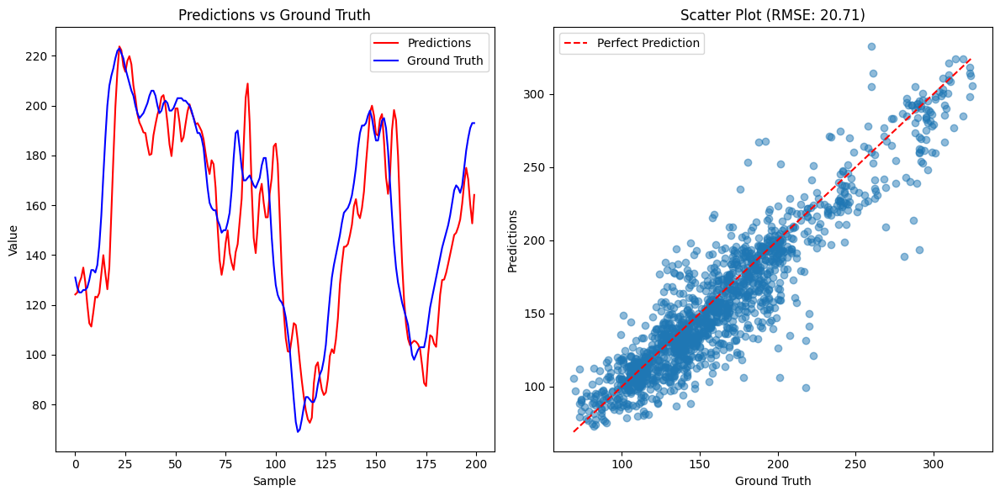

RMSE: 20.71
MAE: 14.94
MAPE: 9.50%
Test file: 252
Root Mean Square Error (RMSE): 18.17
Mean Absolute Error (MAE): 13.50
Mean Absolute Percentage Error (MAPE): 11.67%


<ipython-input-52-d97facbe1189>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)


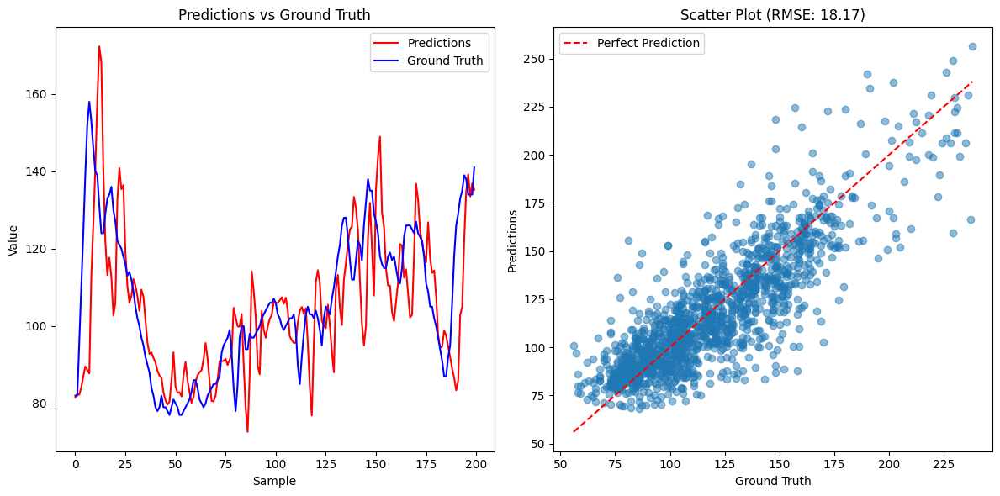

RMSE: 18.17
MAE: 13.50
MAPE: 11.67%


In [ ]:
past_sequence_length = 12
future_offset = 6
batch_size = 64
max_interval_minutes = 30
sh = 'sh'+str(past_sequence_length)

# Load the saved model
model = load_model_population('population_'+sh, past_sequence_length, save_dir=os.path.join(model_dir, 'saved_models_T1DEXI'))
test_eval = []

test_df = pd.read_csv(population_data_dir + 'T1DEXI_test.csv')
test_df['timestamp'] = pd.to_datetime(test_df['timestamp'])

# for test in population_splits['test']:
#     print(test)
for uid in test_df['USUBJID'].unique():
    cur_df = test_df[test_df['USUBJID'] == uid]
    cur_df.drop(columns=['USUBJID'], inplace=True)
    # Evaluate on test data individually
    metrics = evaluate_and_save_metrics_T1DEXI(
        model=model,
        test_df=cur_df,
        save_dir=os.path.join(model_dir, 'evaluation_metrics_T1DEXI/80_20_individual_'+sh+'/'),
        past_sequence_length=past_sequence_length,
        future_offset=future_offset,
        batch_size=batch_size,
        max_interval_minutes=max_interval_minutes
    )

    id = uid
    test_eval.append([id, round(metrics['rmse'], 2), round(metrics['mae'], 2), round(metrics['mape'], 2)])

    # print(f"\nResults for population model:")
    print(f"RMSE: {metrics['rmse']:.2f}")
    print(f"MAE: {metrics['mae']:.2f}")
    print(f"MAPE: {metrics['mape']:.2f}%")

In [ ]:
print(test_eval)
df = pd.DataFrame(test_eval, columns=['test patient', 'RMSE', 'MAE', 'MAPE'])
df.to_csv(os.path.join(model_dir, 'evaluation_metrics_T1DEXI/80_20_test_eval_'+sh+'.csv'), index=False)

[[1, 30.93, 21.56, 17.17], [1010, 25.91, 17.9, 17.2], [1015, 14.78, 10.97, 7.28], [103, 14.82, 10.31, 8.04], [1043, 23.04, 15.57, 11.7], [1082, 20.3, 14.34, 12.54], [11, 14.74, 11.27, 11.82], [1115, 20.15, 14.61, 6.43], [1121, 25.19, 19.23, 17.49], [1139, 20.86, 15.12, 9.78], [114, 21.12, 15.15, 9.78], [1127, 19.93, 14.64, 11.92], [1143, 20.25, 14.18, 8.67], [115, 25.25, 18.87, 13.71], [1171, 21.68, 16.2, 12.82], [1194, 12.91, 9.37, 7.06], [1201, 20.31, 14.35, 11.81], [1205, 22.08, 15.9, 10.82], [1211, 25.63, 17.4, 11.93], [1219, 18.62, 13.06, 10.48], [1230, 19.6, 14.37, 12.33], [1239, 18.83, 14.04, 10.18], [1271, 24.3, 18.4, 12.36], [1286, 12.73, 9.07, 7.11], [1311, 20.9, 14.53, 11.69], [1330, 22.28, 15.77, 11.57], [1336, 28.53, 20.46, 16.16], [1343, 13.43, 8.65, 7.96], [1345, 21.1, 15.72, 12.54], [1348, 37.65, 25.72, 14.73], [1361, 19.43, 14.53, 14.94], [1362, 18.79, 13.49, 11.7], [1363, 23.24, 16.4, 11.09], [1377, 17.92, 13.23, 10.29], [1381, 16.32, 11.71, 9.09], [1386, 22.99, 16.3,

## 5-fold cross validation

### data split

In [8]:
def create_5fold_splits(data_path):
    uids = [file for file in os.listdir(data_path)]
    total_files = len(uids)

    # Calculate files per fold (rounded up for the first folds)
    files_per_fold = total_files // 5
    remainder = total_files % 5

    # Create splits
    fold_splits = {}
    start_idx = 0

    for fold in range(5):
        fold_name = f"fold{fold+1}"

        # Calculate number of files for this fold's test set
        if fold < remainder:
            current_fold_size = files_per_fold + 1
        else:
            current_fold_size = files_per_fold

        # Get test indices for this fold
        end_idx = start_idx + current_fold_size
        test_indices = list(range(start_idx, end_idx))
        # print(test_indices)

        # Create test and train sets
        test_files = [uids[i] for i in test_indices]
        train_files = [path for i, path in enumerate(uids) if i not in test_indices]

        # Add to splits dictionary
        fold_splits[fold_name] = {
            'test': test_files,
            'train': train_files
        }

        # Update start index for next fold
        start_idx = end_idx
        # break

    return fold_splits

In [9]:
data_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_Dataset/T1DEXI_processed/'

fold_splits = create_5fold_splits(data_dir)
print(fold_splits)

{'fold1': {'test': ['1.csv', '1010.csv', '1015.csv', '103.csv', '1043.csv', '1082.csv', '11.csv', '1115.csv', '1121.csv', '1139.csv', '114.csv', '1127.csv', '1143.csv'], 'train': ['115.csv', '1171.csv', '1194.csv', '1201.csv', '1205.csv', '1211.csv', '1219.csv', '1230.csv', '1239.csv', '1271.csv', '1286.csv', '1311.csv', '1330.csv', '1336.csv', '1343.csv', '1345.csv', '1348.csv', '1361.csv', '1362.csv', '1363.csv', '1377.csv', '1381.csv', '1386.csv', '1408.csv', '1422.csv', '1427.csv', '1433.csv', '1435.csv', '144.csv', '1457.csv', '1459.csv', '1484.csv', '1503.csv', '152.csv', '1554.csv', '1558.csv', '1636.csv', '1650.csv', '1683.csv', '1689.csv', '1695.csv', '1722.csv', '1726.csv', '173.csv', '18.csv', '187.csv', '24.csv', '248.csv', '25.csv', '252.csv']}, 'fold2': {'test': ['115.csv', '1171.csv', '1194.csv', '1201.csv', '1205.csv', '1211.csv', '1219.csv', '1230.csv', '1239.csv', '1271.csv', '1286.csv', '1311.csv', '1330.csv'], 'train': ['1.csv', '1010.csv', '1015.csv', '103.csv', '1

In [5]:
def convert_to_datetime(date_str):
  try:
    return pd.to_datetime(date_str)
  except ValueError:
    return pd.to_datetime(date_str + ' 00:00:00')

In [7]:
def load_train_data_by_fold(fold_name):
  data_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_Dataset/T1DEXI_processed/'
  train_df = pd.DataFrame()

  for file in os.listdir(data_dir):
    if file in fold_splits[fold_name]['train']:
      df = pd.read_csv(os.path.join(data_dir, file))
      # df.drop(columns=['USUBJID'], inplace=True)
      df = df.rename(columns={"LBORRES": "mg/dl", "LBDTC": "timestamp"})
      df['timestamp'] = df['timestamp'].apply(convert_to_datetime)
      df = df.loc[:, ['USUBJID', 'timestamp', 'mg/dl']] # reorder to keep the same format as Diatrend for future training

      train_df = pd.concat([train_df, df])
      # break
  return train_df

### model train

In [13]:
%run /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py

In [8]:
fold_lst = fold_splits.keys()
print(fold_lst)

for fold in fold_lst:
  train_df = load_train_data_by_fold(fold)
  print(fold, '\ntrain data shape:', train_df.shape)

  # Move model to GPU if available
  device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

  # 4. Set hyperparameters
  past_sequence_length = 12
  future_offset = 6
  batch_size = 64
  max_interval_minutes = 30

  # 5. Train model
  model = TransformerEncoder_version2(
      past_seq_len=past_sequence_length,
      num_layers=1,
      d_model=512,
      nhead=4,
      input_dim=1,
      dropout=0.2
  )
  model = model.to(device)

  # Create datasets
  train_series_list = []
  for uid in train_df['USUBJID'].unique():
      cur_df = train_df[train_df['USUBJID'] == uid]
      cur_df.drop(columns=['USUBJID'], inplace=True)
      series_list = split_into_continuous_series(cur_df, past_sequence_length, future_offset, max_interval_minutes)
      train_series_list.extend(series_list)

  train_dataset, val_dataset = create_train_val_datasets(
      train_series_list,
      train_ratio=0.8,
      past_seq_len=past_sequence_length,
      future_offset=future_offset
  )

  # Create data loaders
  train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
  val_loader = DataLoader(val_dataset, batch_size=batch_size)

  # Train model
  train_losses, val_losses = train_model(
      model=model,
      train_loader=train_loader,
      val_loader=val_loader,
      num_epochs=200,
      learning_rate=1e-3
  )

  model_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/'
  sh = 'sh'+str(past_sequence_length)

  # Save the trained model
  save_model(model, sh+'_'+fold, save_dir=os.path.join(model_dir, 'saved_models_T1DEXI/5_fold/'))

  # break

dict_keys(['fold1', 'fold2', 'fold3', 'fold4', 'fold5'])
fold1 
train data shape: (388889, 3)


<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarni

Epoch [1/200], Train Loss: 3495.889413, Val Loss: 3161.067307
Epoch [6/200], Train Loss: 656.286984, Val Loss: 539.055683
Epoch [11/200], Train Loss: 584.359450, Val Loss: 469.388988
Epoch [16/200], Train Loss: 567.780108, Val Loss: 474.547462
Epoch [21/200], Train Loss: 573.665753, Val Loss: 515.631831
Epoch [26/200], Train Loss: 554.181905, Val Loss: 531.705896
Epoch [31/200], Train Loss: 574.548177, Val Loss: 701.602501
Epoch [36/200], Train Loss: 558.908796, Val Loss: 585.581845
Epoch [41/200], Train Loss: 494.953873, Val Loss: 450.504547
Epoch [46/200], Train Loss: 499.720533, Val Loss: 458.134436
Epoch [51/200], Train Loss: 499.947477, Val Loss: 454.381584
Epoch [56/200], Train Loss: 467.301505, Val Loss: 455.585766
Epoch [61/200], Train Loss: 468.739908, Val Loss: 503.963078
Epoch [66/200], Train Loss: 459.918517, Val Loss: 463.500048
Epoch [71/200], Train Loss: 459.617133, Val Loss: 474.168694
Epoch [76/200], Train Loss: 459.621117, Val Loss: 462.066631
Epoch [81/200], Train Lo

<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarni

Epoch [1/200], Train Loss: 3808.208768, Val Loss: 3466.820080
Epoch [6/200], Train Loss: 597.915442, Val Loss: 1134.573442
Epoch [11/200], Train Loss: 590.103612, Val Loss: 469.877368
Epoch [16/200], Train Loss: 587.295292, Val Loss: 677.944821
Epoch [21/200], Train Loss: 506.290922, Val Loss: 474.220626
Epoch [26/200], Train Loss: 505.700859, Val Loss: 527.697258
Epoch [31/200], Train Loss: 471.653835, Val Loss: 450.722787
Epoch [36/200], Train Loss: 473.691261, Val Loss: 448.135925
Epoch [41/200], Train Loss: 470.369821, Val Loss: 471.154024
Epoch [46/200], Train Loss: 470.838242, Val Loss: 452.243159
Epoch [51/200], Train Loss: 471.158274, Val Loss: 454.224081
Epoch [56/200], Train Loss: 458.168722, Val Loss: 445.532985
Epoch [61/200], Train Loss: 456.101954, Val Loss: 450.105495
Epoch [66/200], Train Loss: 458.908593, Val Loss: 460.033639
Epoch [71/200], Train Loss: 457.157041, Val Loss: 446.757063
Epoch [76/200], Train Loss: 459.687310, Val Loss: 443.160742
Epoch [81/200], Train L

<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarni

Epoch [1/200], Train Loss: 3344.987958, Val Loss: 3009.912585
Epoch [6/200], Train Loss: 569.522705, Val Loss: 438.616898
Epoch [11/200], Train Loss: 540.345459, Val Loss: 513.771946
Epoch [16/200], Train Loss: 542.801320, Val Loss: 444.044095
Epoch [21/200], Train Loss: 537.847110, Val Loss: 786.832627
Epoch [26/200], Train Loss: 525.437071, Val Loss: 437.773425
Epoch [31/200], Train Loss: 527.732455, Val Loss: 519.255754
Epoch [36/200], Train Loss: 525.366422, Val Loss: 419.448751
Epoch [41/200], Train Loss: 529.053872, Val Loss: 483.680420
Epoch [46/200], Train Loss: 519.704870, Val Loss: 509.385481
Epoch [51/200], Train Loss: 473.088609, Val Loss: 436.966254
Epoch [56/200], Train Loss: 473.229133, Val Loss: 436.134142
Epoch [61/200], Train Loss: 452.790380, Val Loss: 435.343010
Epoch [66/200], Train Loss: 451.273252, Val Loss: 461.299584
Epoch [71/200], Train Loss: 451.490428, Val Loss: 423.563164
Epoch [76/200], Train Loss: 439.022441, Val Loss: 421.321196
Epoch [81/200], Train Lo

<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarni

Epoch [1/200], Train Loss: 3505.689391, Val Loss: 3226.209242
Epoch [6/200], Train Loss: 588.762764, Val Loss: 466.326045
Epoch [11/200], Train Loss: 549.087624, Val Loss: 464.824389
Epoch [16/200], Train Loss: 546.897850, Val Loss: 791.241247
Epoch [21/200], Train Loss: 545.356534, Val Loss: 603.786924
Epoch [26/200], Train Loss: 481.749880, Val Loss: 432.161962
Epoch [31/200], Train Loss: 486.820570, Val Loss: 463.925670
Epoch [36/200], Train Loss: 481.912946, Val Loss: 440.029302
Epoch [41/200], Train Loss: 483.400042, Val Loss: 532.019407
Epoch [46/200], Train Loss: 453.909345, Val Loss: 427.750433
Epoch [51/200], Train Loss: 455.636268, Val Loss: 432.720233
Epoch [56/200], Train Loss: 455.113726, Val Loss: 443.236387
Epoch [61/200], Train Loss: 441.124203, Val Loss: 438.118964
Epoch [66/200], Train Loss: 441.489297, Val Loss: 425.755920
Epoch [71/200], Train Loss: 432.196100, Val Loss: 425.106341
Epoch [76/200], Train Loss: 432.988735, Val Loss: 424.706012
Epoch [81/200], Train Lo

<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cur_df.drop(columns=['USUBJID'], inplace=True)
<ipython-input-8-42619083ed2a>:32: SettingWithCopyWarni

Epoch [1/200], Train Loss: 3509.565792, Val Loss: 3298.197170
Epoch [6/200], Train Loss: 578.639334, Val Loss: 500.827064
Epoch [11/200], Train Loss: 575.573965, Val Loss: 604.903245
Epoch [16/200], Train Loss: 567.227495, Val Loss: 604.667483
Epoch [21/200], Train Loss: 498.494039, Val Loss: 530.838557
Epoch [26/200], Train Loss: 500.660617, Val Loss: 557.000983
Epoch [31/200], Train Loss: 499.263971, Val Loss: 461.664097
Epoch [36/200], Train Loss: 493.319355, Val Loss: 504.830468
Epoch [41/200], Train Loss: 501.980260, Val Loss: 466.540678
Epoch [46/200], Train Loss: 464.922853, Val Loss: 466.233399
Epoch [51/200], Train Loss: 466.801697, Val Loss: 619.689286
Epoch [56/200], Train Loss: 453.079887, Val Loss: 465.326162
Epoch [61/200], Train Loss: 452.990998, Val Loss: 507.479262
Epoch [66/200], Train Loss: 453.916387, Val Loss: 453.272324
Epoch [71/200], Train Loss: 455.073947, Val Loss: 495.076531
Epoch [76/200], Train Loss: 446.777838, Val Loss: 463.698825
Epoch [81/200], Train Lo

### individual evaluation

In [10]:
def evaluate_and_save_metrics_T1DEXI(model, test_df, save_dir="metrics",
                            past_sequence_length=7, future_offset=6,
                            batch_size=32, max_interval_minutes=30):
    """
    Evaluate model performance on test data and save metrics to file.

    Args:
        model: The trained model
        save_dir: Directory to save metrics
        past_sequence_length: Length of input sequence
        future_offset: Prediction horizon
        batch_size: Batch size for testing
        max_interval_minutes: Maximum interval between readings to consider continuous
    """
    # Create save directory if it doesn't exist
    os.makedirs(save_dir, exist_ok=True)

    # Split into continuous series
    test_series_list = split_into_continuous_series(test_df, past_sequence_length, future_offset,max_interval_minutes)

    # Create dataset and dataloader
    test_dataset, _ = create_train_val_datasets(
        test_series_list,
        train_ratio=0.9999,
        past_seq_len=past_sequence_length,
        future_offset=future_offset
    )
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

    # Evaluate model
    model.eval()
    predictions = []
    ground_truths = []

    with torch.no_grad():
        for inputs, targets in test_loader:
            inputs = inputs.to('cuda') if torch.cuda.is_available() else inputs
            targets = targets.to('cuda') if torch.cuda.is_available() else targets

            outputs = model(inputs)
            predictions.extend(outputs.cpu().numpy())
            ground_truths.extend(targets.cpu().numpy())

    # Convert to numpy arrays
    predictions = np.array(predictions).flatten()
    ground_truths = np.array(ground_truths).flatten()

    # Calculate metrics
    rmse = np.sqrt(mean_squared_error(ground_truths, predictions))
    mae = np.mean(np.abs(predictions - ground_truths))
    mape = np.mean(np.abs((ground_truths - predictions) / ground_truths)) * 100

    # Print metrics
    print(f'Test file: {uid}')
    print(f'Root Mean Square Error (RMSE): {rmse:.2f}')
    print(f'Mean Absolute Error (MAE): {mae:.2f}')
    print(f'Mean Absolute Percentage Error (MAPE): {mape:.2f}%')

    # Save metrics to file
    metrics_filename = f"metrics_{uid}.txt"
    metrics_path = os.path.join(save_dir, metrics_filename)

    with open(metrics_path, 'w') as f:
        f.write(f"Test File: {uid}\n")
        f.write(f"RMSE: {rmse:.2f}\n")
        f.write(f"MAE: {mae:.2f}\n")
        f.write(f"MAPE: {mape:.2f}%\n")

    # Create plots
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.plot(predictions[:200], label='Predictions', color='r')
    plt.plot(ground_truths[:200], label='Ground Truth', color='b')
    plt.xlabel('Sample')
    plt.ylabel('Value')
    plt.title('Predictions vs Ground Truth')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.scatter(ground_truths, predictions, alpha=0.5)
    plt.plot([min(ground_truths), max(ground_truths)],
             [min(ground_truths), max(ground_truths)],
             'r--', label='Perfect Prediction')
    plt.xlabel('Ground Truth')
    plt.ylabel('Predictions')
    plt.title(f'Scatter Plot (RMSE: {rmse:.2f})')
    plt.legend()

    plt.tight_layout()
    plt.show()

    return {
        'rmse': rmse,
        'mae': mae,
        'mape': mape,
        'predictions': predictions,
        'ground_truths': ground_truths
    }

In [11]:
def load_test_data_individual(fold_name):
  data_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_Dataset/T1DEXI_processed/'
  train_df = pd.DataFrame()

  for file in os.listdir(data_dir):
    if file in fold_splits[fold_name]['train']:
      df = pd.read_csv(os.path.join(data_dir, file))
      # df.drop(columns=['USUBJID'], inplace=True)
      df = df.rename(columns={"LBORRES": "mg/dl", "LBDTC": "timestamp"})
      df['timestamp'] = df['timestamp'].apply(convert_to_datetime)
      df = df.loc[:, ['USUBJID', 'timestamp', 'mg/dl']] # reorder to keep the same format as Diatrend for future training

      train_df = pd.concat([train_df, df])
      # break
  return train_df

fold1 ['1.csv', '1010.csv', '1015.csv', '103.csv', '1043.csv', '1082.csv', '11.csv', '1115.csv', '1121.csv', '1139.csv', '114.csv', '1127.csv', '1143.csv']
Model loaded from /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/saved_models_T1DEXI/5_fold/model_sh12_fold1.pth


/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py:762: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  mod

Test file: 1
Root Mean Square Error (RMSE): 26.82
Mean Absolute Error (MAE): 18.71
Mean Absolute Percentage Error (MAPE): 12.89%


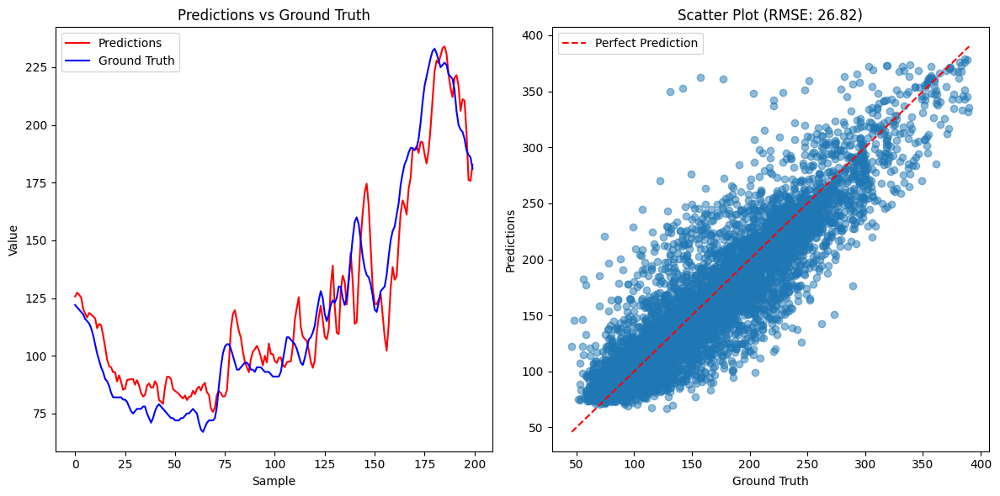

RMSE: 26.82
MAE: 18.71
MAPE: 12.89%
Test file: 1010
Root Mean Square Error (RMSE): 22.40
Mean Absolute Error (MAE): 15.31
Mean Absolute Percentage Error (MAPE): 14.09%


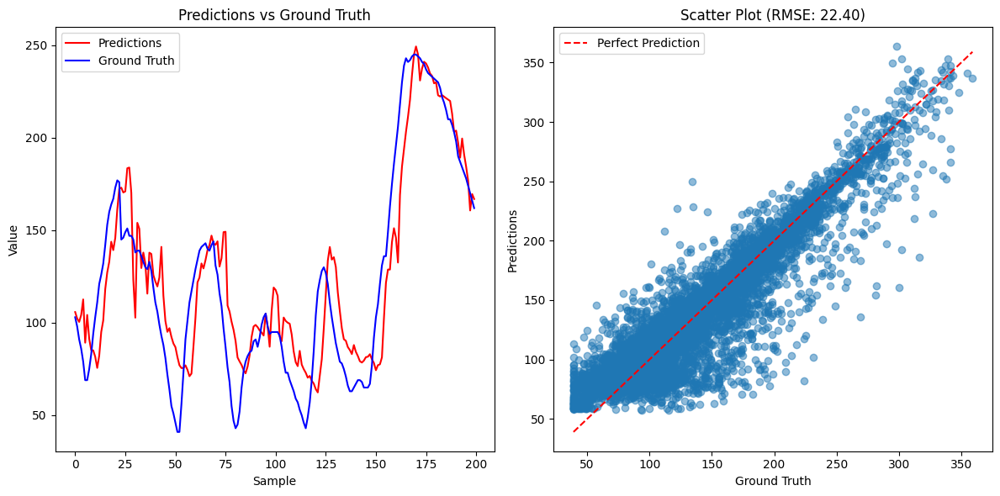

RMSE: 22.40
MAE: 15.31
MAPE: 14.09%
Test file: 1015
Root Mean Square Error (RMSE): 11.85
Mean Absolute Error (MAE): 8.52
Mean Absolute Percentage Error (MAPE): 6.61%


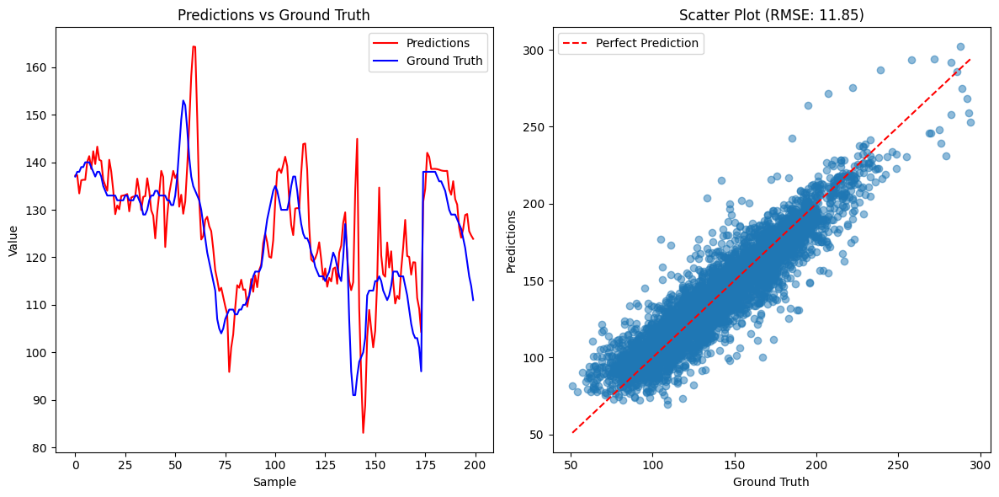

RMSE: 11.85
MAE: 8.52
MAPE: 6.61%
Test file: 103
Root Mean Square Error (RMSE): 12.30
Mean Absolute Error (MAE): 8.87
Mean Absolute Percentage Error (MAPE): 7.71%


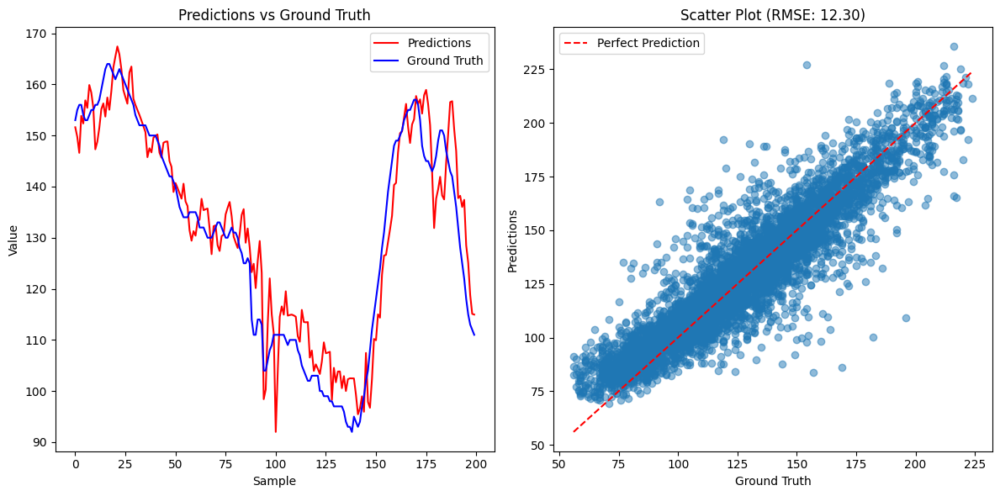

RMSE: 12.30
MAE: 8.87
MAPE: 7.71%
Test file: 1043
Root Mean Square Error (RMSE): 18.79
Mean Absolute Error (MAE): 12.85
Mean Absolute Percentage Error (MAPE): 9.69%


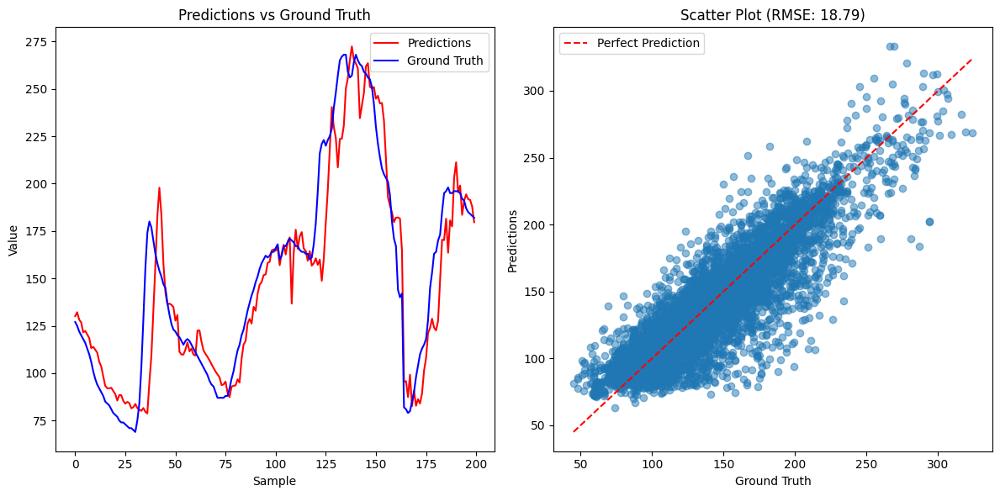

RMSE: 18.79
MAE: 12.85
MAPE: 9.69%
Test file: 1082
Root Mean Square Error (RMSE): 17.33
Mean Absolute Error (MAE): 13.07
Mean Absolute Percentage Error (MAPE): 12.44%


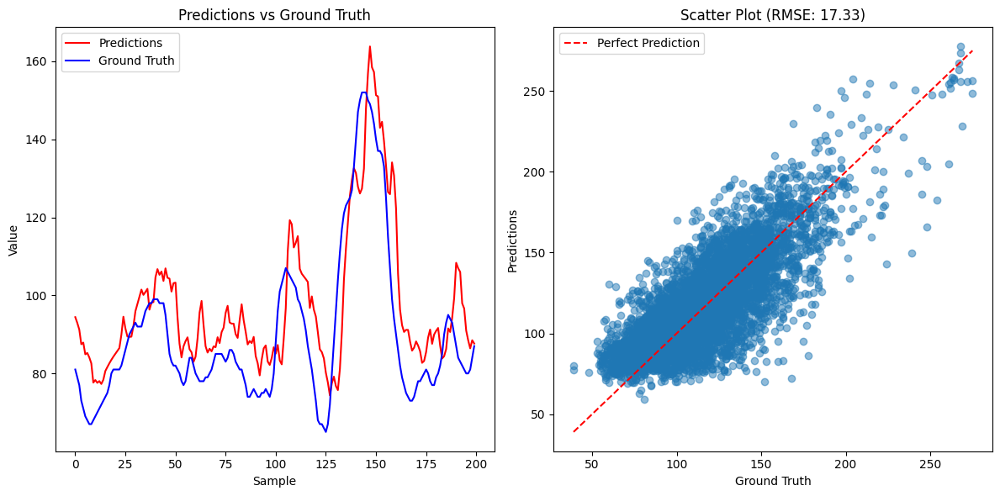

RMSE: 17.33
MAE: 13.07
MAPE: 12.44%
Test file: 11
Root Mean Square Error (RMSE): 17.64
Mean Absolute Error (MAE): 13.42
Mean Absolute Percentage Error (MAPE): 14.54%


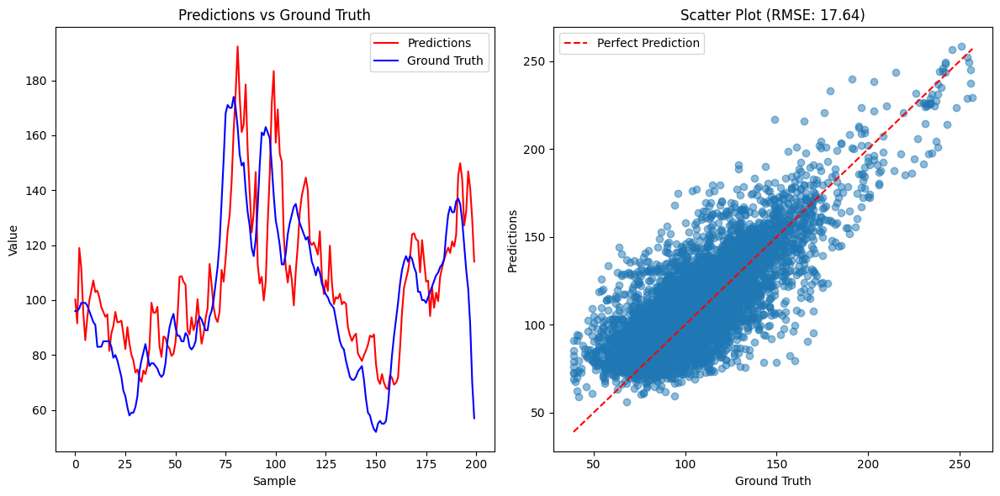

RMSE: 17.64
MAE: 13.42
MAPE: 14.54%
Test file: 1115
Root Mean Square Error (RMSE): 22.58
Mean Absolute Error (MAE): 15.84
Mean Absolute Percentage Error (MAPE): 9.93%


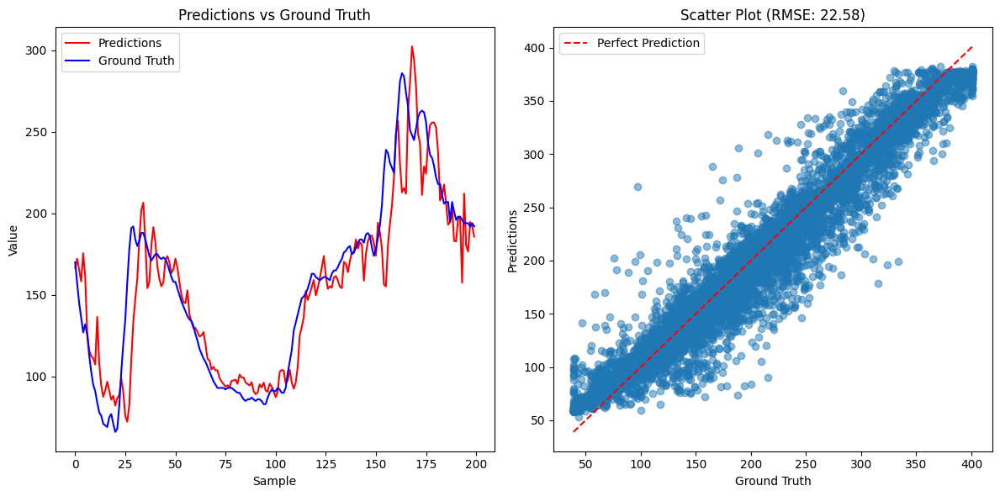

RMSE: 22.58
MAE: 15.84
MAPE: 9.93%
Test file: 1121
Root Mean Square Error (RMSE): 24.18
Mean Absolute Error (MAE): 17.94
Mean Absolute Percentage Error (MAPE): 16.14%


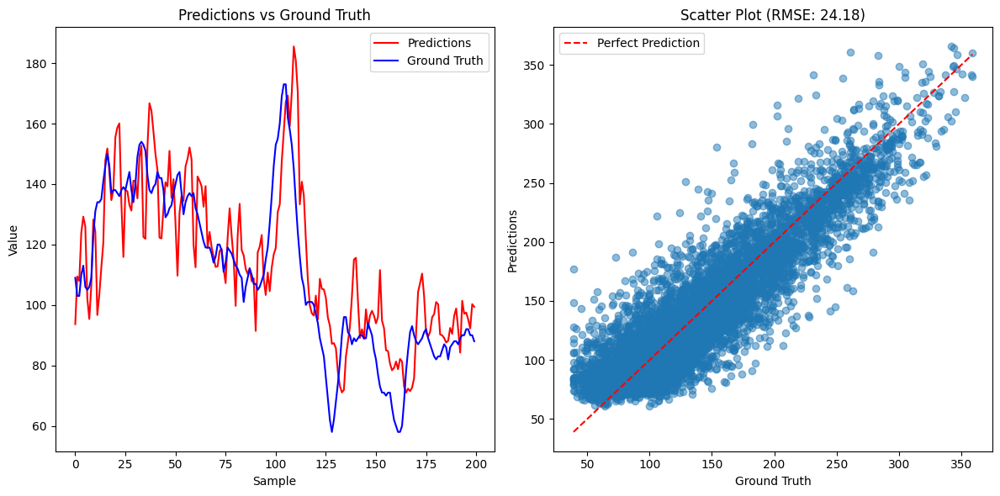

RMSE: 24.18
MAE: 17.94
MAPE: 16.14%
Test file: 1139
Root Mean Square Error (RMSE): 20.72
Mean Absolute Error (MAE): 15.26
Mean Absolute Percentage Error (MAPE): 11.59%


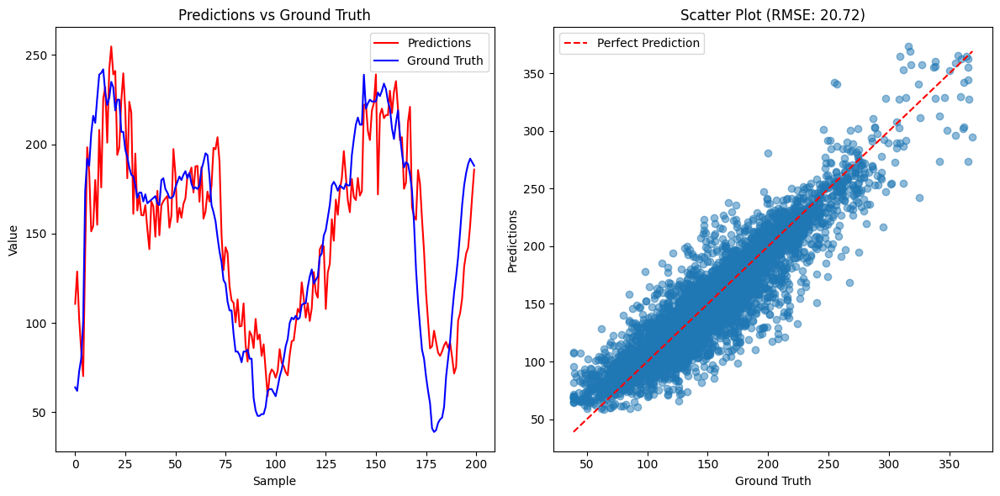

RMSE: 20.72
MAE: 15.26
MAPE: 11.59%
Test file: 114
Root Mean Square Error (RMSE): 19.18
Mean Absolute Error (MAE): 14.19
Mean Absolute Percentage Error (MAPE): 10.28%


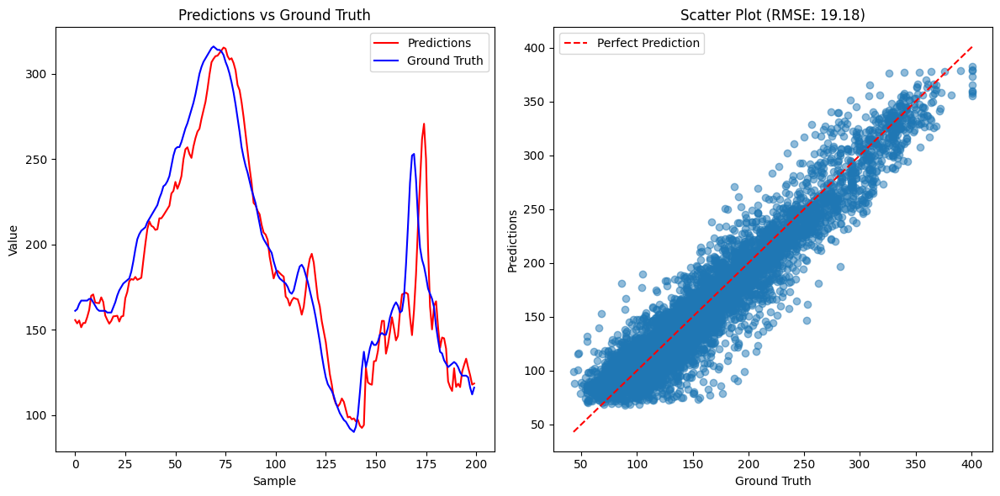

RMSE: 19.18
MAE: 14.19
MAPE: 10.28%
Test file: 1127
Root Mean Square Error (RMSE): 18.42
Mean Absolute Error (MAE): 13.51
Mean Absolute Percentage Error (MAPE): 11.17%


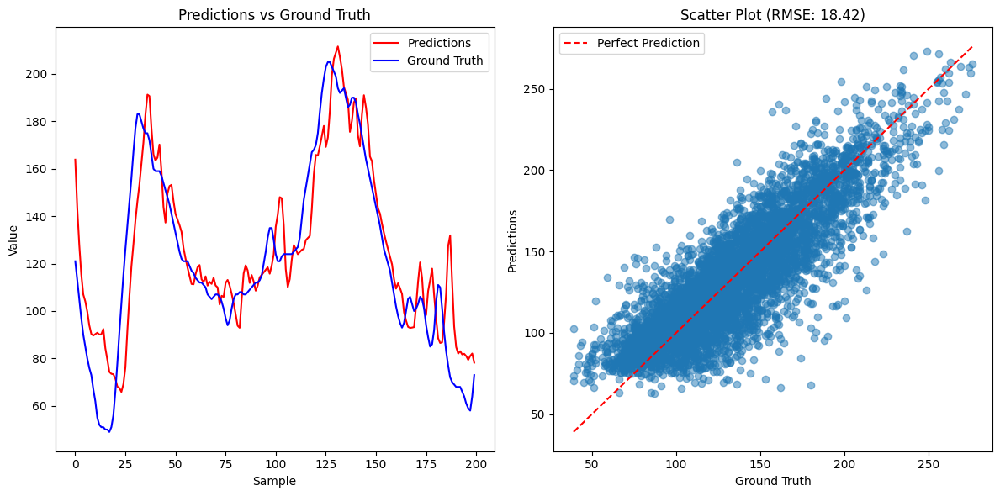

RMSE: 18.42
MAE: 13.51
MAPE: 11.17%
Test file: 1143
Root Mean Square Error (RMSE): 17.83
Mean Absolute Error (MAE): 13.03
Mean Absolute Percentage Error (MAPE): 9.39%


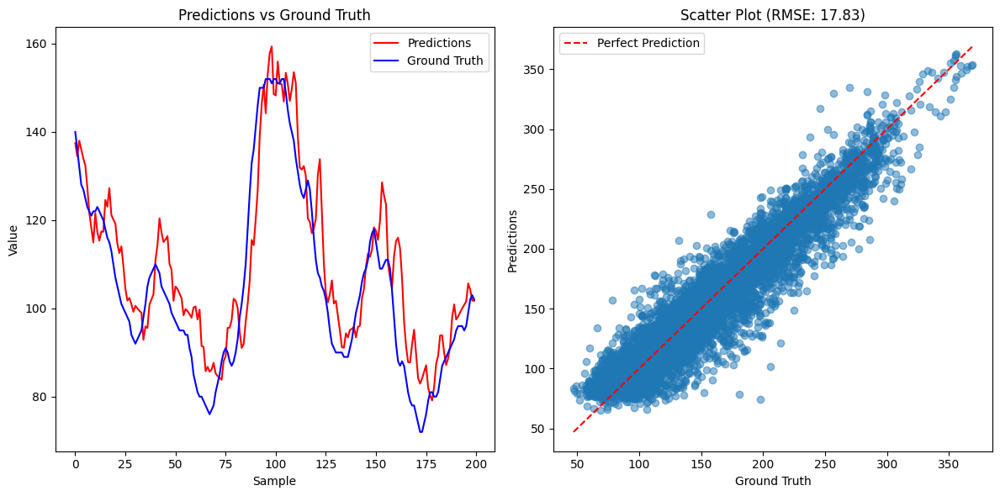

RMSE: 17.83
MAE: 13.03
MAPE: 9.39%
fold2 ['115.csv', '1171.csv', '1194.csv', '1201.csv', '1205.csv', '1211.csv', '1219.csv', '1230.csv', '1239.csv', '1271.csv', '1286.csv', '1311.csv', '1330.csv']
Model loaded from /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/saved_models_T1DEXI/5_fold/model_sh12_fold2.pth


/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py:762: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  mod

Test file: 115
Root Mean Square Error (RMSE): 22.84
Mean Absolute Error (MAE): 16.48
Mean Absolute Percentage Error (MAPE): 11.97%


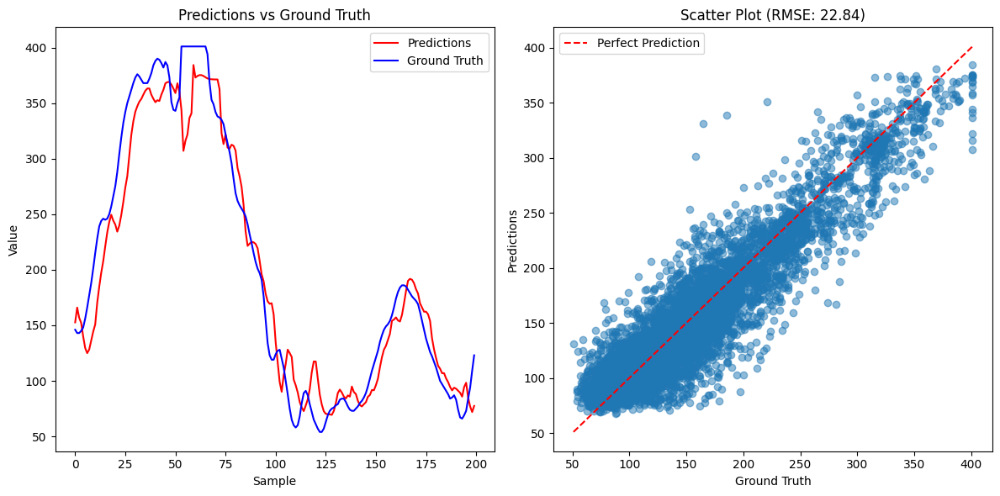

RMSE: 22.84
MAE: 16.48
MAPE: 11.97%
Test file: 1171
Root Mean Square Error (RMSE): 20.81
Mean Absolute Error (MAE): 14.98
Mean Absolute Percentage Error (MAPE): 12.41%


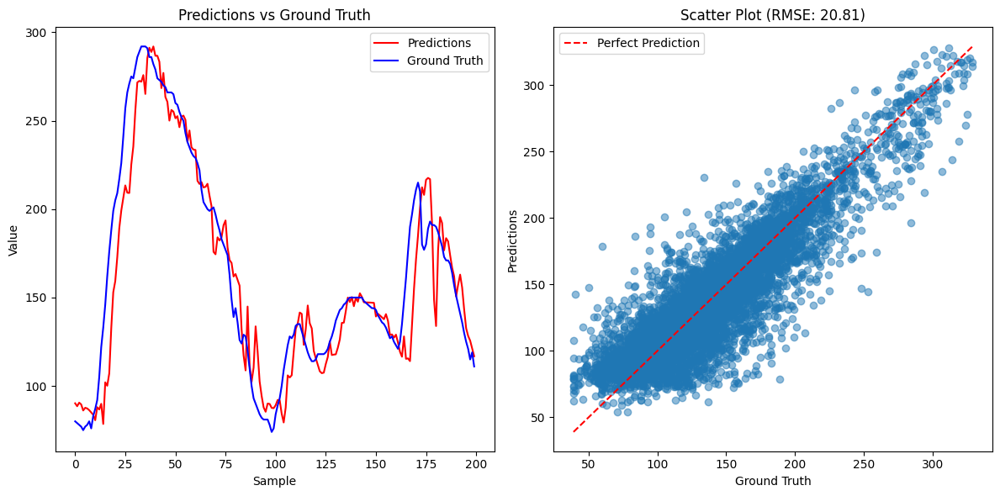

RMSE: 20.81
MAE: 14.98
MAPE: 12.41%
Test file: 1194
Root Mean Square Error (RMSE): 15.03
Mean Absolute Error (MAE): 10.96
Mean Absolute Percentage Error (MAPE): 8.64%


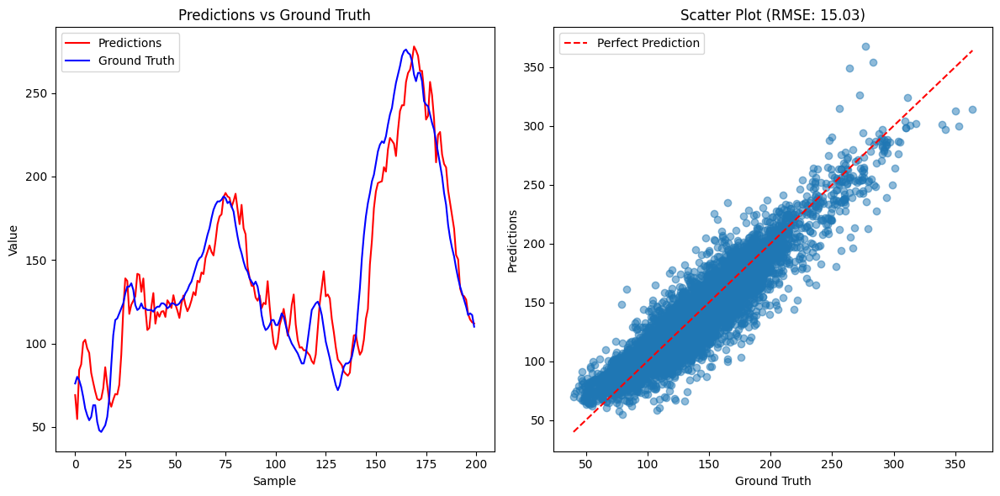

RMSE: 15.03
MAE: 10.96
MAPE: 8.64%
Test file: 1201
Root Mean Square Error (RMSE): 18.00
Mean Absolute Error (MAE): 12.77
Mean Absolute Percentage Error (MAPE): 10.41%


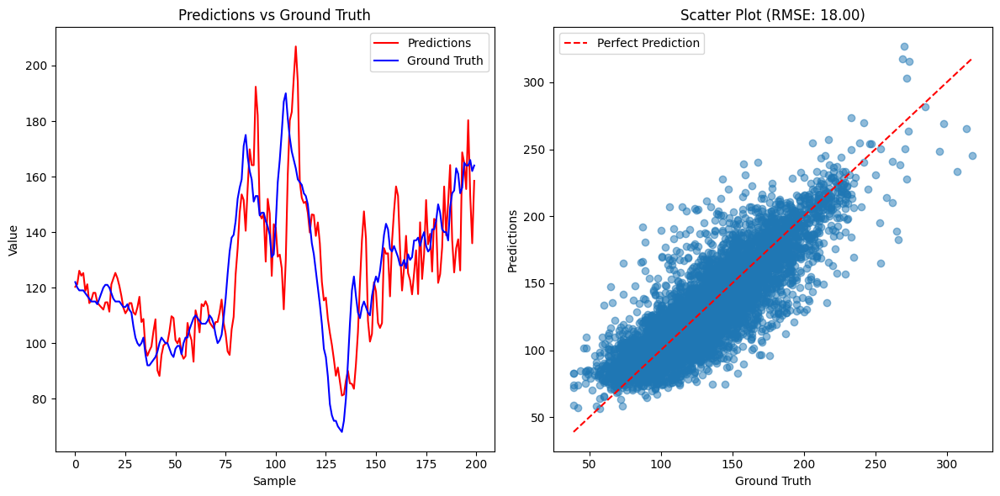

RMSE: 18.00
MAE: 12.77
MAPE: 10.41%
Test file: 1205
Root Mean Square Error (RMSE): 20.83
Mean Absolute Error (MAE): 14.19
Mean Absolute Percentage Error (MAPE): 10.02%


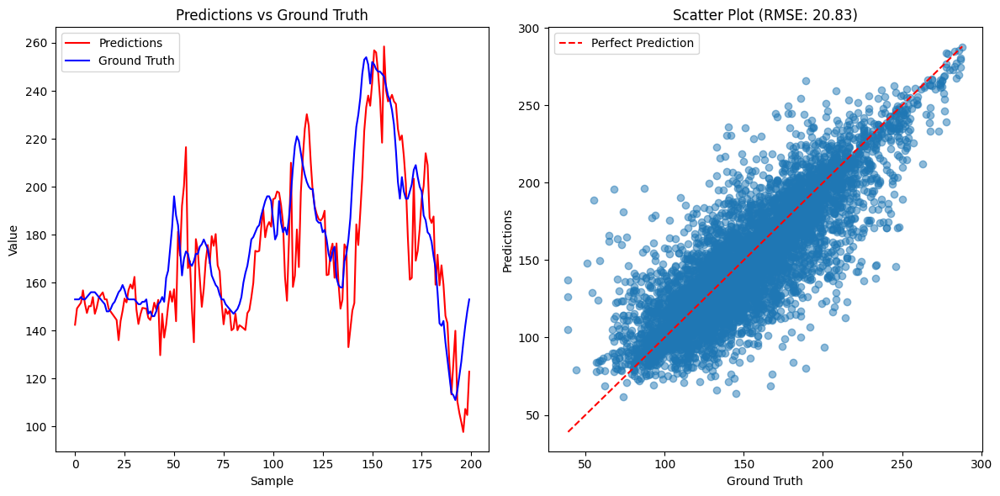

RMSE: 20.83
MAE: 14.19
MAPE: 10.02%
Test file: 1211
Root Mean Square Error (RMSE): 24.76
Mean Absolute Error (MAE): 17.35
Mean Absolute Percentage Error (MAPE): 11.75%


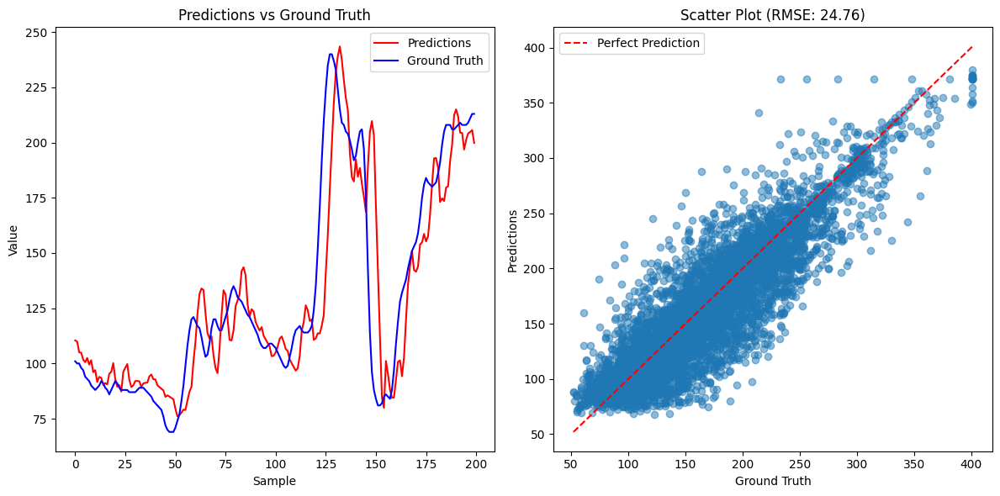

RMSE: 24.76
MAE: 17.35
MAPE: 11.75%
Test file: 1219
Root Mean Square Error (RMSE): 16.81
Mean Absolute Error (MAE): 11.96
Mean Absolute Percentage Error (MAPE): 9.73%


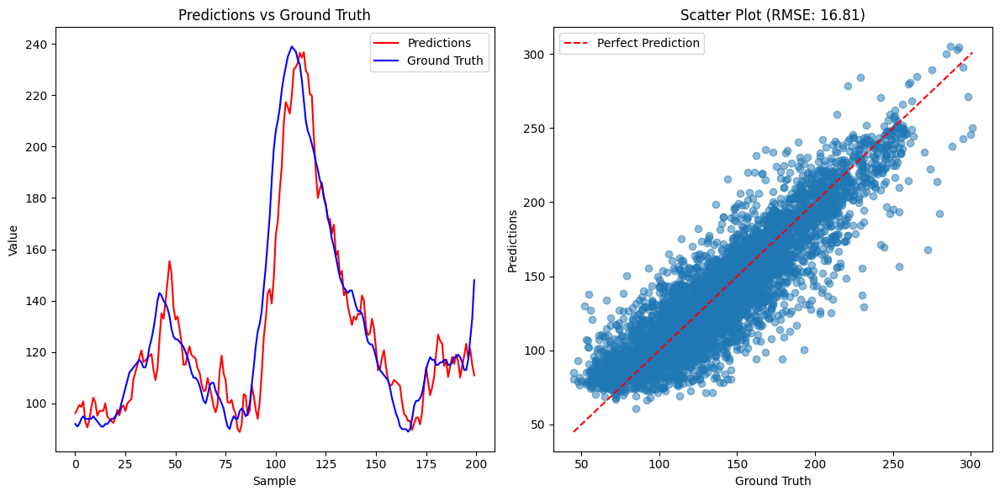

RMSE: 16.81
MAE: 11.96
MAPE: 9.73%
Test file: 1230
Root Mean Square Error (RMSE): 16.52
Mean Absolute Error (MAE): 12.05
Mean Absolute Percentage Error (MAPE): 10.60%


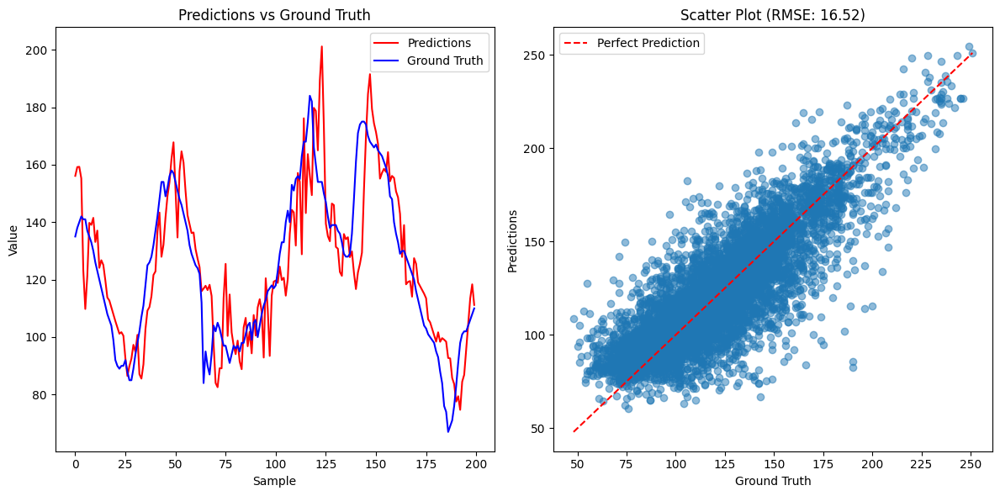

RMSE: 16.52
MAE: 12.05
MAPE: 10.60%
Test file: 1239
Root Mean Square Error (RMSE): 16.18
Mean Absolute Error (MAE): 12.07
Mean Absolute Percentage Error (MAPE): 10.05%


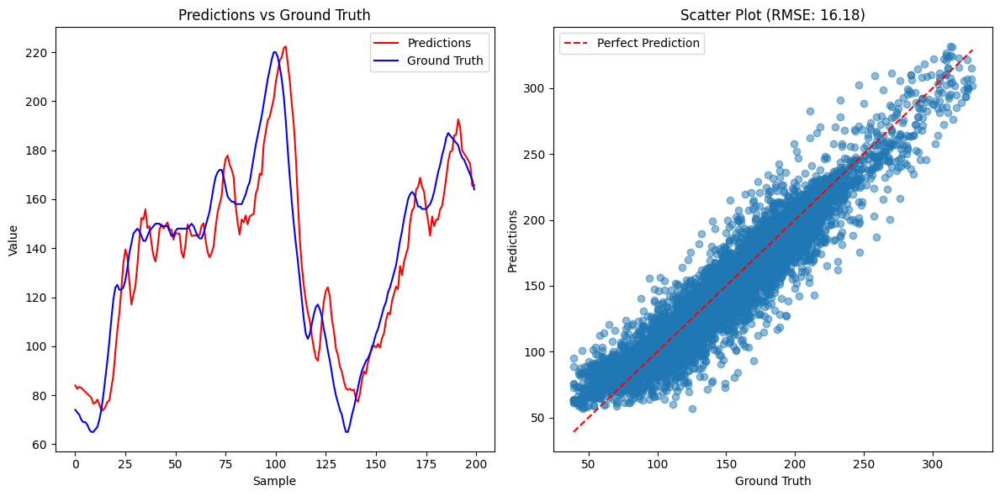

RMSE: 16.18
MAE: 12.07
MAPE: 10.05%
Test file: 1271
Root Mean Square Error (RMSE): 25.51
Mean Absolute Error (MAE): 18.17
Mean Absolute Percentage Error (MAPE): 12.32%


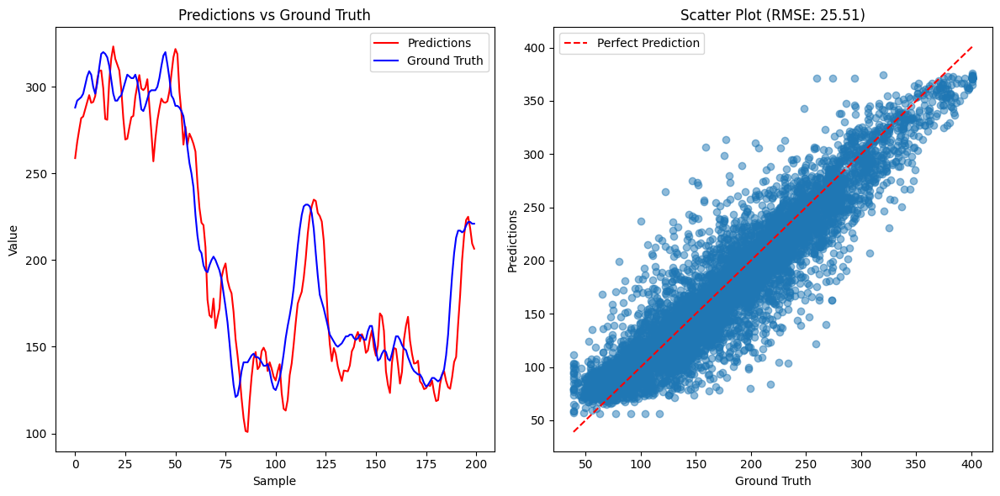

RMSE: 25.51
MAE: 18.17
MAPE: 12.32%
Test file: 1286
Root Mean Square Error (RMSE): 14.33
Mean Absolute Error (MAE): 10.28
Mean Absolute Percentage Error (MAPE): 8.20%


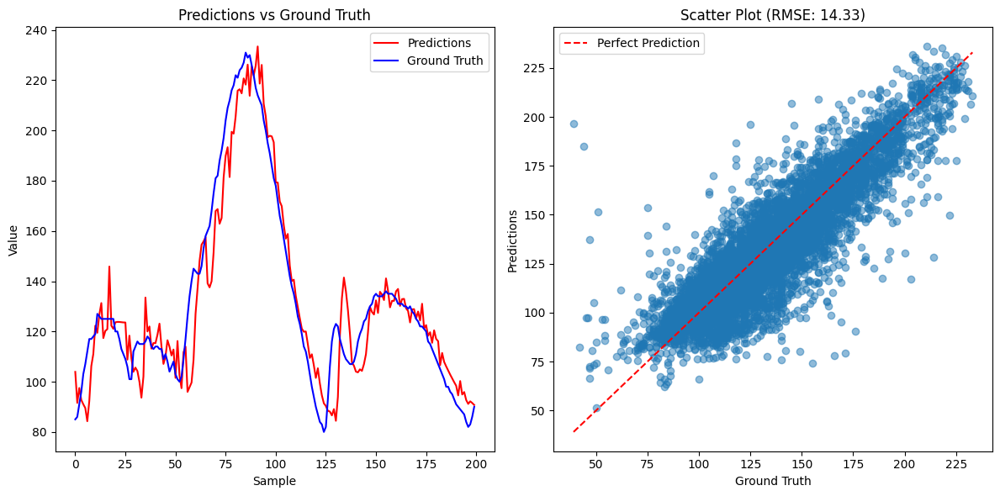

RMSE: 14.33
MAE: 10.28
MAPE: 8.20%
Test file: 1311
Root Mean Square Error (RMSE): 19.33
Mean Absolute Error (MAE): 14.27
Mean Absolute Percentage Error (MAPE): 12.21%


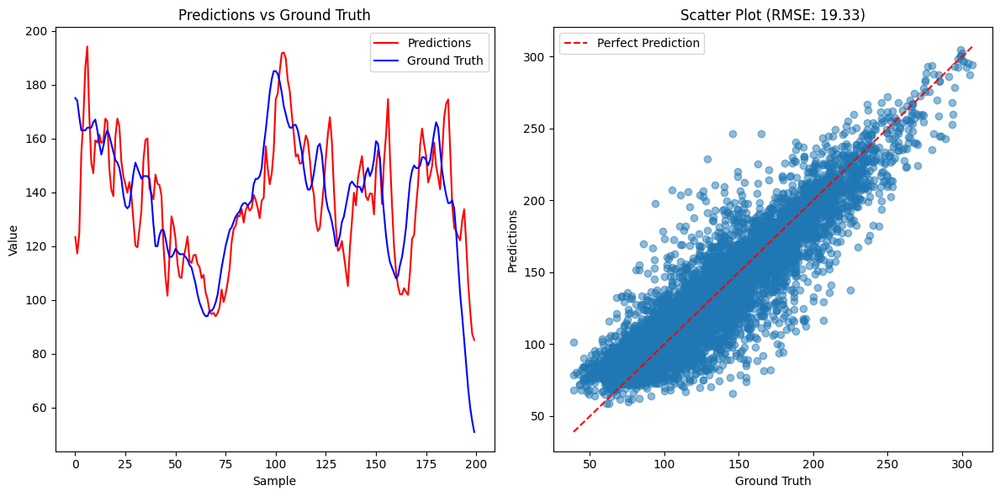

RMSE: 19.33
MAE: 14.27
MAPE: 12.21%
Test file: 1330
Root Mean Square Error (RMSE): 21.08
Mean Absolute Error (MAE): 14.69
Mean Absolute Percentage Error (MAPE): 11.14%


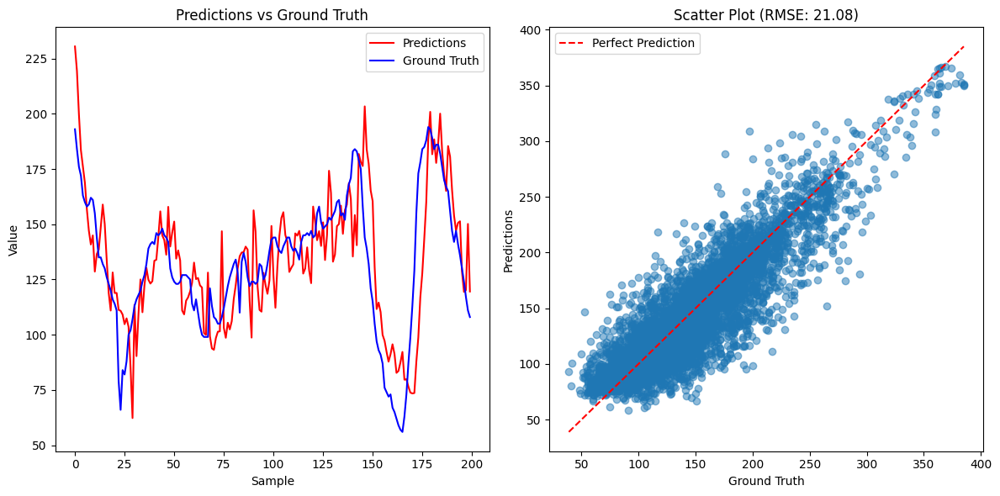

RMSE: 21.08
MAE: 14.69
MAPE: 11.14%
fold3 ['1336.csv', '1343.csv', '1345.csv', '1348.csv', '1361.csv', '1362.csv', '1363.csv', '1377.csv', '1381.csv', '1386.csv', '1408.csv', '1422.csv', '1427.csv']
Model loaded from /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/saved_models_T1DEXI/5_fold/model_sh12_fold3.pth


/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py:762: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  mod

Test file: 1336
Root Mean Square Error (RMSE): 24.87
Mean Absolute Error (MAE): 17.62
Mean Absolute Percentage Error (MAPE): 13.93%


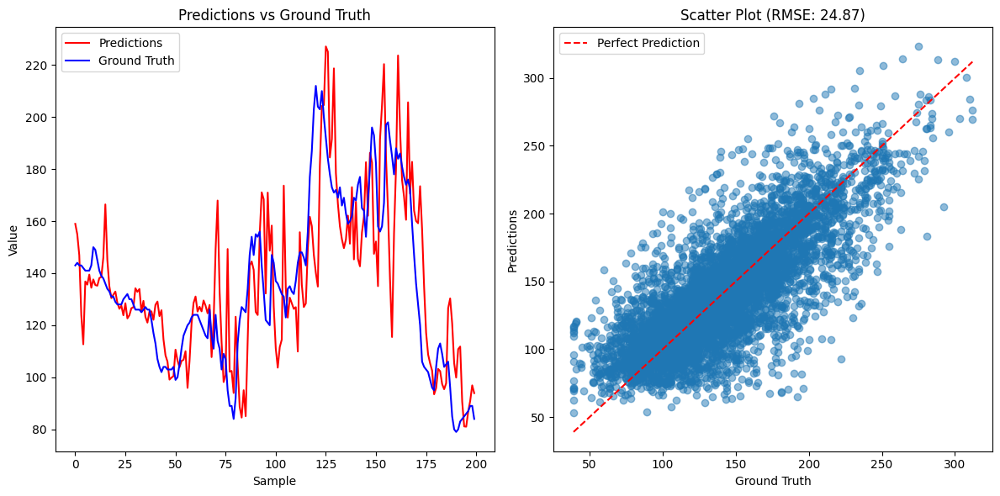

RMSE: 24.87
MAE: 17.62
MAPE: 13.93%
Test file: 1343
Root Mean Square Error (RMSE): 13.84
Mean Absolute Error (MAE): 10.19
Mean Absolute Percentage Error (MAPE): 9.73%


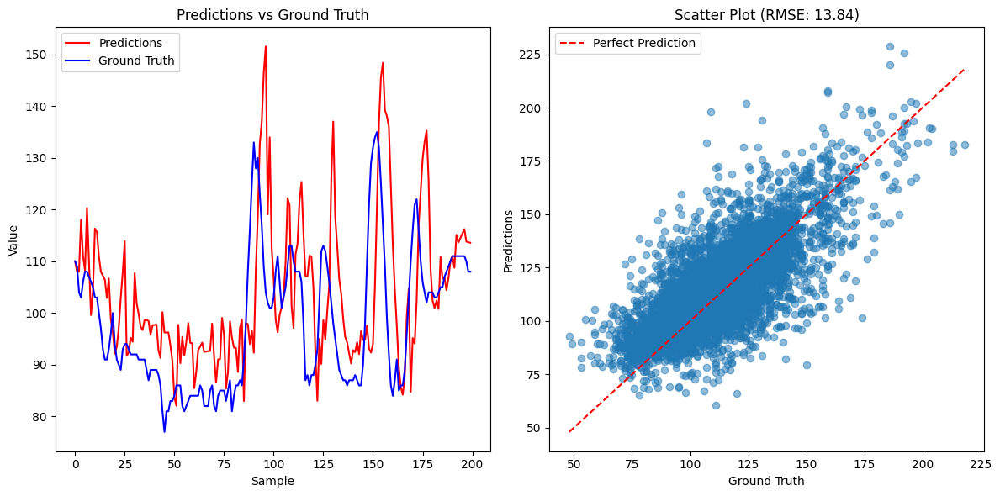

RMSE: 13.84
MAE: 10.19
MAPE: 9.73%
Test file: 1345
Root Mean Square Error (RMSE): 21.38
Mean Absolute Error (MAE): 15.70
Mean Absolute Percentage Error (MAPE): 12.59%


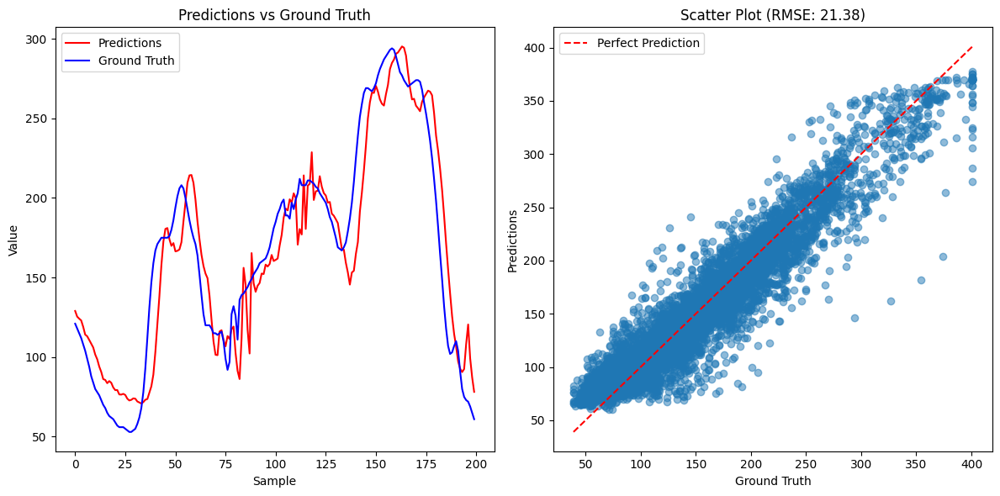

RMSE: 21.38
MAE: 15.70
MAPE: 12.59%
Test file: 1348
Root Mean Square Error (RMSE): 34.82
Mean Absolute Error (MAE): 24.48
Mean Absolute Percentage Error (MAPE): 13.72%


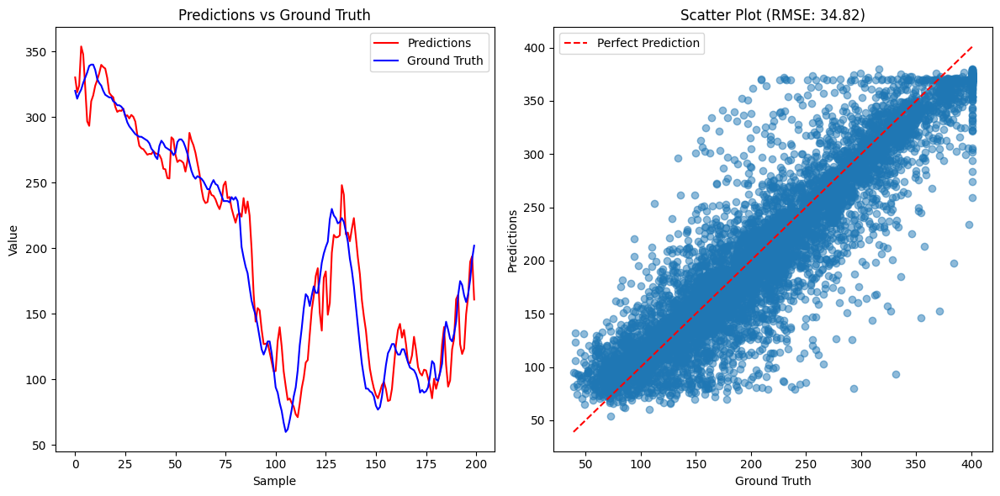

RMSE: 34.82
MAE: 24.48
MAPE: 13.72%
Test file: 1361
Root Mean Square Error (RMSE): 19.02
Mean Absolute Error (MAE): 14.19
Mean Absolute Percentage Error (MAPE): 13.95%


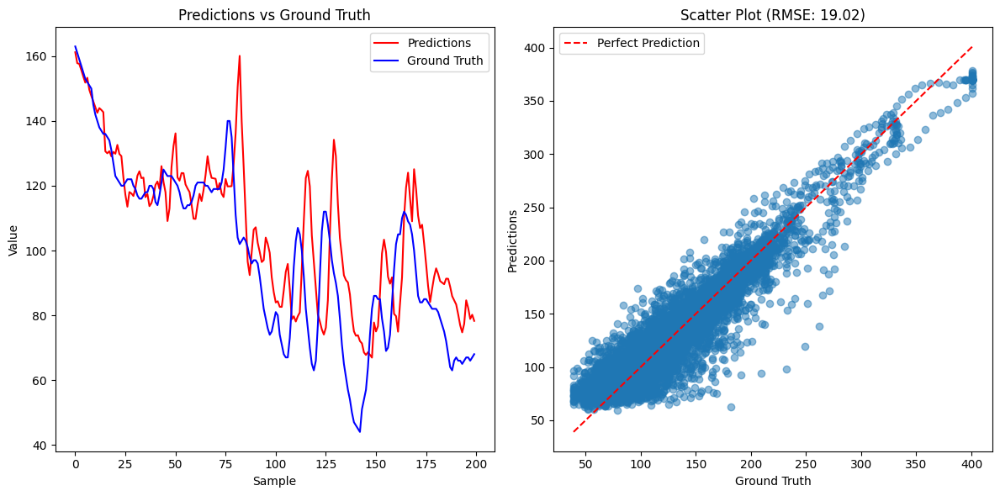

RMSE: 19.02
MAE: 14.19
MAPE: 13.95%
Test file: 1362
Root Mean Square Error (RMSE): 16.85
Mean Absolute Error (MAE): 12.42
Mean Absolute Percentage Error (MAPE): 11.16%


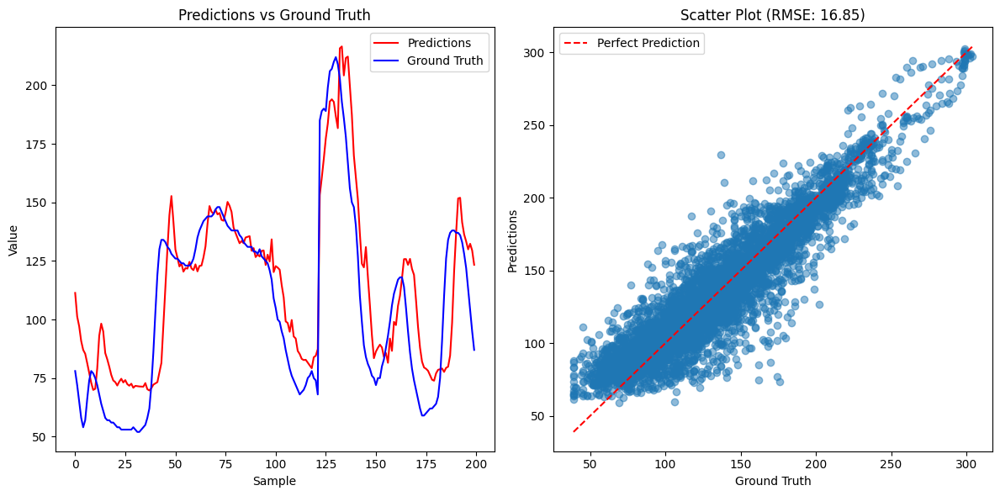

RMSE: 16.85
MAE: 12.42
MAPE: 11.16%
Test file: 1363
Root Mean Square Error (RMSE): 20.84
Mean Absolute Error (MAE): 14.81
Mean Absolute Percentage Error (MAPE): 10.34%


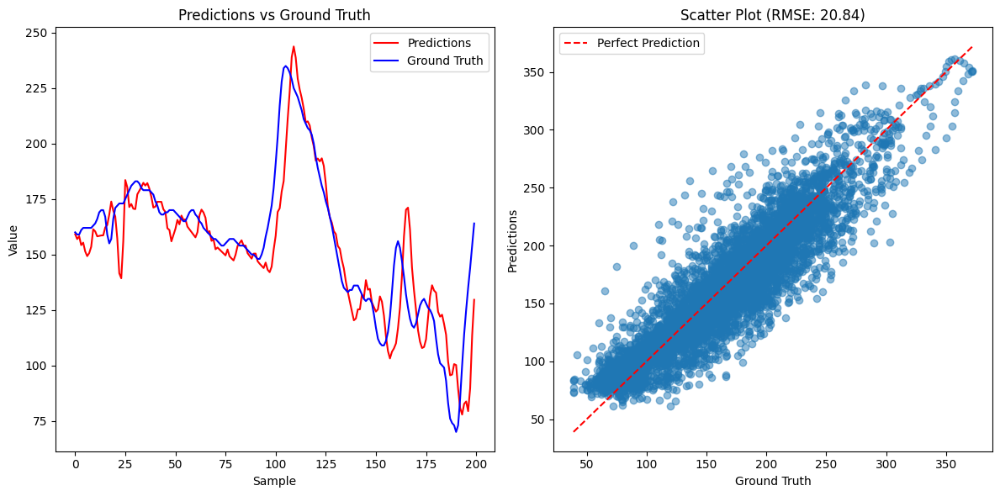

RMSE: 20.84
MAE: 14.81
MAPE: 10.34%
Test file: 1377
Root Mean Square Error (RMSE): 20.44
Mean Absolute Error (MAE): 15.09
Mean Absolute Percentage Error (MAPE): 11.77%


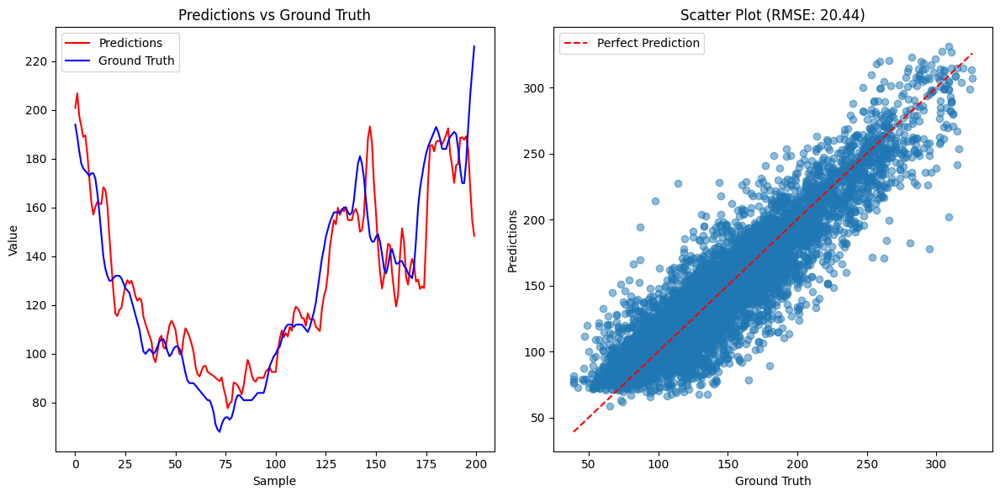

RMSE: 20.44
MAE: 15.09
MAPE: 11.77%
Test file: 1381
Root Mean Square Error (RMSE): 18.83
Mean Absolute Error (MAE): 13.29
Mean Absolute Percentage Error (MAPE): 9.90%


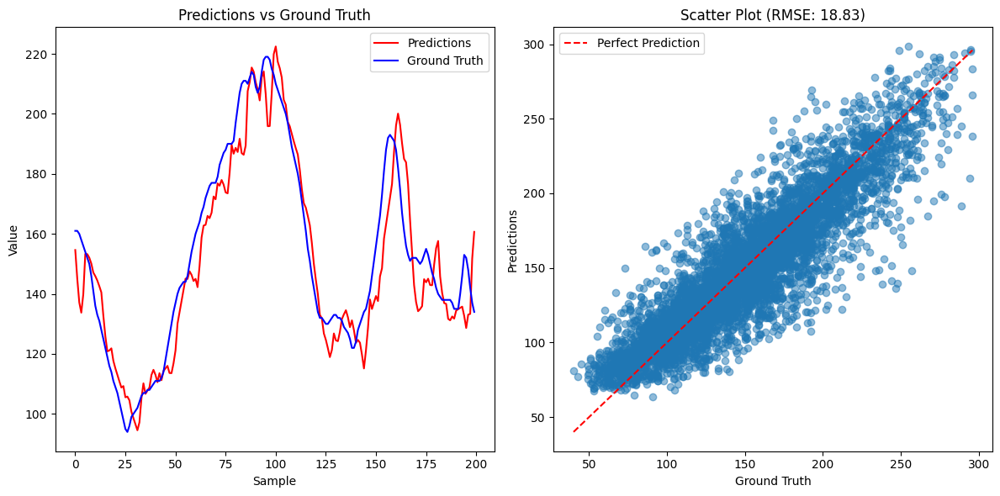

RMSE: 18.83
MAE: 13.29
MAPE: 9.90%
Test file: 1386
Root Mean Square Error (RMSE): 23.37
Mean Absolute Error (MAE): 17.18
Mean Absolute Percentage Error (MAPE): 15.53%


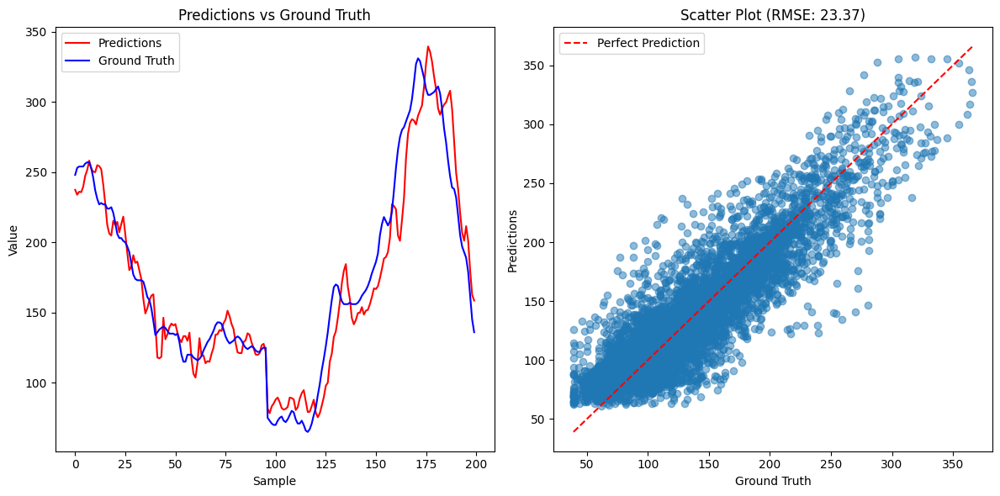

RMSE: 23.37
MAE: 17.18
MAPE: 15.53%
Test file: 1408
Root Mean Square Error (RMSE): 26.72
Mean Absolute Error (MAE): 18.81
Mean Absolute Percentage Error (MAPE): 12.47%


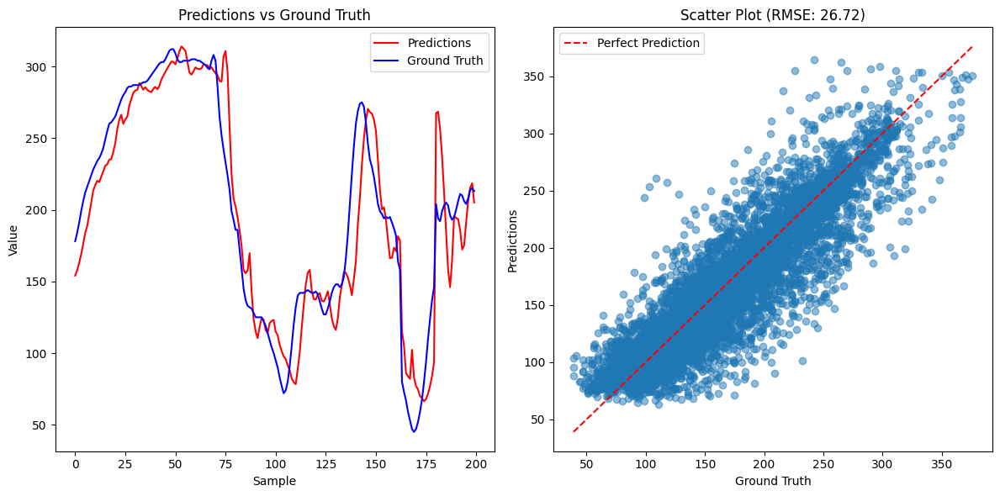

RMSE: 26.72
MAE: 18.81
MAPE: 12.47%
Test file: 1422
Root Mean Square Error (RMSE): 22.85
Mean Absolute Error (MAE): 16.74
Mean Absolute Percentage Error (MAPE): 12.03%


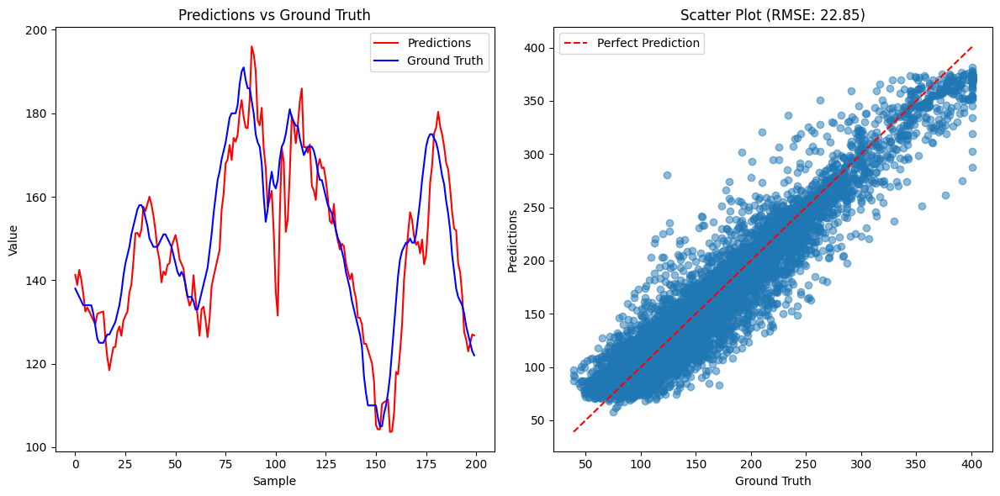

RMSE: 22.85
MAE: 16.74
MAPE: 12.03%
Test file: 1427
Root Mean Square Error (RMSE): 21.92
Mean Absolute Error (MAE): 16.58
Mean Absolute Percentage Error (MAPE): 16.71%


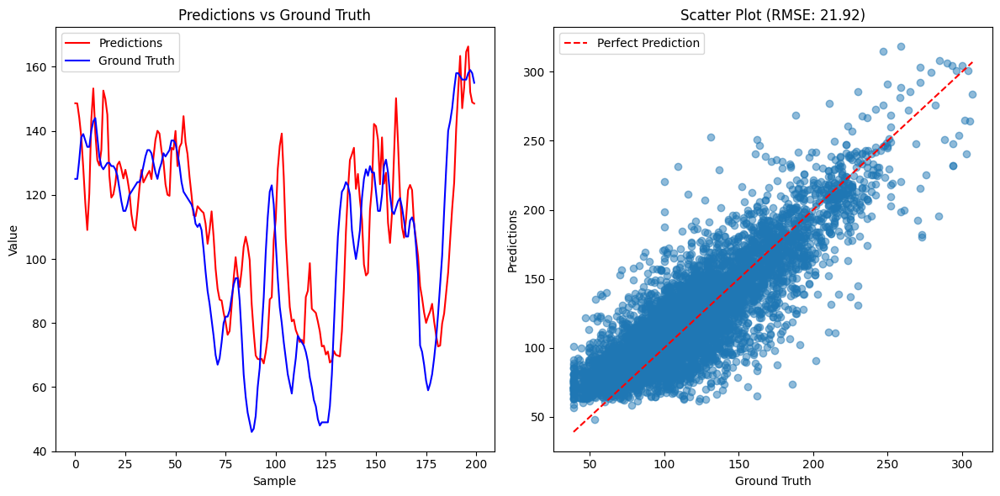

RMSE: 21.92
MAE: 16.58
MAPE: 16.71%
fold4 ['1433.csv', '1435.csv', '144.csv', '1457.csv', '1459.csv', '1484.csv', '1503.csv', '152.csv', '1554.csv', '1558.csv', '1636.csv', '1650.csv']


/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py:762: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  mod

Model loaded from /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/saved_models_T1DEXI/5_fold/model_sh12_fold4.pth
Test file: 1433
Root Mean Square Error (RMSE): 20.77
Mean Absolute Error (MAE): 14.43
Mean Absolute Percentage Error (MAPE): 13.83%


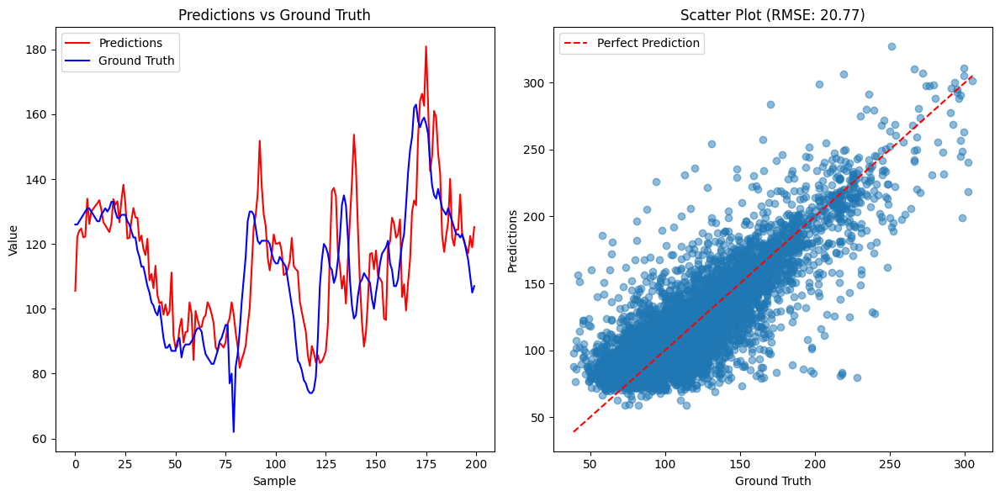

RMSE: 20.77
MAE: 14.43
MAPE: 13.83%
Test file: 1435
Root Mean Square Error (RMSE): 17.22
Mean Absolute Error (MAE): 12.11
Mean Absolute Percentage Error (MAPE): 7.31%


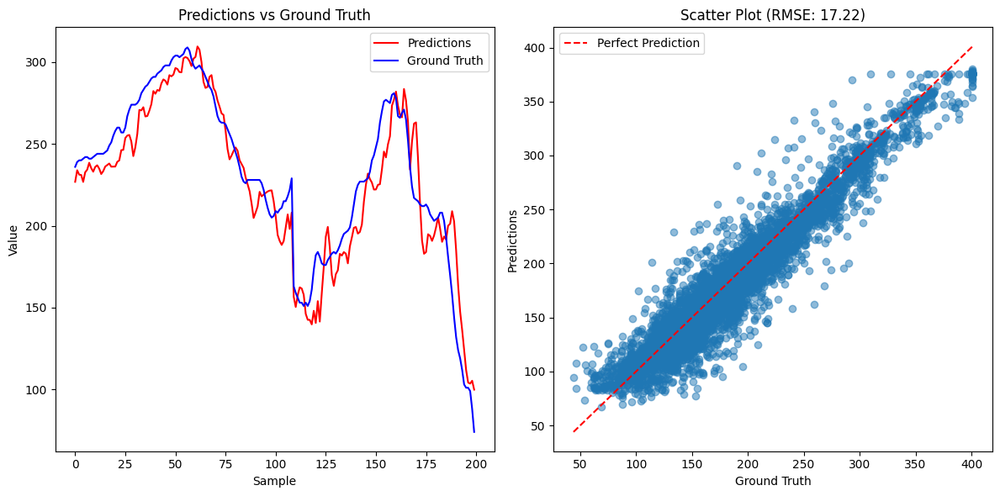

RMSE: 17.22
MAE: 12.11
MAPE: 7.31%
Test file: 144
Root Mean Square Error (RMSE): 17.33
Mean Absolute Error (MAE): 12.23
Mean Absolute Percentage Error (MAPE): 8.21%


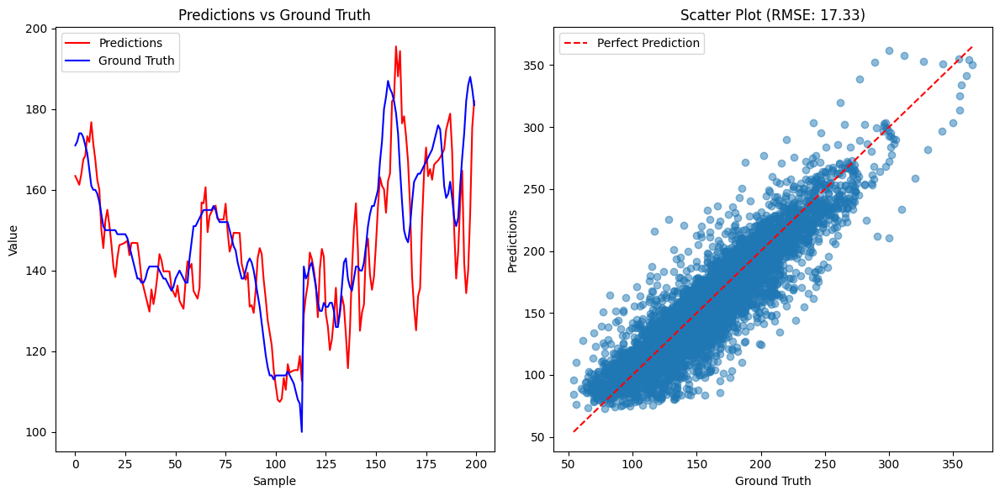

RMSE: 17.33
MAE: 12.23
MAPE: 8.21%
Test file: 1457
Root Mean Square Error (RMSE): 22.67
Mean Absolute Error (MAE): 16.68
Mean Absolute Percentage Error (MAPE): 14.13%


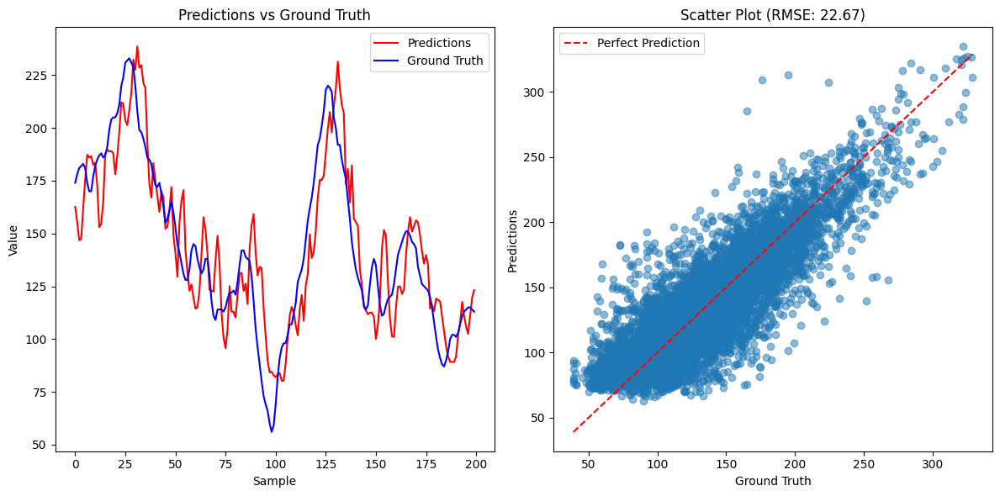

RMSE: 22.67
MAE: 16.68
MAPE: 14.13%
Test file: 1459
Root Mean Square Error (RMSE): 22.96
Mean Absolute Error (MAE): 17.53
Mean Absolute Percentage Error (MAPE): 13.50%


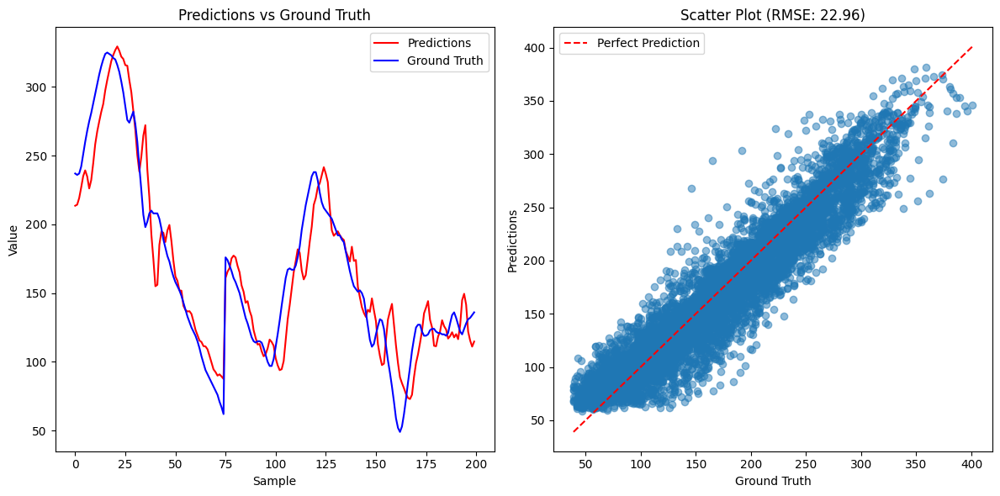

RMSE: 22.96
MAE: 17.53
MAPE: 13.50%
Test file: 1484
Root Mean Square Error (RMSE): 22.38
Mean Absolute Error (MAE): 15.50
Mean Absolute Percentage Error (MAPE): 8.86%


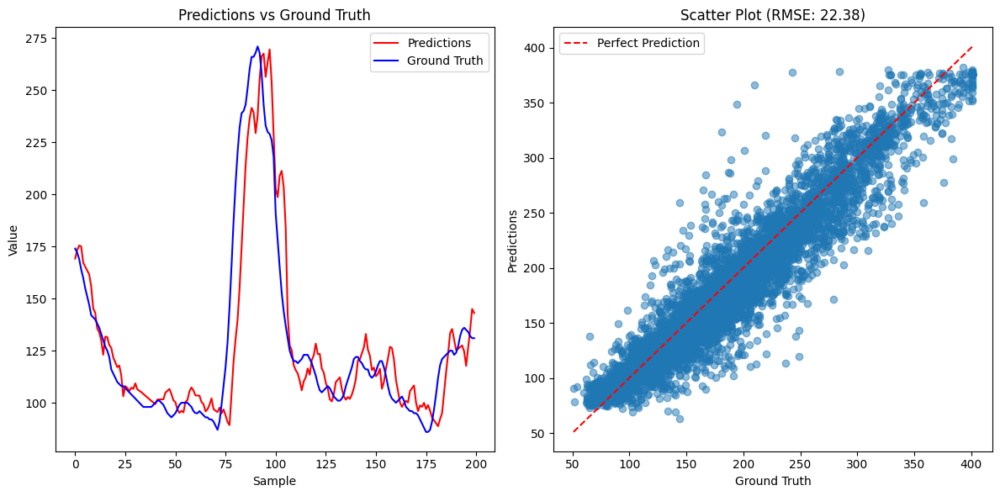

RMSE: 22.38
MAE: 15.50
MAPE: 8.86%
Test file: 1503
Root Mean Square Error (RMSE): 20.38
Mean Absolute Error (MAE): 14.93
Mean Absolute Percentage Error (MAPE): 11.00%


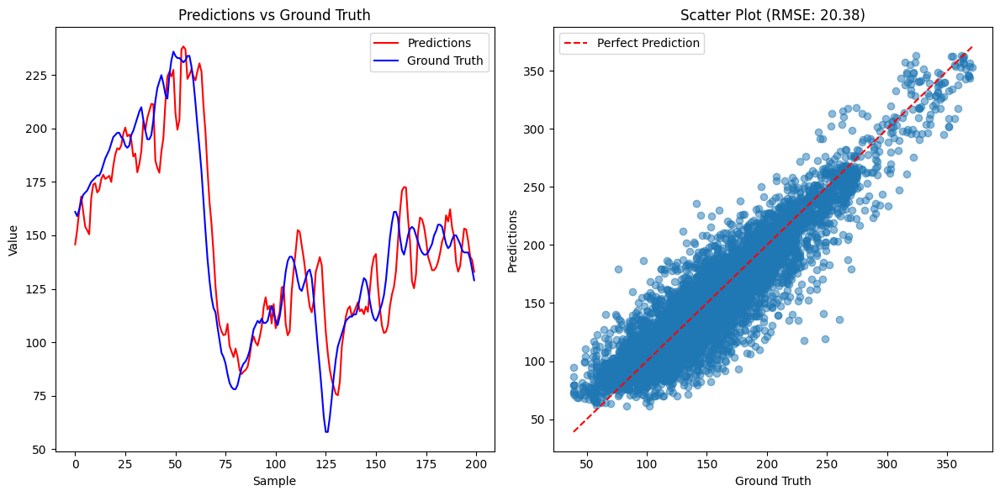

RMSE: 20.38
MAE: 14.93
MAPE: 11.00%
Test file: 152
Root Mean Square Error (RMSE): 24.11
Mean Absolute Error (MAE): 16.99
Mean Absolute Percentage Error (MAPE): 13.62%


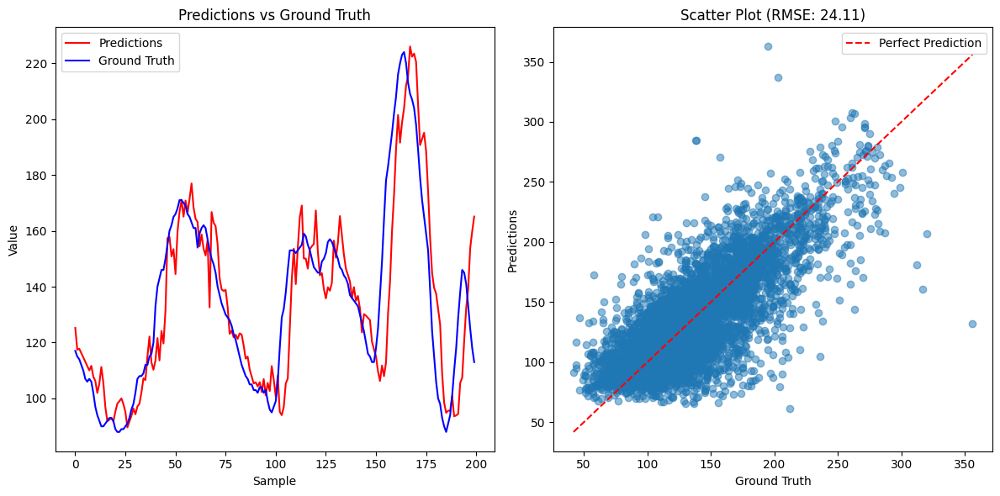

RMSE: 24.11
MAE: 16.99
MAPE: 13.62%
Test file: 1554
Root Mean Square Error (RMSE): 23.56
Mean Absolute Error (MAE): 16.72
Mean Absolute Percentage Error (MAPE): 13.33%


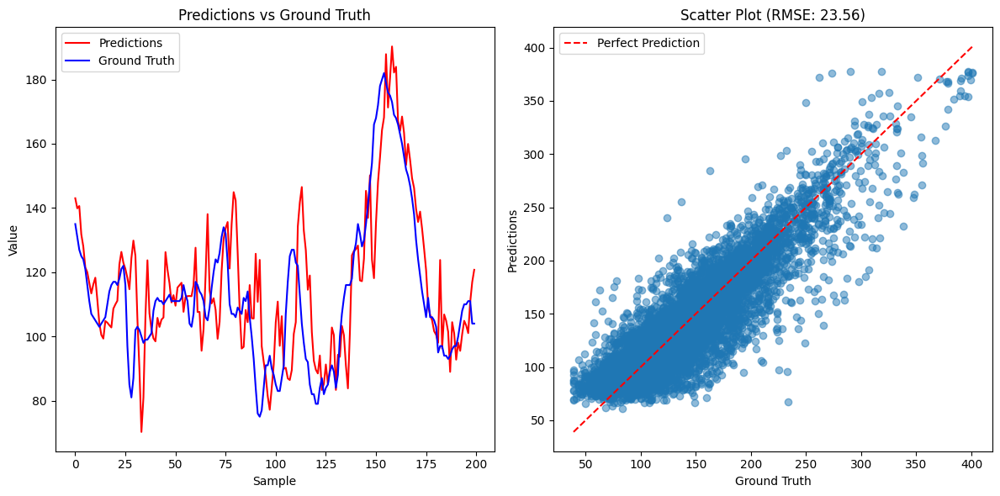

RMSE: 23.56
MAE: 16.72
MAPE: 13.33%
Test file: 1558
Root Mean Square Error (RMSE): 29.97
Mean Absolute Error (MAE): 20.27
Mean Absolute Percentage Error (MAPE): 15.80%


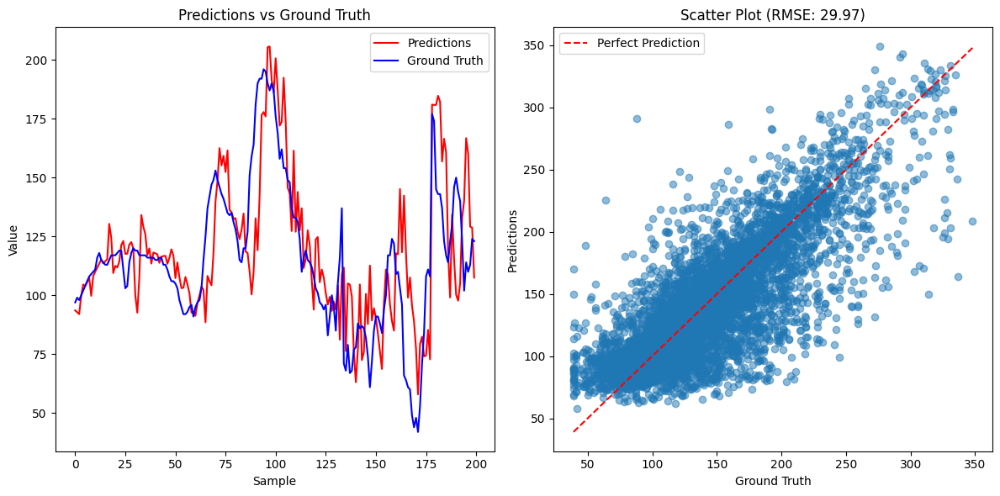

RMSE: 29.97
MAE: 20.27
MAPE: 15.80%
Test file: 1636
Root Mean Square Error (RMSE): 15.76
Mean Absolute Error (MAE): 11.11
Mean Absolute Percentage Error (MAPE): 7.33%


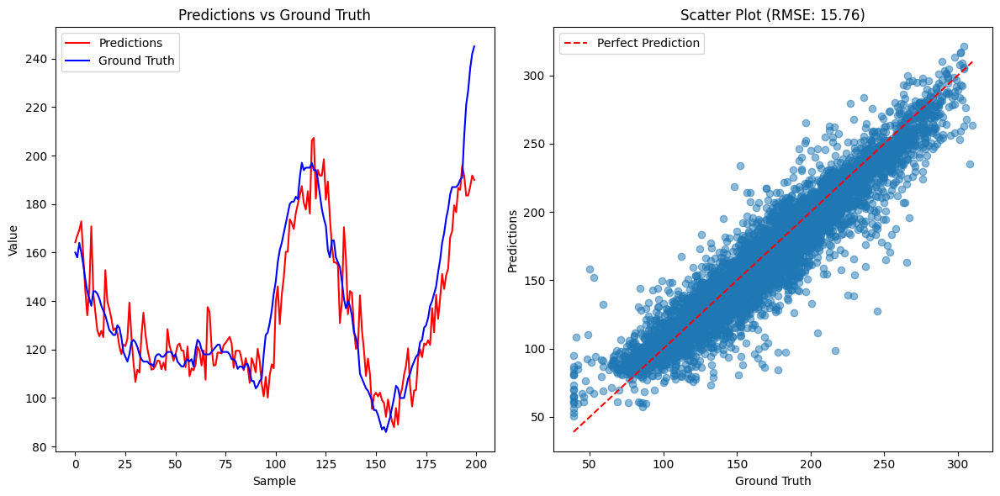

RMSE: 15.76
MAE: 11.11
MAPE: 7.33%
Test file: 1650
Root Mean Square Error (RMSE): 16.69
Mean Absolute Error (MAE): 11.48
Mean Absolute Percentage Error (MAPE): 9.13%


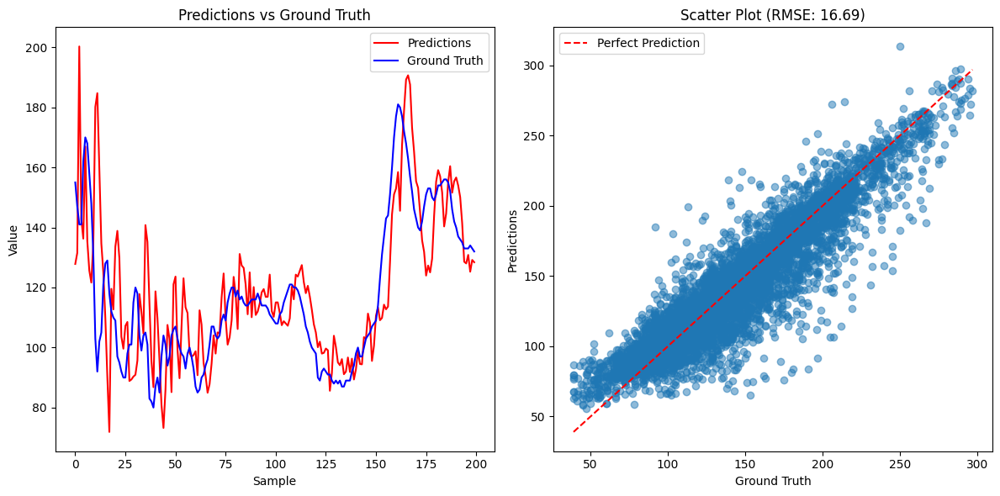

RMSE: 16.69
MAE: 11.48
MAPE: 9.13%
fold5 ['1683.csv', '1689.csv', '1695.csv', '1722.csv', '1726.csv', '173.csv', '18.csv', '187.csv', '24.csv', '248.csv', '25.csv', '252.csv']


/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py:762: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  mod

Model loaded from /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/saved_models_T1DEXI/5_fold/model_sh12_fold5.pth
Test file: 1683
Root Mean Square Error (RMSE): 21.76
Mean Absolute Error (MAE): 15.17
Mean Absolute Percentage Error (MAPE): 10.88%


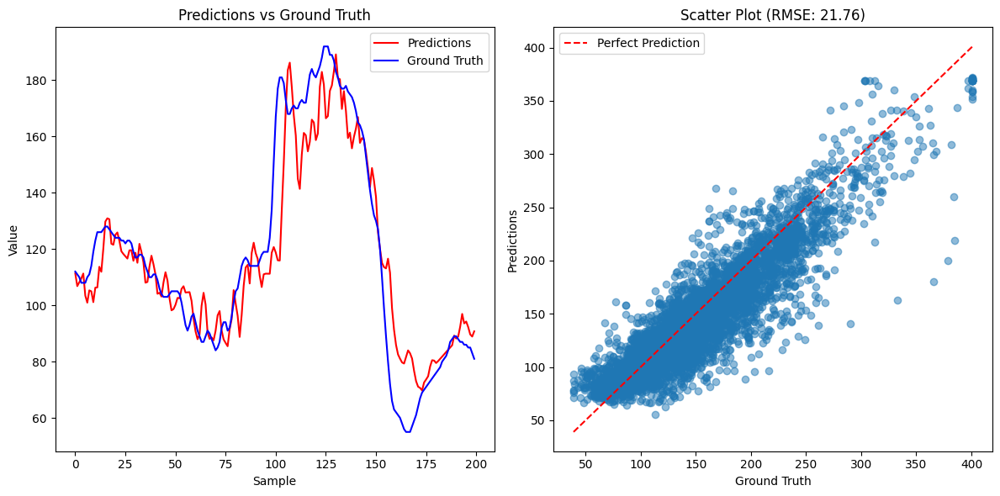

RMSE: 21.76
MAE: 15.17
MAPE: 10.88%
Test file: 1689
Root Mean Square Error (RMSE): 22.21
Mean Absolute Error (MAE): 16.30
Mean Absolute Percentage Error (MAPE): 9.74%


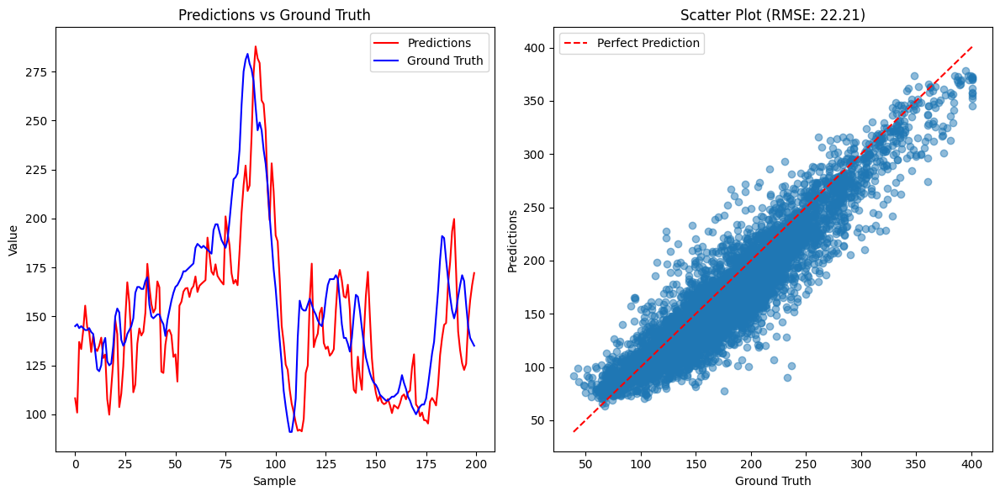

RMSE: 22.21
MAE: 16.30
MAPE: 9.74%
Test file: 1695
Root Mean Square Error (RMSE): 19.07
Mean Absolute Error (MAE): 13.73
Mean Absolute Percentage Error (MAPE): 11.53%


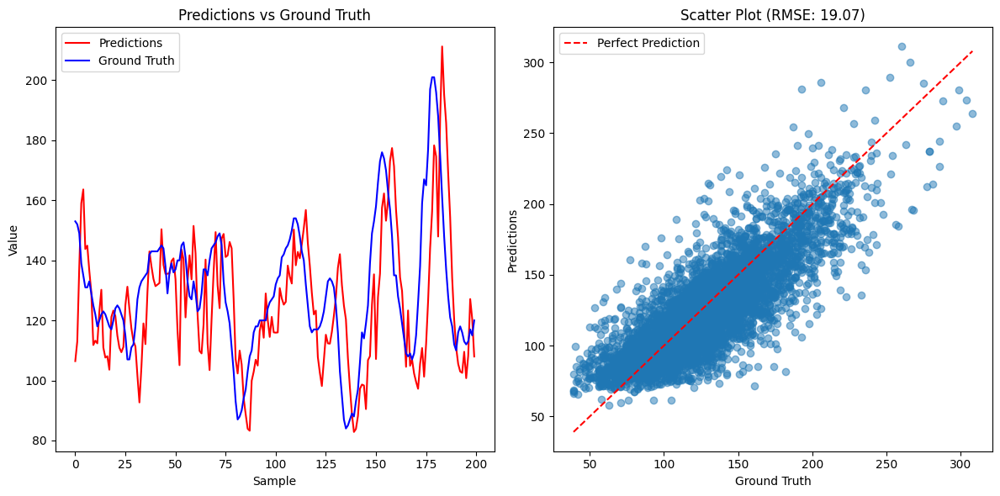

RMSE: 19.07
MAE: 13.73
MAPE: 11.53%
Test file: 1722
Root Mean Square Error (RMSE): 20.86
Mean Absolute Error (MAE): 15.46
Mean Absolute Percentage Error (MAPE): 10.03%


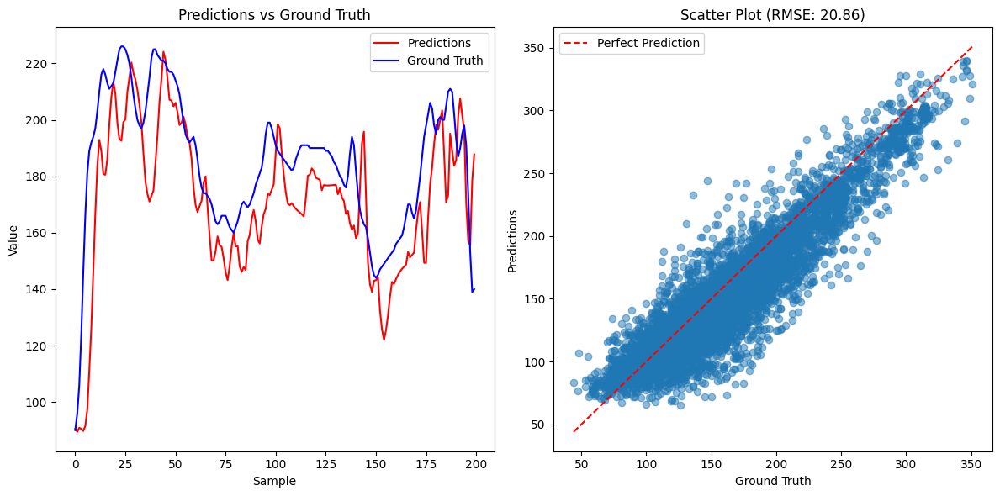

RMSE: 20.86
MAE: 15.46
MAPE: 10.03%
Test file: 1726
Root Mean Square Error (RMSE): 18.30
Mean Absolute Error (MAE): 13.53
Mean Absolute Percentage Error (MAPE): 8.44%


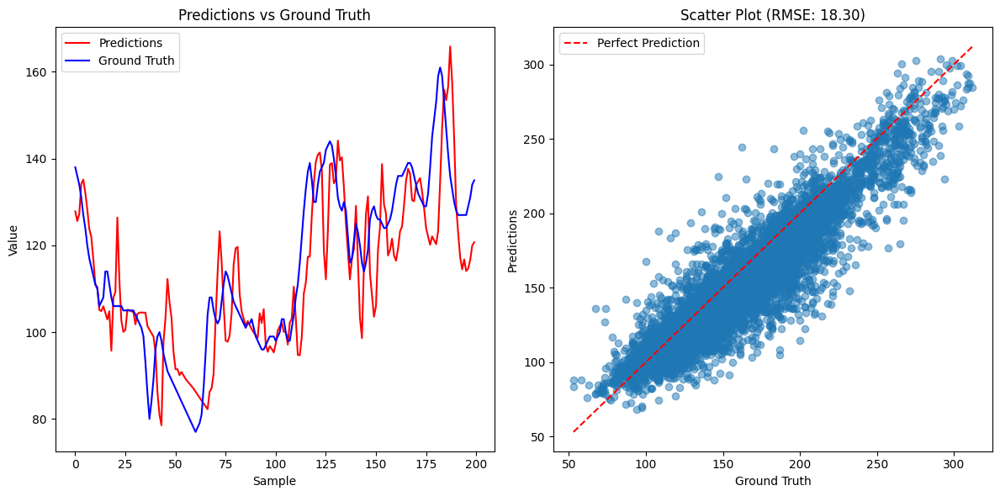

RMSE: 18.30
MAE: 13.53
MAPE: 8.44%
Test file: 173
Root Mean Square Error (RMSE): 19.54
Mean Absolute Error (MAE): 14.04
Mean Absolute Percentage Error (MAPE): 11.13%


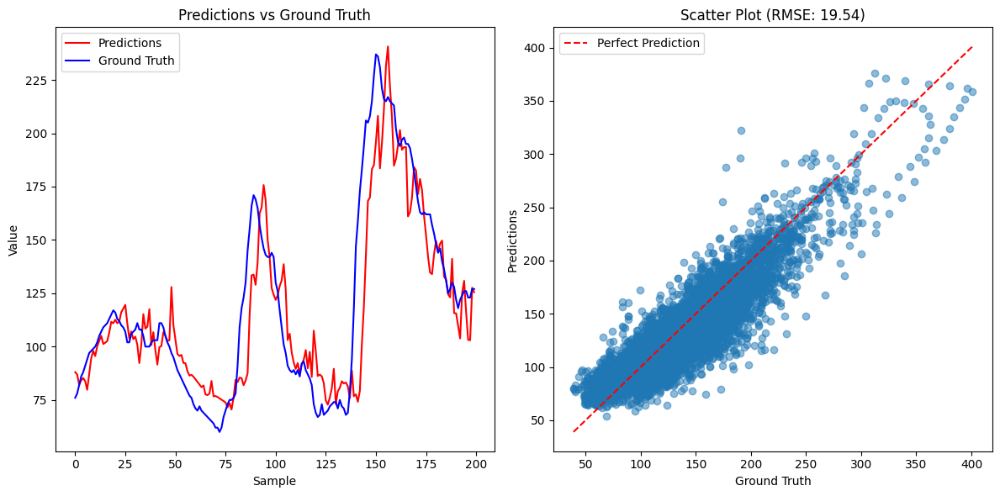

RMSE: 19.54
MAE: 14.04
MAPE: 11.13%
Test file: 18
Root Mean Square Error (RMSE): 20.95
Mean Absolute Error (MAE): 15.43
Mean Absolute Percentage Error (MAPE): 11.11%


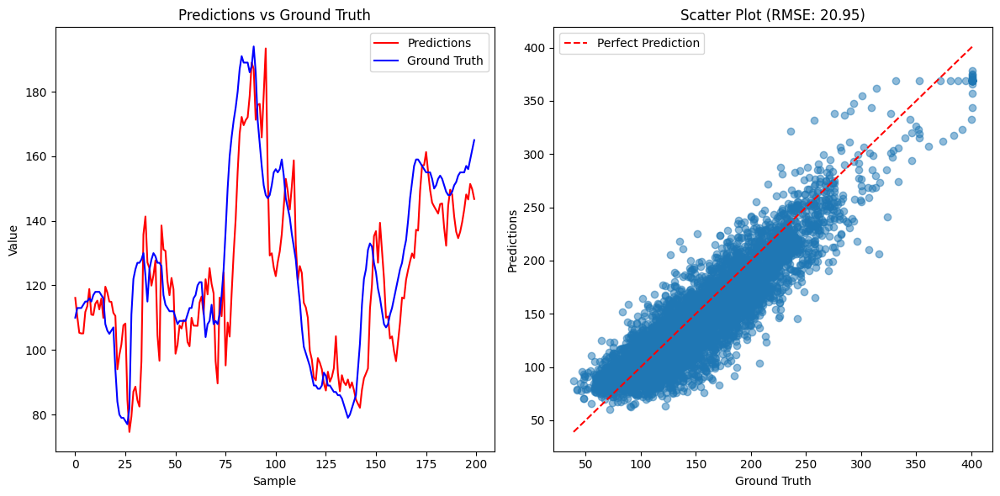

RMSE: 20.95
MAE: 15.43
MAPE: 11.11%
Test file: 187
Root Mean Square Error (RMSE): 24.43
Mean Absolute Error (MAE): 18.07
Mean Absolute Percentage Error (MAPE): 11.87%


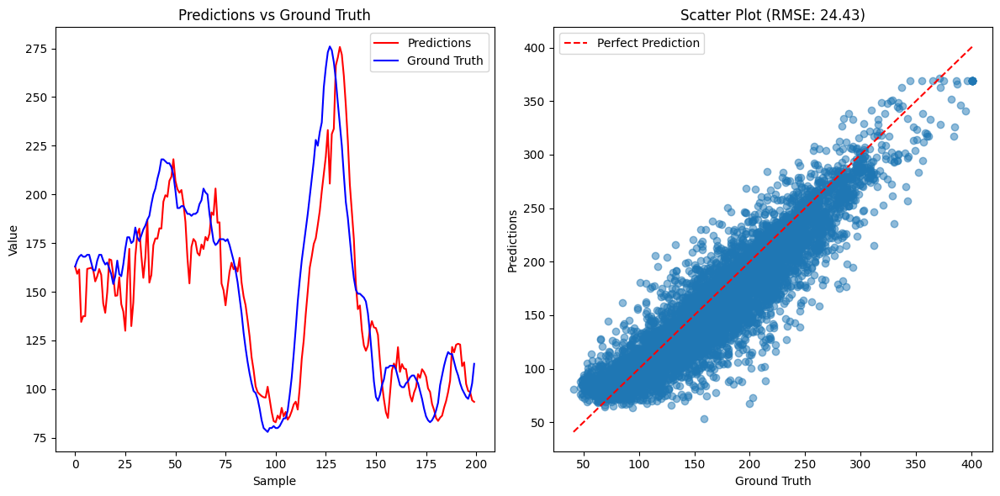

RMSE: 24.43
MAE: 18.07
MAPE: 11.87%
Test file: 24
Root Mean Square Error (RMSE): 21.97
Mean Absolute Error (MAE): 16.23
Mean Absolute Percentage Error (MAPE): 14.01%


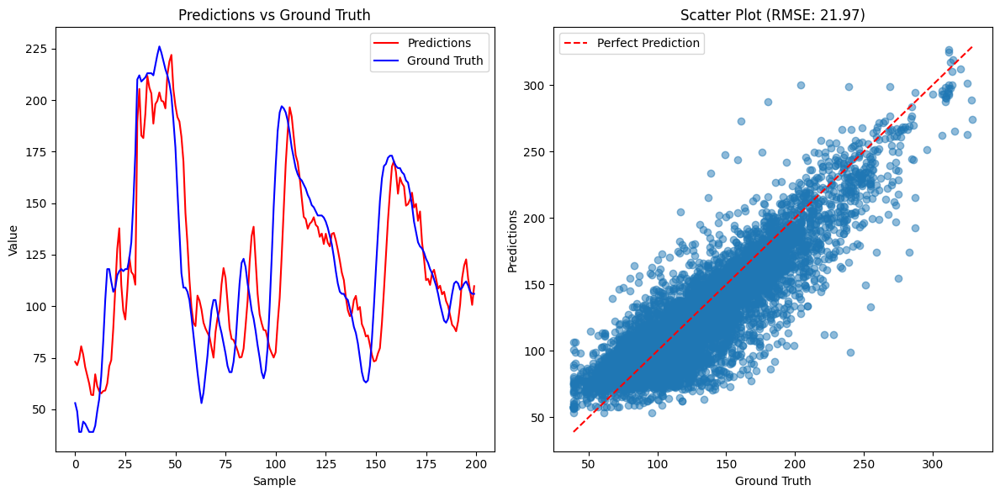

RMSE: 21.97
MAE: 16.23
MAPE: 14.01%
Test file: 248
Root Mean Square Error (RMSE): 15.94
Mean Absolute Error (MAE): 12.03
Mean Absolute Percentage Error (MAPE): 11.92%


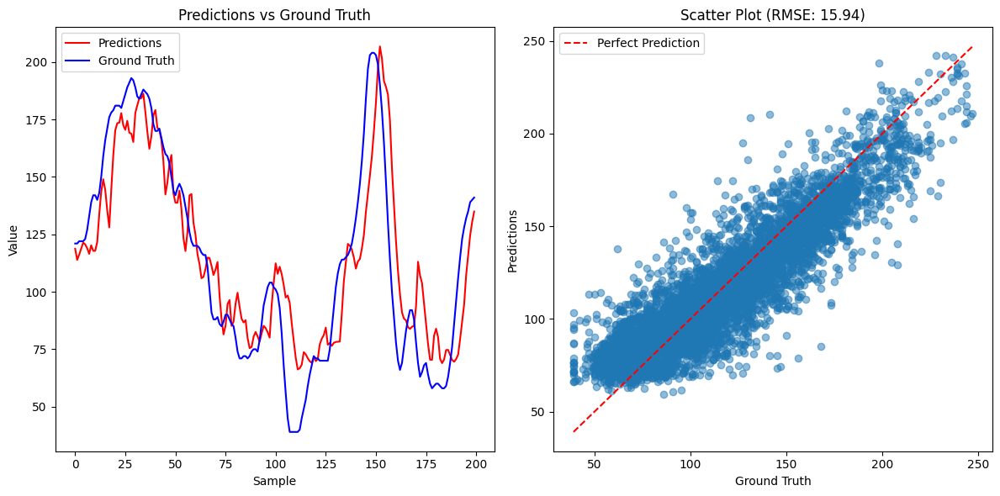

RMSE: 15.94
MAE: 12.03
MAPE: 11.92%
Test file: 25
Root Mean Square Error (RMSE): 23.60
Mean Absolute Error (MAE): 18.40
Mean Absolute Percentage Error (MAPE): 8.69%


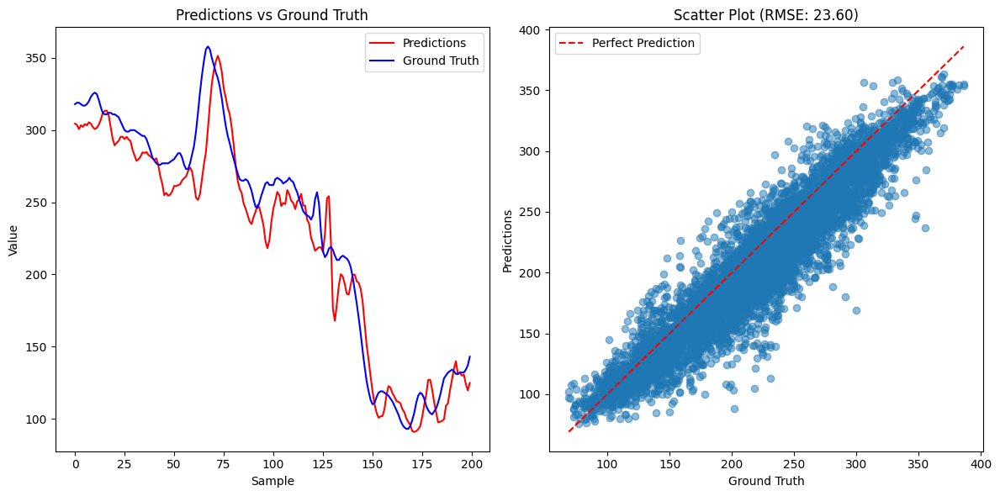

RMSE: 23.60
MAE: 18.40
MAPE: 8.69%
Test file: 252
Root Mean Square Error (RMSE): 20.31
Mean Absolute Error (MAE): 14.26
Mean Absolute Percentage Error (MAPE): 12.01%


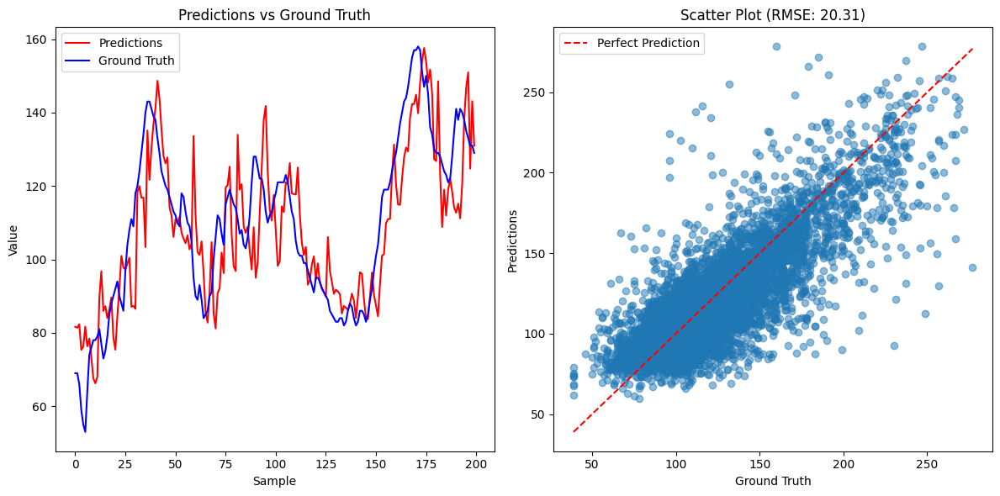

RMSE: 20.31
MAE: 14.26
MAPE: 12.01%


In [19]:
past_sequence_length = 12
future_offset = 6
batch_size = 64
max_interval_minutes = 30
sh = 'sh'+str(past_sequence_length)
model_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/'
data_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_Dataset/T1DEXI_processed/'

test_eval = []
for fold in fold_splits.keys():
  print(fold, fold_splits[fold]['test'])
  # Load the saved model
  model = load_model_population(sh+'_'+fold, past_sequence_length, save_dir=os.path.join(model_dir, 'saved_models_T1DEXI/5_fold/'))

  for test in fold_splits[fold]['test']:
    uid = test.split('.')[0]
    test_df = pd.read_csv(os.path.join(data_dir, test))
    test_df = test_df.rename(columns={"LBORRES": "mg/dl", "LBDTC": "timestamp"})
    test_df['timestamp'] = test_df['timestamp'].apply(convert_to_datetime)
    test_df = test_df.loc[:, ['timestamp', 'mg/dl']]
    # print(test_df.shape)
    # break
    metrics = evaluate_and_save_metrics_T1DEXI(
        model=model,
        test_df=test_df,
        save_dir=os.path.join(model_dir, 'evaluation_metrics_T1DEXI/5_fold_individual_'+sh+'/'),
        past_sequence_length=past_sequence_length,
        future_offset=future_offset,
        batch_size=batch_size,
        max_interval_minutes=max_interval_minutes
    )

    test_eval.append([uid, round(metrics['rmse'], 2), round(metrics['mae'], 2), round(metrics['mape'], 2)])

    # print(f"\nResults for population model:")
    print(f"RMSE: {metrics['rmse']:.2f}")
    print(f"MAE: {metrics['mae']:.2f}")
    print(f"MAPE: {metrics['mape']:.2f}%")

  # break

In [21]:
print(test_eval)
df = pd.DataFrame(test_eval, columns=['test patient', 'RMSE', 'MAE', 'MAPE'])
df.to_csv(os.path.join(model_dir, 'evaluation_metrics_T1DEXI/5_fold_test_eval_'+sh+'.csv'), index=False)

[['1', 26.82, 18.71, 12.89], ['1010', 22.4, 15.31, 14.09], ['1015', 11.85, 8.52, 6.61], ['103', 12.3, 8.87, 7.71], ['1043', 18.79, 12.85, 9.69], ['1082', 17.33, 13.07, 12.44], ['11', 17.64, 13.42, 14.54], ['1115', 22.58, 15.84, 9.93], ['1121', 24.18, 17.94, 16.14], ['1139', 20.72, 15.26, 11.59], ['114', 19.18, 14.19, 10.28], ['1127', 18.42, 13.51, 11.17], ['1143', 17.83, 13.03, 9.39], ['115', 22.84, 16.48, 11.97], ['1171', 20.81, 14.98, 12.41], ['1194', 15.03, 10.96, 8.64], ['1201', 18.0, 12.77, 10.41], ['1205', 20.83, 14.19, 10.02], ['1211', 24.76, 17.35, 11.75], ['1219', 16.81, 11.96, 9.73], ['1230', 16.52, 12.05, 10.6], ['1239', 16.18, 12.07, 10.05], ['1271', 25.51, 18.17, 12.32], ['1286', 14.33, 10.28, 8.2], ['1311', 19.33, 14.27, 12.21], ['1330', 21.08, 14.69, 11.14], ['1336', 24.87, 17.62, 13.93], ['1343', 13.84, 10.19, 9.73], ['1345', 21.38, 15.7, 12.59], ['1348', 34.82, 24.48, 13.72], ['1361', 19.02, 14.19, 13.95], ['1362', 16.85, 12.42, 11.16], ['1363', 20.84, 14.81, 10.34], [

# Train on Ohio dataset

In [ ]:
%run /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py

## Population data

In [ ]:
data_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/'
folder_path_train_2018 = os.path.join(data_dir, "./OhioT1DM 2020/2018/train")
folder_path_train_2020 = os.path.join(data_dir,"./OhioT1DM 2020/2020/train")
train_files_2018 = [f for f in os.listdir(folder_path_train_2018) if f.endswith('.xml')]
train_files_2020 = [f for f in os.listdir(folder_path_train_2020) if f.endswith('.xml')]

folder_path_test_2018 = os.path.join(data_dir,"./OhioT1DM 2020/2018/test")
folder_path_test_2020 = os.path.join(data_dir,"./OhioT1DM 2020/2020/test")
test_files_2018 = [f for f in os.listdir(folder_path_test_2018) if f.endswith('.xml')]
test_files_2020 = [f for f in os.listdir(folder_path_test_2020) if f.endswith('.xml')]

population_splits = create_population_splits(
    folder_path_train_2018,
    folder_path_train_2020,
    train_files_2018,
    train_files_2020,
    folder_path_test_2018,
    folder_path_test_2020,
    test_files_2018,
    test_files_2020
)

print(population_splits)

Test file: ['/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/559-ws-testing.xml', '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/570-ws-testing.xml', '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/591-ws-testing.xml', '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/588-ws-testing.xml', '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/563-ws-testing.xml', '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/575-ws-testing.xml', '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2020/test/584-ws-testing.xml', '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./O

In [ ]:
# Move model to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# 4. Set hyperparameters
past_sequence_length = 18
future_offset = 6
batch_size = 64
max_interval_minutes = 30

# 5. Train model
model = TransformerEncoder_version2(
    past_seq_len=past_sequence_length,
    num_layers=1,
    d_model=512,
    nhead=4,
    input_dim=1,
    dropout=0.2
)
model = model.to(device)

# Load and process training data
train_dfs = []
for train_file in population_splits['train']:
    df = load_ohio_series_train(train_file, "glucose_level", "value")
    df['timestamp'] = pd.to_datetime(df['timestamp'])
    train_dfs.append(df)

# Create datasets
train_series_list = []
for df in train_dfs:
    series_list = split_into_continuous_series(df, past_sequence_length, future_offset, max_interval_minutes)
    train_series_list.extend(series_list)

train_dataset, val_dataset = create_train_val_datasets(
    train_series_list,
    train_ratio=0.8,
    past_seq_len=past_sequence_length,
    future_offset=future_offset
)

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)

# Train model
train_losses, val_losses = train_model(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=200,
    learning_rate=1e-3
)


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch [1/200], Train Loss: 4251.906736, Val Loss: 3775.655104
Epoch [6/200], Train Loss: 2128.515584, Val Loss: 801.763658
Epoch [11/200], Train Loss: 776.098499, Val Loss: 530.048309
Epoch [16/200], Train Loss: 683.627431, Val Loss: 650.064475
Epoch [21/200], Train Loss: 707.405358, Val Loss: 519.063970
Epoch [26/200], Train Loss: 654.036532, Val Loss: 586.635767
Epoch [31/200], Train Loss: 622.018511, Val Loss: 799.483186
Epoch [36/200], Train Loss: 608.199060, Val Loss: 619.717543
Epoch [41/200], Train Loss: 584.768893, Val Loss: 485.970252
Epoch [46/200], Train Loss: 636.950408, Val Loss: 490.727400
Epoch [51/200], Train Loss: 629.190982, Val Loss: 506.679714
Epoch [56/200], Train Loss: 527.082056, Val Loss: 508.147576
Epoch [61/200], Train Loss: 534.229597, Val Loss: 483.033370
Epoch [66/200], Train Loss: 497.046835, Val Loss: 496.209128
Epoch [71/200], Train Loss: 494.202732, Val Loss: 500.816168
Epoch [76/200], Train Loss: 495.578787, Val Loss: 521.056659
Epoch [81/200], Train L

Model saved to /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/saved_models_original_ohio/model_population_sh18.pth
(31743, 2)
Test file: population
Root Mean Square Error (RMSE): 34.68
Mean Absolute Error (MAE): 21.07
Mean Absolute Percentage Error (MAPE): 15.44%


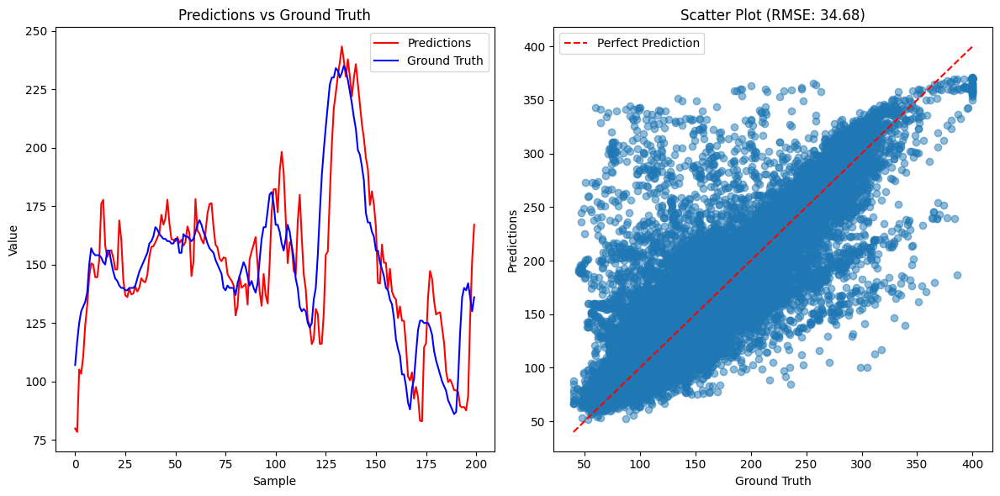

RMSE: 34.68
MAE: 21.07
MAPE: 15.44%


In [ ]:
model_dir = '/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/'
sh = 'sh'+str(past_sequence_length)

# Save the trained model
save_model(model, 'population_'+sh, save_dir=os.path.join(model_dir, 'saved_models_original_ohio/'))

/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py:762: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  mod

Model loaded from /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/saved_models_original_ohio/model_population_sh6.pth
(31743, 2)
Test file: population
Root Mean Square Error (RMSE): 31.16
Mean Absolute Error (MAE): 20.14
Mean Absolute Percentage Error (MAPE): 13.85%


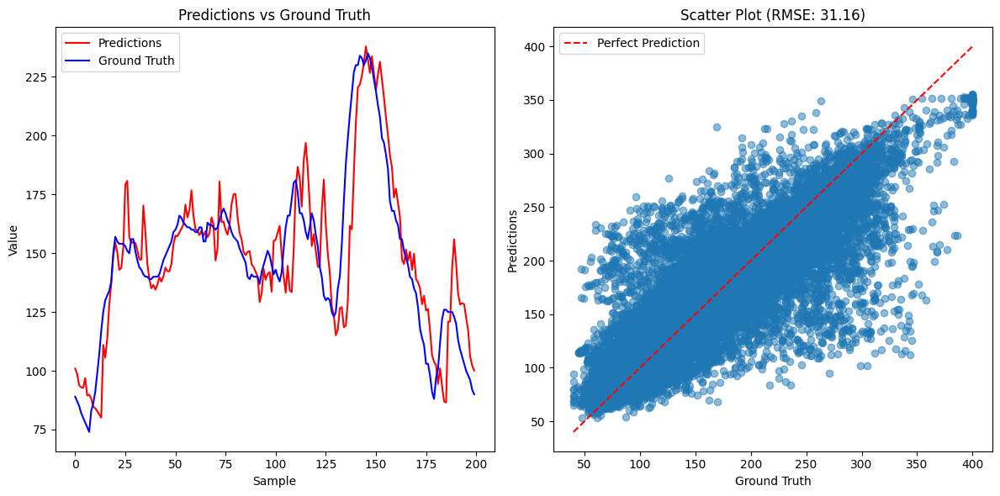

RMSE: 31.16
MAE: 20.14
MAPE: 13.85%


In [ ]:
past_sequence_length = 6
future_offset = 6
batch_size = 64
max_interval_minutes = 30

sh = 'sh'+str(past_sequence_length)
model = load_model_population('population_'+sh, past_sequence_length, save_dir=os.path.join(model_dir, 'saved_models_original_ohio'))

# Evaluate on test data
metrics = evaluate_and_save_metrics_population(
    model=model,
    test_file_path=population_splits['test'],
    save_dir=os.path.join(model_dir, 'evaluation_metrics_original_ohio'),
    past_sequence_length=past_sequence_length,
    future_offset=future_offset,
    batch_size=batch_size,
    max_interval_minutes=max_interval_minutes
)

# evaluation on whole test set
print(f"RMSE: {metrics['rmse']:.2f}")
print(f"MAE: {metrics['mae']:.2f}")
print(f"MAPE: {metrics['mape']:.2f}%")

Model loaded from /content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/saved_models_original_ohio/model_population_sh18.pth
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/559-ws-testing.xml


/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/gdrive_version/glucose_transformer.py:762: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  mod

Test file: 559-ws-testing.xml
Root Mean Square Error (RMSE): 19.67
Mean Absolute Error (MAE): 13.80
Mean Absolute Percentage Error (MAPE): 8.99%


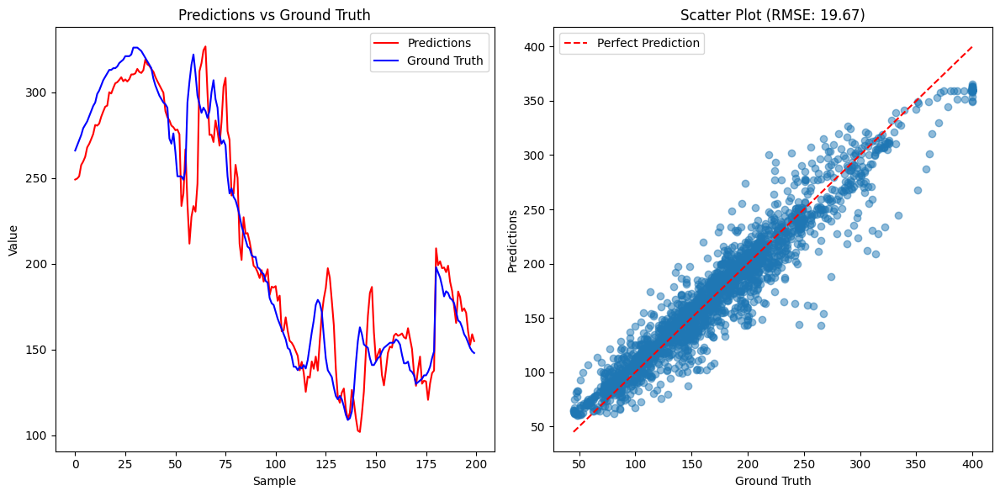

RMSE: 19.67
MAE: 13.80
MAPE: 8.99%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/570-ws-testing.xml
Test file: 570-ws-testing.xml
Root Mean Square Error (RMSE): 16.67
Mean Absolute Error (MAE): 11.84
Mean Absolute Percentage Error (MAPE): 5.97%


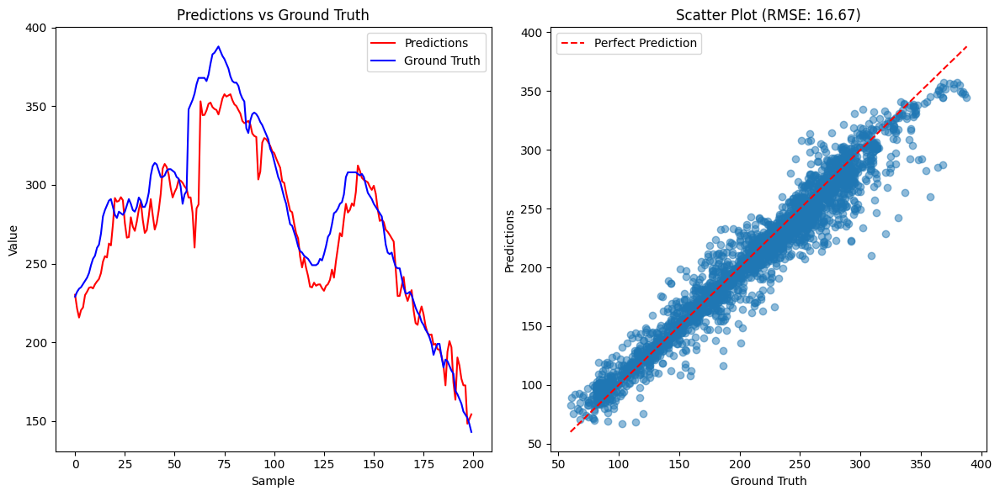

RMSE: 16.67
MAE: 11.84
MAPE: 5.97%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/591-ws-testing.xml
Test file: 591-ws-testing.xml
Root Mean Square Error (RMSE): 21.71
Mean Absolute Error (MAE): 15.75
Mean Absolute Percentage Error (MAPE): 12.21%


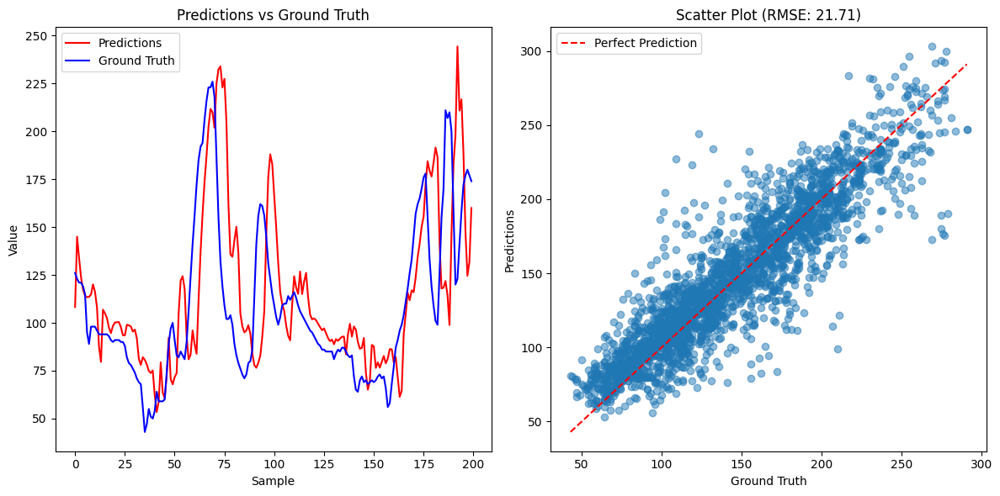

RMSE: 21.71
MAE: 15.75
MAPE: 12.21%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/588-ws-testing.xml
Test file: 588-ws-testing.xml
Root Mean Square Error (RMSE): 18.52
Mean Absolute Error (MAE): 13.47
Mean Absolute Percentage Error (MAPE): 8.14%


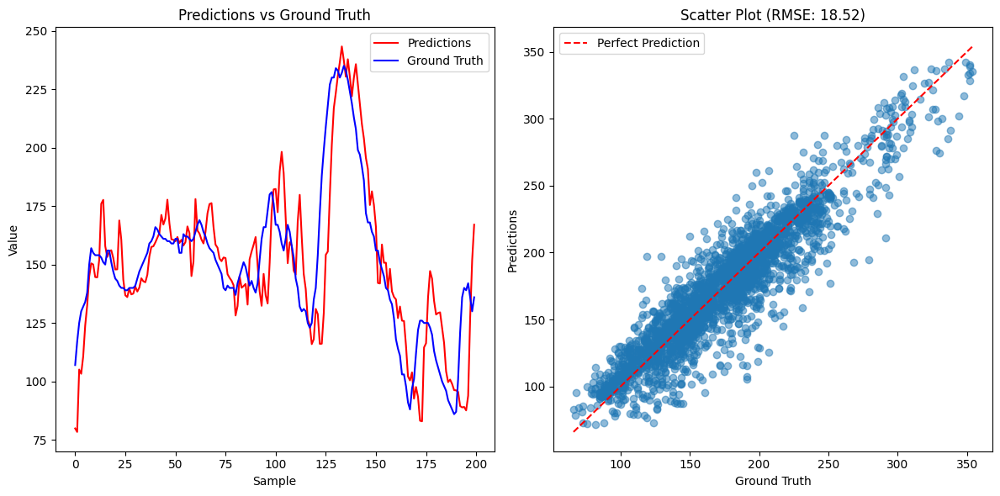

RMSE: 18.52
MAE: 13.47
MAPE: 8.14%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/563-ws-testing.xml
Test file: 563-ws-testing.xml
Root Mean Square Error (RMSE): 18.34
Mean Absolute Error (MAE): 12.91
Mean Absolute Percentage Error (MAPE): 8.20%


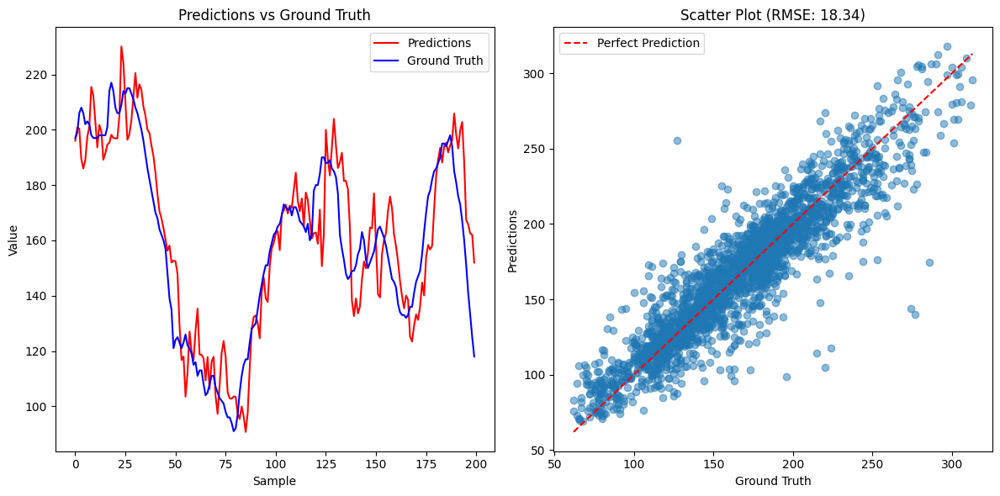

RMSE: 18.34
MAE: 12.91
MAPE: 8.20%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2018/test/575-ws-testing.xml
Test file: 575-ws-testing.xml
Root Mean Square Error (RMSE): 23.58
Mean Absolute Error (MAE): 15.43
Mean Absolute Percentage Error (MAPE): 11.48%


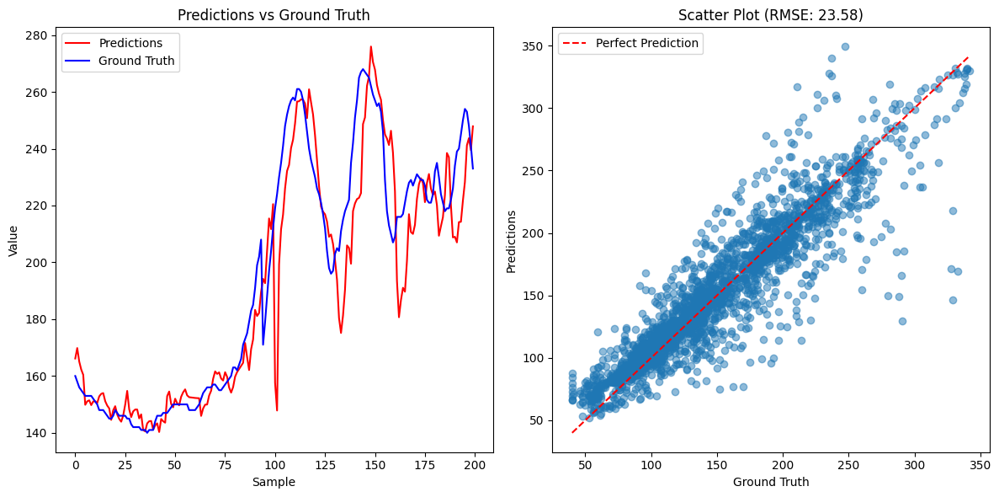

RMSE: 23.58
MAE: 15.43
MAPE: 11.48%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2020/test/584-ws-testing.xml
Test file: 584-ws-testing.xml
Root Mean Square Error (RMSE): 22.85
Mean Absolute Error (MAE): 15.76
Mean Absolute Percentage Error (MAPE): 10.08%


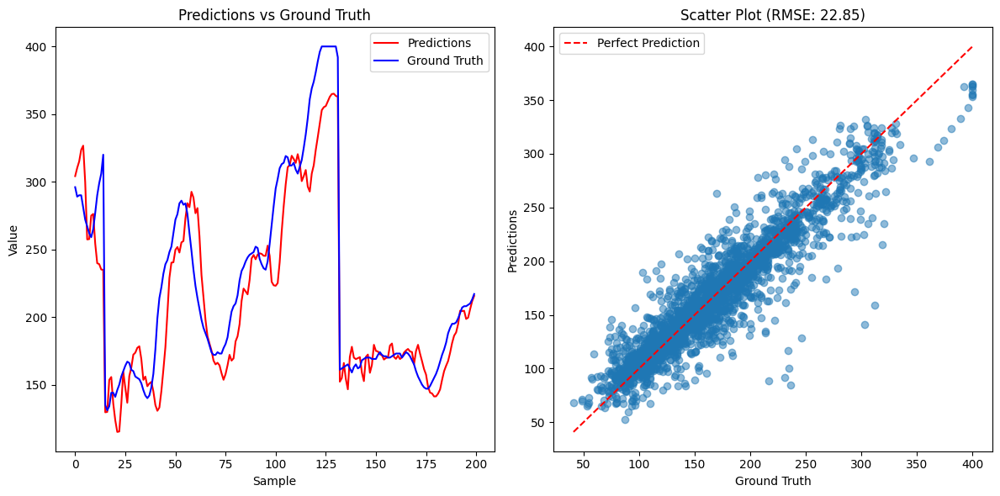

RMSE: 22.85
MAE: 15.76
MAPE: 10.08%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2020/test/540-ws-testing.xml
Test file: 540-ws-testing.xml
Root Mean Square Error (RMSE): 23.02
Mean Absolute Error (MAE): 17.27
Mean Absolute Percentage Error (MAPE): 12.28%


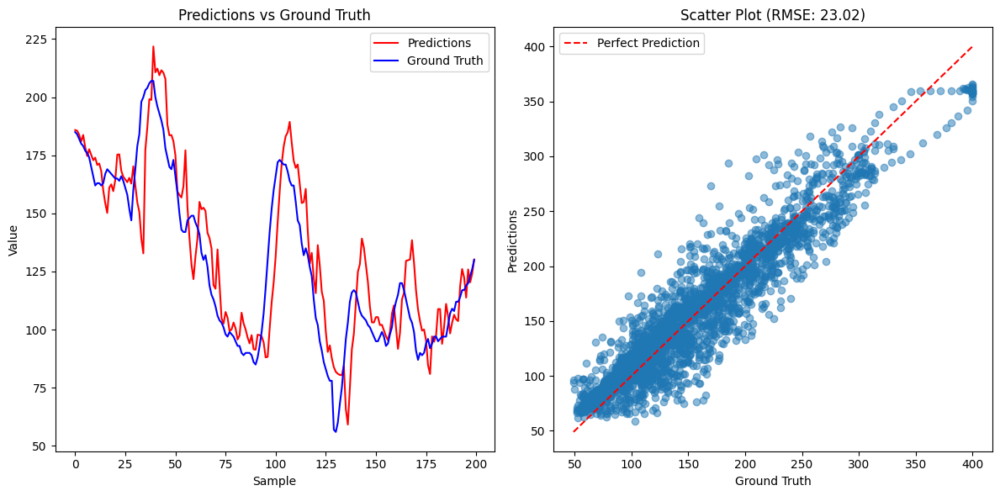

RMSE: 23.02
MAE: 17.27
MAPE: 12.28%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2020/test/544-ws-testing.xml
Test file: 544-ws-testing.xml
Root Mean Square Error (RMSE): 18.39
Mean Absolute Error (MAE): 13.24
Mean Absolute Percentage Error (MAPE): 8.98%


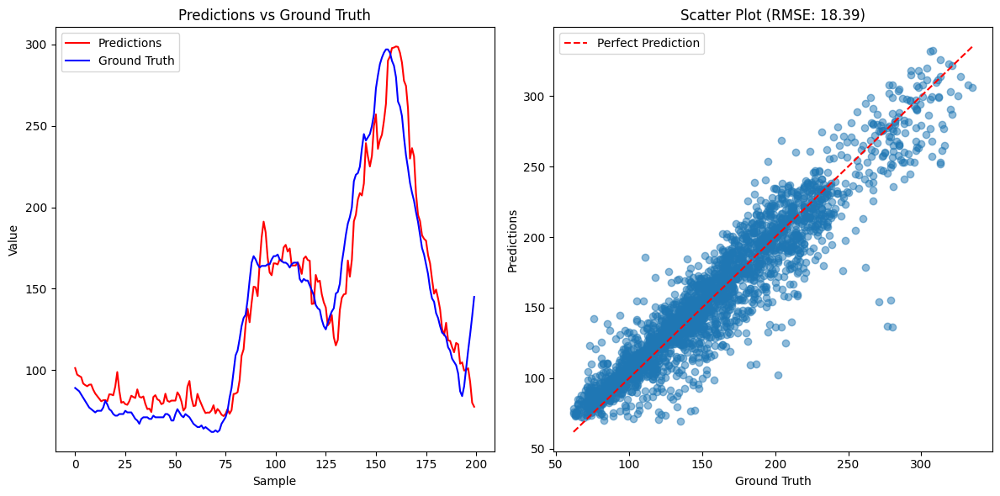

RMSE: 18.39
MAE: 13.24
MAPE: 8.98%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2020/test/567-ws-testing.xml
Test file: 567-ws-testing.xml
Root Mean Square Error (RMSE): 21.83
Mean Absolute Error (MAE): 15.50
Mean Absolute Percentage Error (MAPE): 11.39%


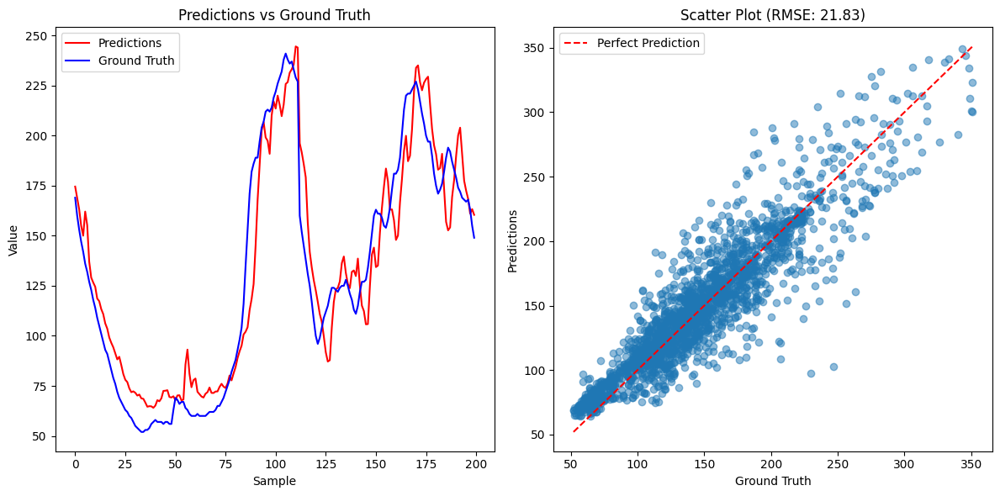

RMSE: 21.83
MAE: 15.50
MAPE: 11.39%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2020/test/596-ws-testing.xml
Test file: 596-ws-testing.xml
Root Mean Square Error (RMSE): 17.23
Mean Absolute Error (MAE): 12.46
Mean Absolute Percentage Error (MAPE): 9.27%


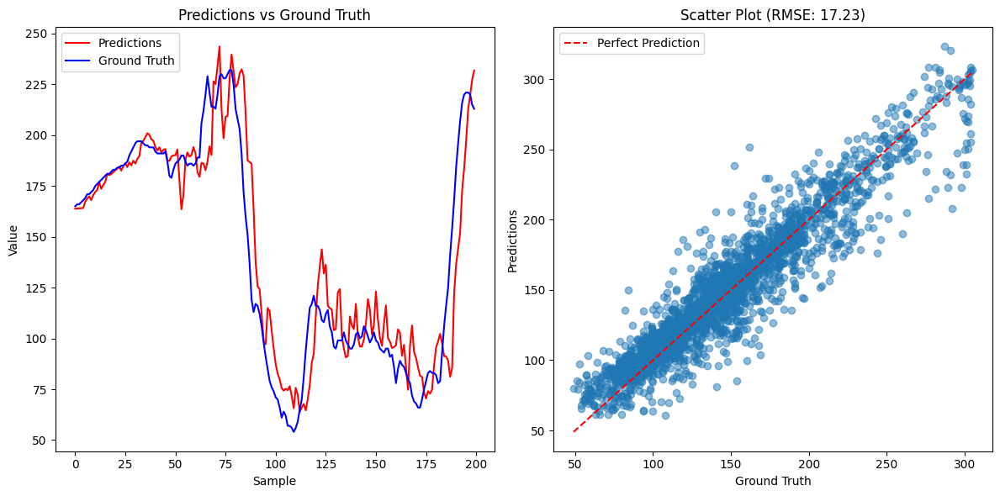

RMSE: 17.23
MAE: 12.46
MAPE: 9.27%
/content/drive/Shareddrives/Yanjun/ReproGenBG/ReproGenBG_ML4H/GlucoseTransformer/./OhioT1DM 2020/2020/test/552-ws-testing.xml
Test file: 552-ws-testing.xml
Root Mean Square Error (RMSE): 16.94
Mean Absolute Error (MAE): 12.94
Mean Absolute Percentage Error (MAPE): 10.31%


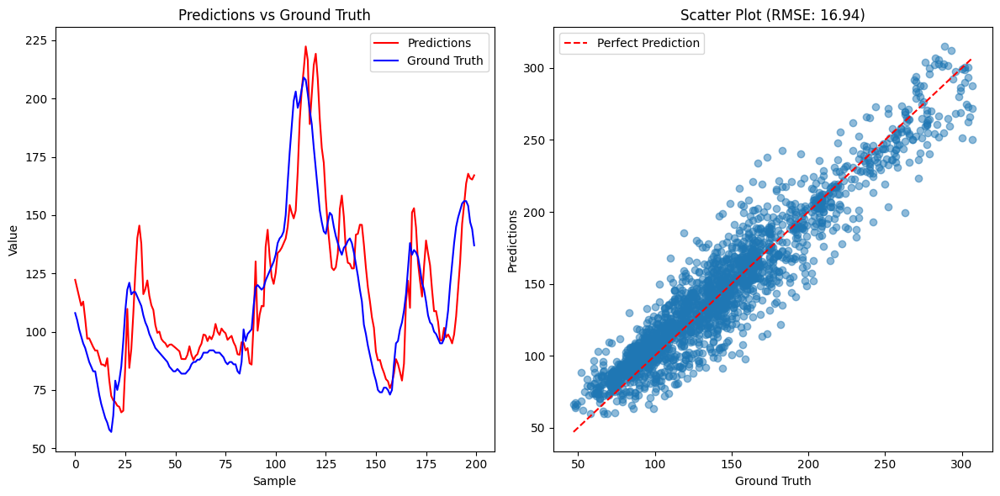

RMSE: 16.94
MAE: 12.94
MAPE: 10.31%


In [ ]:
# Load the saved model
model = load_model_population('population_'+sh, past_sequence_length, save_dir=os.path.join(model_dir, 'saved_models_original_ohio'))
test_eval = []

for test in population_splits['test']:
    print(test)
    # Evaluate on test data individually
    metrics = evaluate_and_save_metrics(
        model=model,
        test_file_path=test,
        save_dir=os.path.join(model_dir, 'evaluation_metrics_original_ohio/individual_'+sh+'/'),
        past_sequence_length=past_sequence_length,
        future_offset=future_offset,
        batch_size=batch_size,
        max_interval_minutes=max_interval_minutes
    )

    id = test.split('/')[-1].split('-')[0]
    test_eval.append([id, round(metrics['rmse'], 2), round(metrics['mae'], 2), round(metrics['mape'], 2)])

    # print(f"\nResults for population model:")
    print(f"RMSE: {metrics['rmse']:.2f}")
    print(f"MAE: {metrics['mae']:.2f}")
    print(f"MAPE: {metrics['mape']:.2f}%")

### save individual results to .csv file

In [ ]:
print(test_eval)
df = pd.DataFrame(test_eval, columns=['test patient', 'RMSE', 'MAE', 'MAPE'])
df.to_csv(os.path.join(model_dir, 'evaluation_metrics_original_ohio/individual_test_eval_'+sh+'.csv'), index=False)

[['559', 19.67, 13.8, 8.99], ['570', 16.67, 11.84, 5.97], ['591', 21.71, 15.75, 12.21], ['588', 18.52, 13.47, 8.14], ['563', 18.34, 12.91, 8.2], ['575', 23.58, 15.43, 11.48], ['584', 22.85, 15.76, 10.08], ['540', 23.02, 17.27, 12.28], ['544', 18.39, 13.24, 8.98], ['567', 21.83, 15.5, 11.39], ['596', 17.23, 12.46, 9.27], ['552', 16.94, 12.94, 10.31]]


## Leave-one-out

In [ ]:
# Example usage
# 1. Set up paths and get file lists
folder_path_train_2018 = f"./OhioT1DM 2020/2018/train"
folder_path_train_2020 = "./OhioT1DM 2020/2020/train"
train_files_2018 = [f for f in os.listdir(folder_path_train_2018) if f.endswith('.xml')]
train_files_2020 = [f for f in os.listdir(folder_path_train_2020) if f.endswith('.xml')]

# 2. Create LOOCV splits
loocv_splits = create_loocv_splits(
    folder_path_train_2018,
    folder_path_train_2020,
    train_files_2018,
    train_files_2020
)

# 3. Initialize model
# model = TransformerEncoder(
#     num_layers=3,
#     d_model=64,
#     nhead=4,
#     input_dim=1,
#     dim_feedforward=256,
#     dropout=0.1
# )

# Move model to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


# 4. Set hyperparameters
past_sequence_length = 12
future_offset = 6
batch_size = 64
max_interval_minutes = 30

# Get the items starting from fold9

fold_items = dict(list(loocv_splits.items())[1:])

# 5. Train and evaluate for each fold
for fold_name, fold_data in fold_items.items():
    model = TransformerEncoder(
        num_layers=1,
        d_model=512,
        nhead=4,
        input_dim=1,
        dim_feedforward=256,
        dropout=0.2
    )
    model = model.to(device)
    print(f"\nProcessing {fold_name}...")

    # Load and process training data
    train_dfs = []
    for train_file in fold_data['train']:
        df = load_ohio_series_train(train_file, "glucose_level", "value")
        df['timestamp'] = pd.to_datetime(df['timestamp'])
        train_dfs.append(df)

    # Create datasets
    train_series_list = []
    for df in train_dfs:
        series_list = split_into_continuous_series(df, past_sequence_length, future_offset, max_interval_minutes)
        train_series_list.extend(series_list)

    train_dataset, val_dataset = create_train_val_datasets(
        train_series_list,
        train_ratio=0.8,
        past_seq_len=past_sequence_length,
        future_offset=future_offset
    )

    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    # Train model
    train_losses, val_losses = train_model(
        model=model,
        train_loader=train_loader,
        val_loader=val_loader,
        num_epochs=200,
        learning_rate=1e-3
    )

    # Evaluate on test data
    metrics = evaluate_and_save_metrics(
        model=model,
        test_file_path=fold_data['test'],
        save_dir='evaluation_metrics',
        past_sequence_length=past_sequence_length,
        future_offset=future_offset,
        batch_size=batch_size,
        max_interval_minutes=max_interval_minutes
    )

    # Save the trained model
    save_model(model, fold_data['test'][-19:], save_dir='saved_models_original_ohio')

    print(f"\nResults for {fold_name}:")
    print(f"RMSE: {metrics['rmse']:.2f}")
    print(f"MAE: {metrics['mae']:.2f}")
    print(f"MAPE: {metrics['mape']:.2f}%")

In [ ]:
fold_data['test'][-19:]

In [ ]:
save_model(model, fold_data['test'][-19:], save_dir='saved_models_original_ohio')

print(f"\nResults for {fold_name}:")
print(f"RMSE: {metrics['rmse']:.2f}")
print(f"MAE: {metrics['mae']:.2f}")
print(f"MAPE: {metrics['mape']:.2f}%")

In [ ]:
# Check CUDA availability
print(f"CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"Current device: {torch.cuda.current_device()}")
    print(f"Device name: {torch.cuda.get_device_name()}")

In [ ]:
# Save model after training each fold
def save_model(model, fold_name, save_dir='saved_models'):
    os.makedirs(save_dir, exist_ok=True)
    model_path = os.path.join(save_dir, f'model_{fold_name}.pth')
    torch.save(model.state_dict(), model_path)
    print(f"Model saved to {model_path}")

# Load model for evaluation
def load_model(fold_name, model_class=TransformerEncoder, save_dir='saved_models'):
    model_path = os.path.join(save_dir, f'model_{fold_name}.pth')

    # Initialize a new model with the same architecture
    model = model_class(
        num_layers=3,
        d_model=64,
        nhead=4,
        input_dim=1,
        dim_feedforward=256,
        dropout=0.1
    )

    # Load the saved weights
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.load_state_dict(torch.load(model_path, map_location=device))
    model = model.to(device)
    model.eval()

    print(f"Model loaded from {model_path}")
    return model

In [ ]:
fold_name

In [ ]:
# Example usage
# 1. Set up paths and get file lists
folder_path_train_2018 = "/Users/baiyinglu/Desktop/AugmentedHealthLab/T1DEXI_Apr52024/try/OhioT1DM/2018/train"
folder_path_train_2020 = "/Users/baiyinglu/Desktop/AugmentedHealthLab/T1DEXI_Apr52024/try/OhioT1DM/2020/train"
train_files_2018 = [f for f in os.listdir(folder_path_train_2018) if f.endswith('.xml')]
train_files_2020 = [f for f in os.listdir(folder_path_train_2020) if f.endswith('.xml')]

# 2. Create LOOCV splits
loocv_splits = create_loocv_splits(
    folder_path_train_2018,
    folder_path_train_2020,
    train_files_2018,
    train_files_2020
)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# model = model.to(device)

# 4. Set hyperparameters
past_sequence_length = 7
future_offset = 6
batch_size = 32
max_interval_minutes = 30

# Get the items starting from fold9
starting_fold = 9

In [ ]:
# For a specific fold
fold_name = 'fold9'
fold_data = loocv_splits[fold_name]

# Load the saved model
model = load_model(fold_name)

metrics = evaluate_and_save_metrics(
    model=model,
    test_file_path=fold_data['test'],
    save_dir='evaluation_metrics',
    past_sequence_length=past_sequence_length,
    future_offset=future_offset,
    batch_size=batch_size,
    max_interval_minutes=max_interval_minutes
)

print(f"\nResults for {fold_name}:")
print(f"RMSE: {metrics['rmse']:.2f}")
print(f"MAE: {metrics['mae']:.2f}")
print(f"MAPE: {metrics['mape']:.2f}%")